# 事前準備

In [43]:
# %pip install arviz
# %conda install multiprocessing
# %pip install openpyxl
# %pip install statsmodels
%pip install seaborn

  Using cached seaborn-0.13.2-py3-none-any.whl.metadata (5.4 kB)
Using cached seaborn-0.13.2-py3-none-any.whl (294 kB)
Note: you may need to restart the kernel to use updated packages.


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cmdstanpy as stan
from cmdstanpy import CmdStanModel
import arviz as az  # WAIC/LOO などの計算用ライブラリ
import multiprocessing
from scipy.stats import norm
from scipy.stats import mstats
import statistics
import statsmodels.api as sm
import seaborn as sns


/opt/miniconda3/envs/cmdstanpy_env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
raw_data = pd.read_csv("./data/data_questionnaire.csv")

/var/folders/l3/m4gqq46s65j7ryscv8skvykw0000gn/T/ipykernel_1413/3818647635.py:1: DtypeWarning: Columns (183,274) have mixed types. Specify dtype option on import or set low_memory=False.
  raw_data = pd.read_csv("./data/data_questionnaire.csv")


# 単回帰分析のシミュレーション

## データ作成部

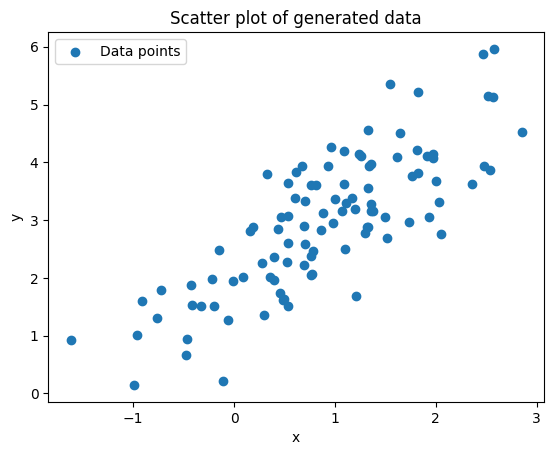

In [3]:
# データ生成部
np.random.seed(42)  # 再現性のためのランダムシード

# パラメータ
x_mu = 1
x_sigma = 1

a_mu = 2.0  # 仮の切片の平均値
a_sigma = 0.5  # 仮の切片の平均値
b_mu = 1.0  # 仮の傾きの平均値
b_sigma = 0.1  # 仮の切片の平均値

noise = 0.5

# データ生成
n_samples = 100
x = np.random.normal(x_mu, x_sigma, n_samples)
r_values = np.random.normal(b_mu, b_sigma, n_samples)
y = + np.random.normal(a_mu, a_sigma,n_samples) + r_values * x + np.random.normal(0, noise, n_samples)

# DataFrame に整理
data = pd.DataFrame({'x': x, 'y': y, 'r': r_values})

# データの可視化
plt.scatter(x, y, label="Data points")
plt.xlabel("x")
plt.ylabel("y")
plt.title("Scatter plot of generated data")
plt.legend()
plt.show()

## モデル作成部

In [4]:
# stan モデリング部 (線形回帰モデルの例)
stan_code = """
data {
    int<lower=0> N;
    vector[N] x;
    vector[N] y;
}
parameters {
    real a;  // 切片
    real b;  // 傾き
    real<lower=0> sigma;  // ノイズ
}
model {
    y ~ normal(a + b * x, sigma);
}
generated quantities {
    vector[N] log_lik;      // 対数尤度
    vector[N] y_pred;       // 事後予測値
    vector[N] mu;           // 回帰式の予測値

    for (n in 1:N) {
        mu[n] = a + b * x[n];
        log_lik[n] = normal_lpdf(y[n] | mu[n], sigma);  // 各データ点の対数尤度
        y_pred[n] = normal_rng(mu[n], sigma);          // 事後予測値を乱数生成
    }
}
"""

# Stanモデルの保存
with open("linear_regression.stan", "w") as f:
    f.write(stan_code)

## モデル実行部

In [5]:
# Stanモデルのコンパイル
stan_model = stan.CmdStanModel(stan_file="linear_regression.stan")

13:32:44 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/linear_regression.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/linear_regression
13:32:53 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/linear_regression


In [6]:
# データ整形部
data = {
    "N": len(x),           # データの長さを指定
    "x": x,                # 入力データ
    "y": y                 # 観測データ
}

In [7]:
num_cpu = multiprocessing.cpu_count()

# モデルのフィッティング
fit = stan_model.sample(
    data=data,
    chains=4,
    seed=1,
    iter_warmup=500,
    iter_sampling=2000,
    parallel_chains=num_cpu, # 並列数,
    save_warmup=False,
    thin=1,
    output_dir="./output/",
    show_progress=True
    # show_console=True  # コンソール出力を表示
)

13:32:53 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
13:32:54 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status


chain 1 |▎         | 00:00 Status


chain 1 |███████▍  | 00:00 Iteration: 1700 / 2500 [ 68%]  (Sampling)


chain 1 |██████████| 00:00 Sampling completed                       
chain 2 |██████████| 00:00 Sampling completed                       
chain 3 |██████████| 00:00 Sampling completed                       
chain 4 |██████████| 00:00 Sampling completed                       


13:32:54 - cmdstanpy - INFO - CmdStan done processing.


## 結果確認部

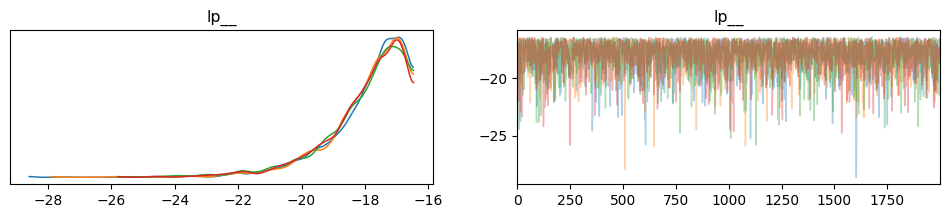

In [8]:
# 結果が収束しているかどうかの確認をしている。

cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    log_likelihood="lp__",
)
ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False);


/opt/miniconda3/envs/cmdstanpy_env/lib/python3.10/site-packages/arviz/plots/plot_utils.py:142: UserWarning: The number of rows times columns is larger than necessary
  warnings.warn("The number of rows times columns is larger than necessary")


array([[<Axes: title={'center': 'a\n0'}>,
        <Axes: title={'center': 'a\n1'}>,
        <Axes: title={'center': 'a\n2'}>,
        <Axes: title={'center': 'a\n3'}>],
       [<Axes: title={'center': 'b\n0'}>,
        <Axes: title={'center': 'b\n1'}>,
        <Axes: title={'center': 'b\n2'}>,
        <Axes: title={'center': 'b\n3'}>],
       [<Axes: title={'center': 'sigma\n0'}>,
        <Axes: title={'center': 'sigma\n1'}>,
        <Axes: title={'center': 'sigma\n2'}>,
        <Axes: title={'center': 'sigma\n3'}>],
       [<Axes: >, <Axes: >, <Axes: >, <Axes: >]], dtype=object)

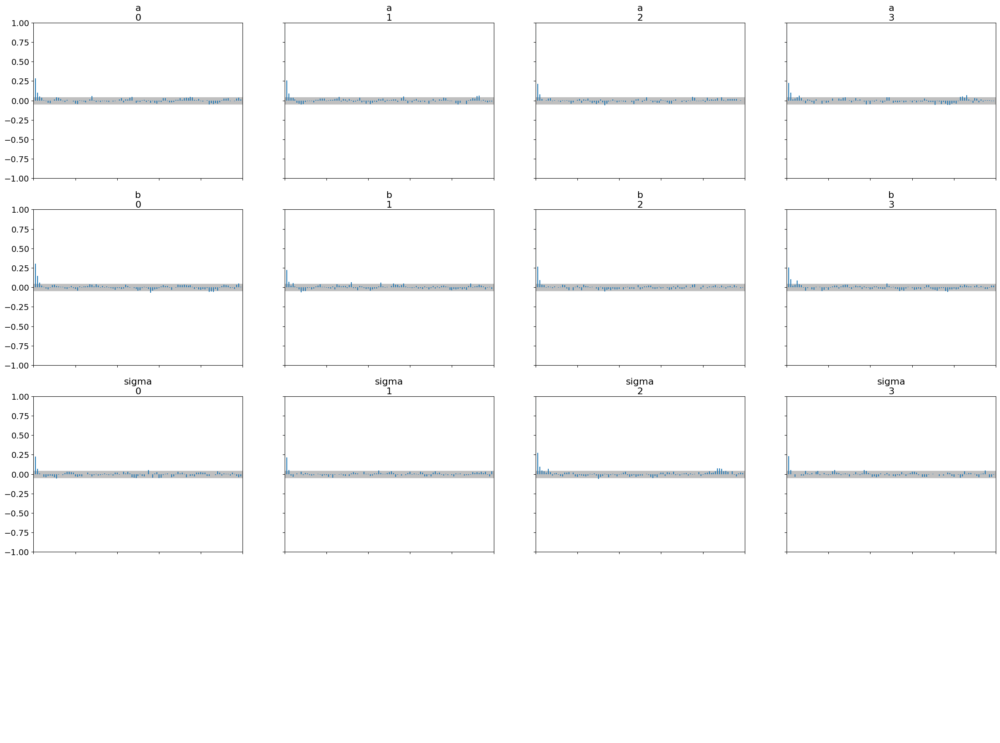

In [9]:
# 定数宣言
ls_varname = [ "a", "b", "sigma"]

# 自己相関を確認？これがみられる場合は、thinを調整する必要がある。
az.plot_autocorr(cmdstanpy_data, grid=(4, 4), var_names=ls_varname)

array([<Axes: title={'center': 'a'}>, <Axes: title={'center': 'b'}>,
       <Axes: title={'center': 'sigma'}>], dtype=object)

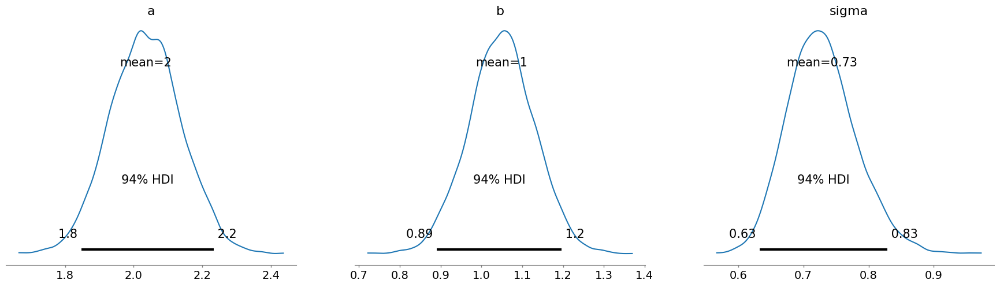

In [10]:
# 大体どのあたりに、meanがあるかの確認。
az.plot_posterior(cmdstanpy_data, var_names=ls_varname)

array([[<Axes: title={'center': 'a'}>, <Axes: title={'center': 'a'}>],
       [<Axes: title={'center': 'b'}>, <Axes: title={'center': 'b'}>],
       [<Axes: title={'center': 'sigma'}>,
        <Axes: title={'center': 'sigma'}>]], dtype=object)

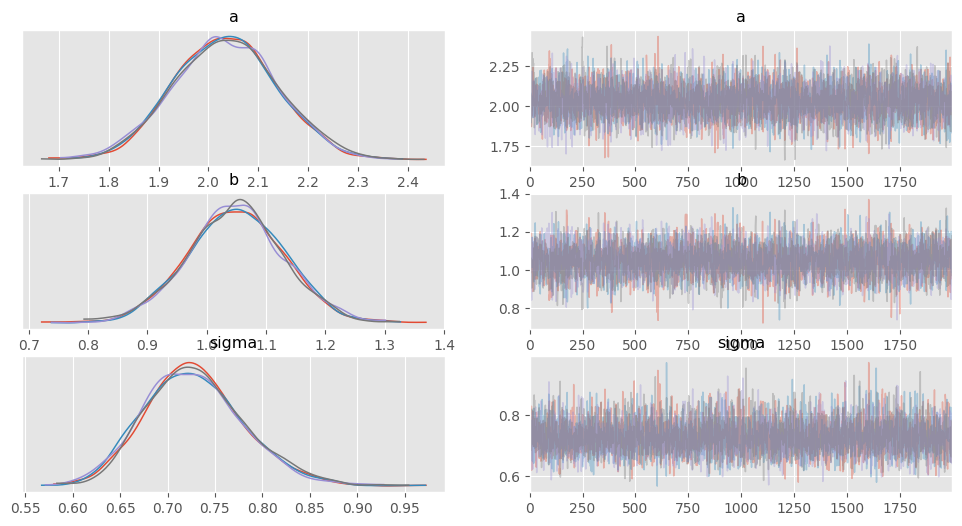

In [ ]:
# 各係数の収束を確認
az.plot_trace(cmdstanpy_data, compact=False, var_names=ls_varname)

array([[<Axes: ylabel='b'>, <Axes: >],
       [<Axes: xlabel='a', ylabel='sigma'>, <Axes: xlabel='b'>]],
      dtype=object)

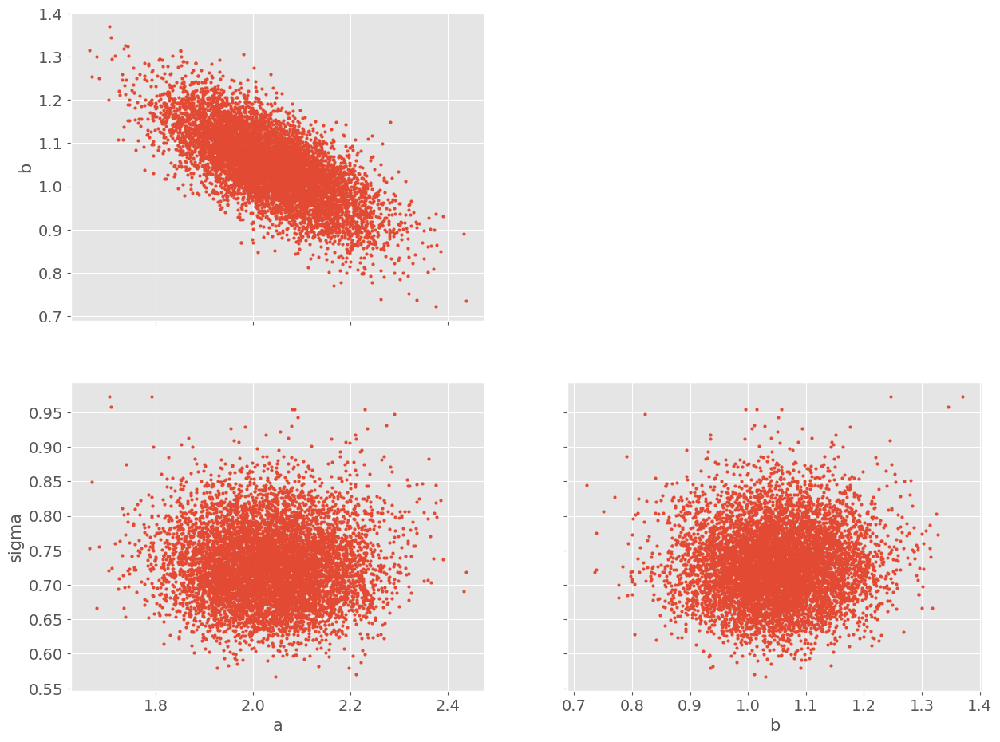

In [ ]:
az.plot_pair(
    cmdstanpy_data,
    divergences=True,
    var_names=ls_varname
)

### モデル収束性 ###
               R_hat     N_Eff
lp__        1.000250   3260.89
a           1.000270   4361.70
b           1.000540   4158.00
sigma       1.000810   4896.03
log_lik[1]  1.000100   8170.17
...              ...       ...
mu[96]      1.000390   4006.83
mu[97]      0.999953  10205.70
mu[98]      0.999940  10321.10
mu[99]      0.999884   9682.30
mu[100]     0.999917   7569.48

[304 rows x 2 columns]
R-hatはすべて1.01未満です。モデルは収束しています。
有効サンプルサイズ(N_Eff)は十分です。


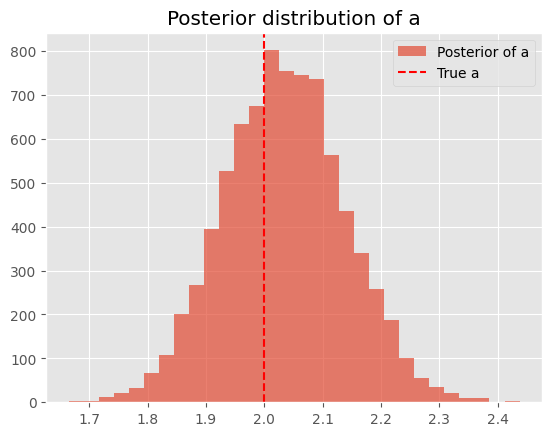

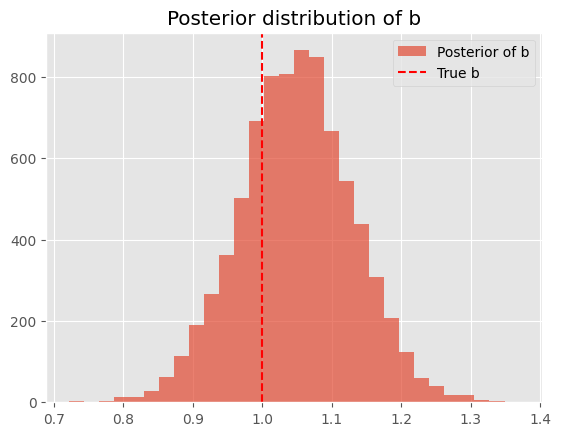

In [ ]:
# モデルの事後分布出力から評価指標を確認するためのコード

# Stan モデルの出力結果
fit_summary = fit.summary()
posterior_samples = fit.draws_pd()

# --- 1. モデル収束性の確認 ---
print("### モデル収束性 ###")
print(fit_summary[["R_hat", "N_Eff"]])

# R-hatと有効サンプルサイズを確認
if all(fit_summary["R_hat"] < 1.01):
    print("R-hatはすべて1.01未満です。モデルは収束しています。")
else:
    print("R-hatが1.01を超えているパラメータがあります。モデルの収束に問題があります。")

if all(fit_summary["N_Eff"] > 100):
    print("有効サンプルサイズ(N_Eff)は十分です。")
else:
    print("n_effが小さいパラメータがあります。サンプル数を増やすことを検討してください。")

# --- 2. 事後分布の形状と真の値 ---
a_samples = posterior_samples["a"]
b_samples = posterior_samples["b"]

# a の分布
plt.hist(a_samples, bins=30, alpha=0.7, label="Posterior of a")
plt.axvline(a_mu, color="red", linestyle="--", label="True a")
plt.legend()
plt.title("Posterior distribution of a")
plt.show()

# b の分布
plt.hist(b_samples, bins=30, alpha=0.7, label="Posterior of b")
plt.axvline(b_mu, color="red", linestyle="--", label="True b")
plt.legend()
plt.title("Posterior distribution of b")
plt.show()

In [ ]:
df_summary = fit.summary()
df_summary = df_summary.loc[df_summary.index.str.contains("y_pred"), :]
df_summary["y_act"] = data["y"].copy()

In [ ]:
def plot_yy(y_act, y_pred, err_lower, err_upper):
    min_value = min(y_act) - np.abs(min(y_act)*0.3)
    max_value = max(y_act) + np.abs(max(y_act)*0.3)
    
    plt.figure(figsize=(5, 5))
    plt.plot([min_value, max_value], [min_value, max_value], c="lightgray")
    plt.scatter(y_act, y_pred)
    plt.errorbar(y_act, y_pred, yerr=[err_lower, err_upper], fmt="o")
    plt.xlim([min_value, max_value])
    plt.ylim([min_value, max_value])
    plt.xlabel("y_actual")
    plt.ylabel("y_pred")
    plt.show()

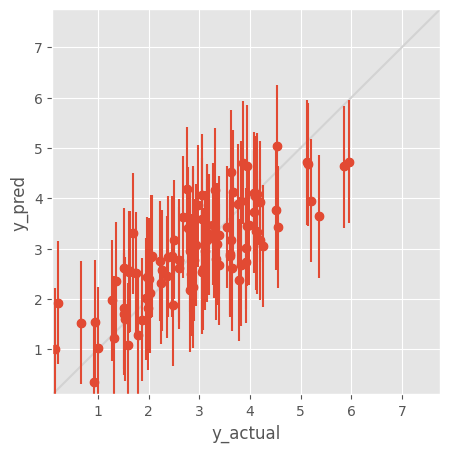

In [ ]:
plot_yy(y_act=df_summary["y_act"], y_pred=df_summary["Mean"], err_lower=df_summary["Mean"]-df_summary["5%"], err_upper=-df_summary["Mean"]+df_summary["95%"])

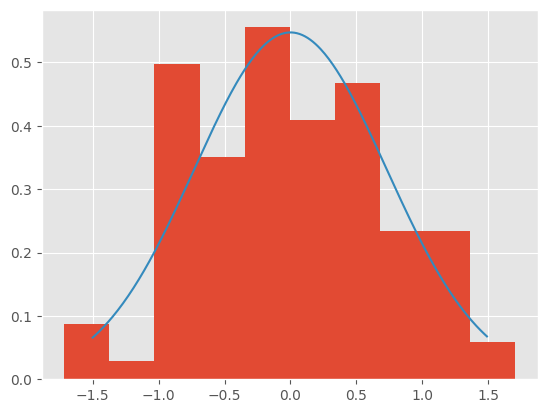

In [ ]:
df_summary = fit.summary()
df_summary = df_summary.loc[df_summary.index.str.contains("mu"), :]

array_epsilon = data["y"] - df_summary["50%"].values

plt.hist(array_epsilon, density=True)
x_axis = np.arange(-1.5, 1.5, 0.01) # rangeは要調整
plt.plot(x_axis, norm.pdf(x_axis, 0, fit.summary().loc["sigma", "Mean"]))

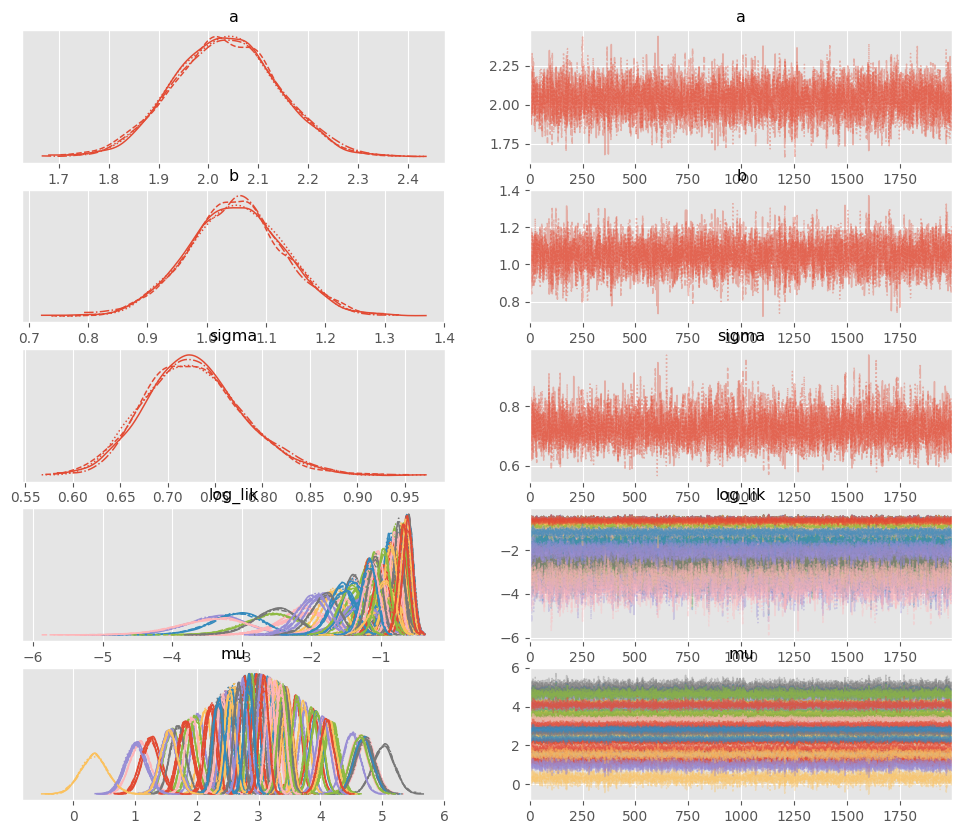

array([[<Axes: title={'center': 'lp__'}>,
        <Axes: title={'center': 'lp__'}>]], dtype=object)

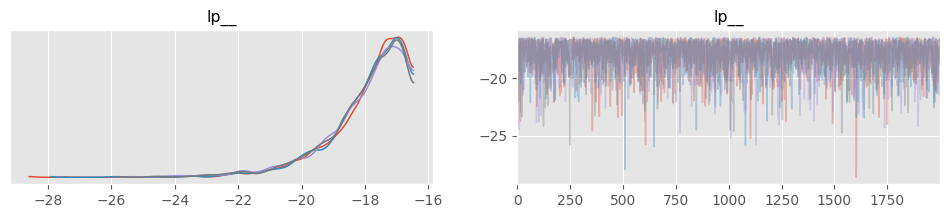

In [ ]:
# 上記のa, b, sigmaの係数に影響？
cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    posterior_predictive="y_pred",
    log_likelihood="lp__",
    observed_data = {"y":data["y"]}
)

# トレースプロットの作成
az.plot_trace(cmdstanpy_data)
plt.show()

# cmdstanpy_data
ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False)
plt.show()

/opt/miniconda3/envs/cmdstanpy_env/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


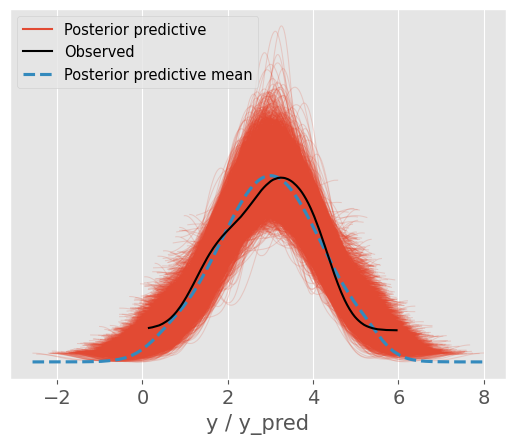

In [ ]:
# 事後予測チェック
az.plot_ppc(cmdstanpy_data,data_pairs={"y":"y_pred"})
plt.show()

In [ ]:
# WAICとLOOの計算
print("WAIC:", az.waic(cmdstanpy_data))
print("LOO:", az.loo(cmdstanpy_data))

WAIC: Computed from 8000 posterior samples and 1.0 observations log-likelihood matrix.

          Estimate       SE
elpd_waic   -19.17     0.00
p_waic        1.67        -

There has been a warning during the calculation. Please check the results.
LOO: Computed from 8000 posterior samples and 1.0 observations log-likelihood matrix.

         Estimate       SE
elpd_loo   -20.62     0.00
p_loo        3.12        -

There has been a warning during the calculation. Please check the results.
------

Pareto k diagnostic values:
                         Count   Pct.
(-Inf, 0.70]   (good)        0    0.0%
   (0.70, 1]   (bad)         0    0.0%
   (1, Inf)   (very bad)    1  100.0%



/opt/miniconda3/envs/cmdstanpy_env/lib/python3.10/site-packages/arviz/stats/stats.py:1653: UserWarning: For one or more samples the posterior variance of the log predictive densities exceeds 0.4. This could be indication of WAIC starting to fail. 
See http://arxiv.org/abs/1507.04544 for details
  warnings.warn(
/opt/miniconda3/envs/cmdstanpy_env/lib/python3.10/site-packages/arviz/stats/stats.py:1681: UserWarning: The point-wise WAIC is the same with the sum WAIC, please double check
            the Observed RV in your model to make sure it returns element-wise logp.
            
  warnings.warn(
/opt/miniconda3/envs/cmdstanpy_env/lib/python3.10/site-packages/arviz/stats/stats.py:795: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.70 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to h

# 重回帰のシミュレーション

## データ作成部

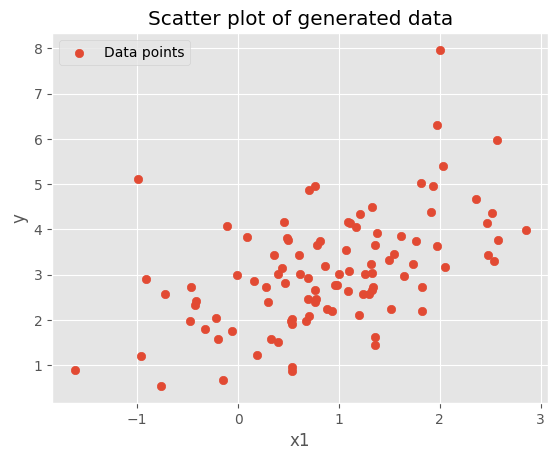

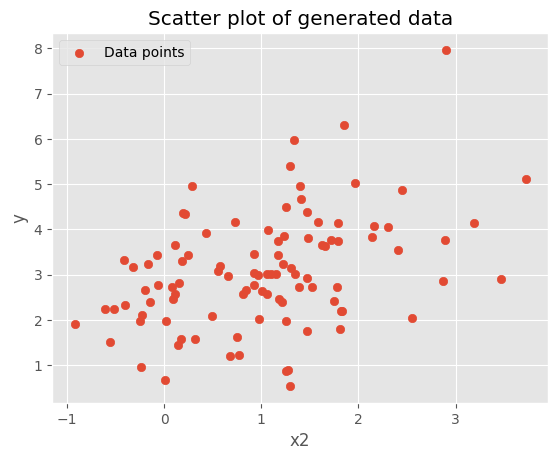

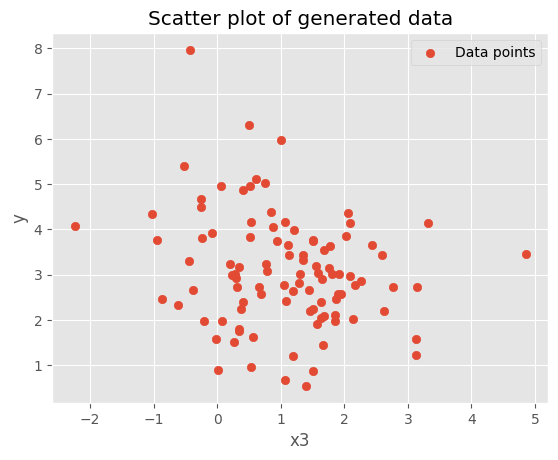

In [ ]:
# データ生成部
np.random.seed(42)  # 再現性のためのランダムシード

# パラメータ
x_mu = 1
x_sigma = 1

a_mu = 2.0  # 仮の切片の平均値
a_sigma = 0.5  # 仮の切片の平均値
b_mu = 1.0  # 仮の傾きの平均値
b_sigma = 0.1  # 仮の切片の平均値
c_mu = 0.5  # 仮の傾きの平均値
c_sigma = 0.3  # 仮の切片の平均値
d_mu = -0.3  # 仮の傾きの平均値
d_sigma = 0.2  # 仮の切片の平均値


noise = 0.5

# データ生成
n_samples = 100
x1 = np.random.normal(x_mu, x_sigma, n_samples)
x2 = np.random.normal(x_mu, x_sigma, n_samples)
x3 = np.random.normal(x_mu, x_sigma, n_samples)

b_values = np.random.normal(b_mu, b_sigma, n_samples)
c_values = np.random.normal(c_mu, c_sigma, n_samples)
d_values = np.random.normal(d_mu, d_sigma, n_samples)

y = + np.random.normal(a_mu, a_sigma,n_samples) + b_values * x1+ c_values * x2+ d_values * x3 + np.random.normal(0, noise, n_samples)

# DataFrame に整理
data = pd.DataFrame({'x1': x1,'x2': x2,'x3': x3, 'y': y})

# データの可視化
plt.scatter(x1, y, label="Data points")
plt.xlabel("x1")
plt.ylabel("y")
plt.title("Scatter plot of generated data")
plt.legend()
plt.show()

# データの可視化
plt.scatter(x2, y, label="Data points")
plt.xlabel("x2")
plt.ylabel("y")
plt.title("Scatter plot of generated data")
plt.legend()
plt.show()

# データの可視化
plt.scatter(x3, y, label="Data points")
plt.xlabel("x3")
plt.ylabel("y")
plt.title("Scatter plot of generated data")
plt.legend()
plt.show()

## モデル作成部

In [ ]:
# stan モデリング部 (線形回帰モデルの例)
stan_code = """
data {
    int N;          // サンプル数
    vector[N] x1;            // 説明変数1
    vector[N] x2;            // 説明変数2
    vector[N] x3;            // 説明変数3
    vector[N] y;             // 目的変数
}

parameters {
    real a;                  // 切片
    real b;                  // x1の回帰係数
    real c;                  // x2の回帰係数
    real d;                  // x3の回帰係数
    real sigma;     // ノイズの標準偏差
}

model {
    y ~ normal(a + b * x1 + c * x2 + d * x3, sigma); // 回帰モデル
}

generated quantities {
    vector[N] log_lik;       // 各データ点の対数尤度
    vector[N] y_pred;        // 事後予測値
    vector[N] mu;            // 回帰式の予測値

    for (n in 1:N) {
        mu[n] = a + b * x1[n] + c * x2[n] + d * x3[n];
        log_lik[n] = normal_lpdf(y[n] | mu[n], sigma);  // 対数尤度
        y_pred[n] = normal_rng(mu[n], sigma);          // 事後予測値
    }
}
"""

stan_model_path = "./model/multi_linear_regression.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_code)

## モデル実行部

In [ ]:
# Stanモデルのコンパイル
stan_model = stan.CmdStanModel(stan_file=stan_model_path)

10:32:17 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/multi_linear_regression.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/multi_linear_regression
10:32:27 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/multi_linear_regression


In [ ]:
# データ整形部
data = {
    "N": len(x),           # データの長さを指定
    "x1": x1,                # 入力データ
    "x2": x2,                # 入力データ
    "x3": x3,                # 入力データ
    "y": y                 # 観測データ
}

In [ ]:
num_cpu = multiprocessing.cpu_count()

# モデルのフィッティング
fit = stan_model.sample(
    data=data,
    chains=4,
    seed=1,
    iter_warmup=500,
    iter_sampling=2000,
    parallel_chains=num_cpu, # 並列数,
    save_warmup=False,
    thin=1,
    output_dir="./output/",
    show_progress=True
    # show_console=True  # コンソール出力を表示
)

10:32:46 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
10:32:47 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status





chain 1 |████▊     | 00:00 Iteration: 1000 / 2500 [ 40%]  (Sampling)


chain 1 |██████████| 00:00 Sampling completed                       
chain 2 |██████████| 00:00 Sampling completed                       
chain 3 |██████████| 00:00 Sampling completed                       
chain 4 |██████████| 00:00 Sampling completed                       


10:32:47 - cmdstanpy - INFO - CmdStan done processing.


## 結果確認部

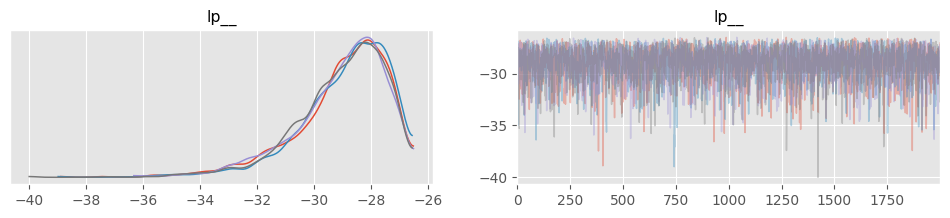

In [ ]:
# 結果が収束しているかどうかの確認をしている。

cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    log_likelihood="lp__",
)
ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False);


array([[<Axes: title={'center': 'a\n0'}>,
        <Axes: title={'center': 'a\n1'}>,
        <Axes: title={'center': 'a\n2'}>,
        <Axes: title={'center': 'a\n3'}>],
       [<Axes: title={'center': 'b\n0'}>,
        <Axes: title={'center': 'b\n1'}>,
        <Axes: title={'center': 'b\n2'}>,
        <Axes: title={'center': 'b\n3'}>],
       [<Axes: title={'center': 'c\n0'}>,
        <Axes: title={'center': 'c\n1'}>,
        <Axes: title={'center': 'c\n2'}>,
        <Axes: title={'center': 'c\n3'}>],
       [<Axes: title={'center': 'd\n0'}>,
        <Axes: title={'center': 'd\n1'}>,
        <Axes: title={'center': 'd\n2'}>,
        <Axes: title={'center': 'd\n3'}>],
       [<Axes: title={'center': 'sigma\n0'}>,
        <Axes: title={'center': 'sigma\n1'}>,
        <Axes: title={'center': 'sigma\n2'}>,
        <Axes: title={'center': 'sigma\n3'}>]], dtype=object)

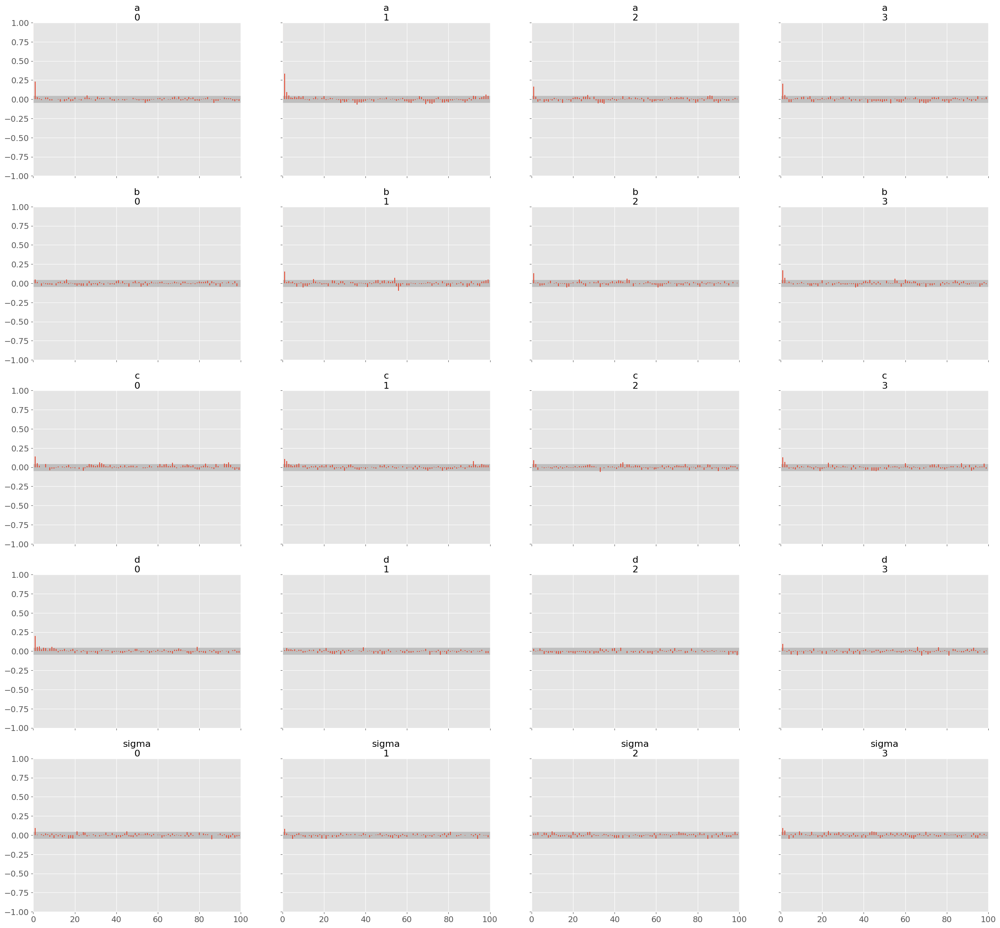

In [ ]:
# 定数宣言
ls_varname = [ "a", "b","c","d", "sigma"]

# 自己相関を確認？これがみられる場合は、thinを調整する必要がある。
az.plot_autocorr(cmdstanpy_data, var_names=ls_varname)

array([[<Axes: title={'center': 'a'}>, <Axes: title={'center': 'b'}>,
        <Axes: title={'center': 'c'}>],
       [<Axes: title={'center': 'd'}>, <Axes: title={'center': 'sigma'}>,
        <Axes: >]], dtype=object)

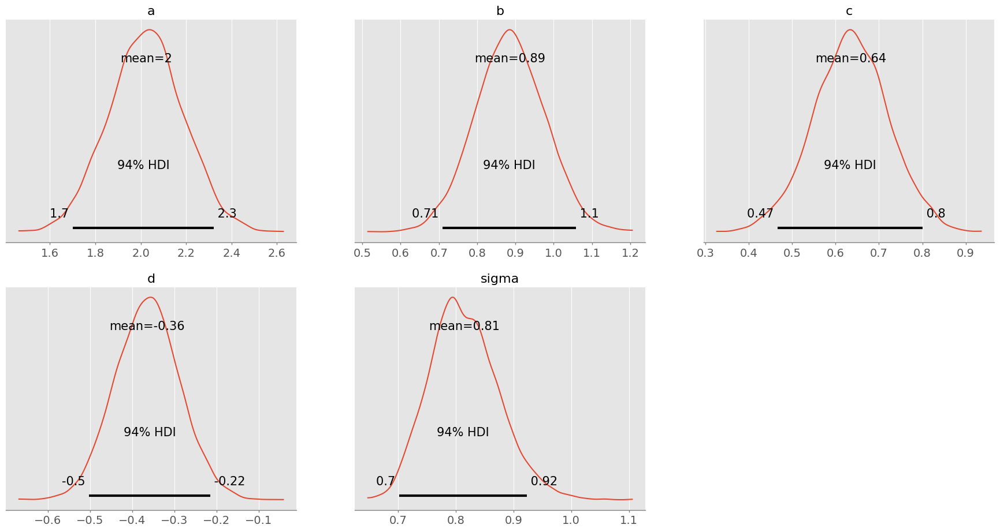

In [ ]:
# 大体どのあたりに、meanがあるかの確認。
az.plot_posterior(cmdstanpy_data, var_names=ls_varname)

array([[<Axes: title={'center': 'a'}>, <Axes: title={'center': 'a'}>],
       [<Axes: title={'center': 'b'}>, <Axes: title={'center': 'b'}>],
       [<Axes: title={'center': 'c'}>, <Axes: title={'center': 'c'}>],
       [<Axes: title={'center': 'd'}>, <Axes: title={'center': 'd'}>],
       [<Axes: title={'center': 'sigma'}>,
        <Axes: title={'center': 'sigma'}>]], dtype=object)

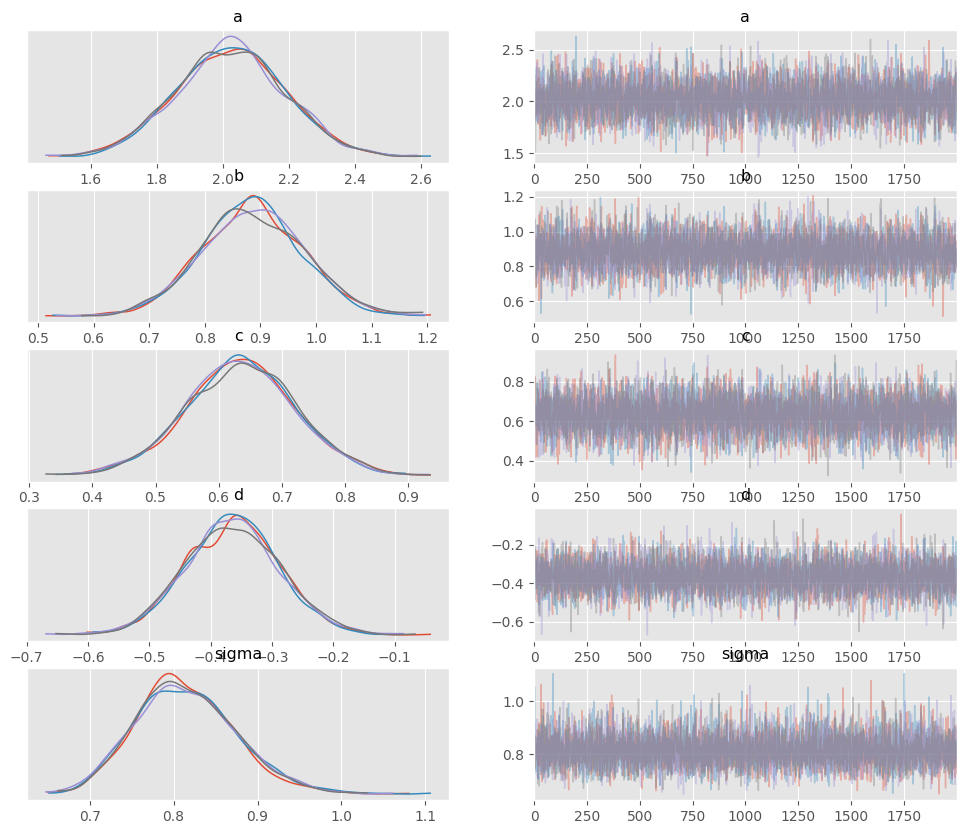

In [ ]:
# 各係数の収束を確認
az.plot_trace(cmdstanpy_data, compact=False, var_names=ls_varname)

array([[<Axes: ylabel='b'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='c'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='d'>, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='a', ylabel='sigma'>, <Axes: xlabel='b'>,
        <Axes: xlabel='c'>, <Axes: xlabel='d'>]], dtype=object)

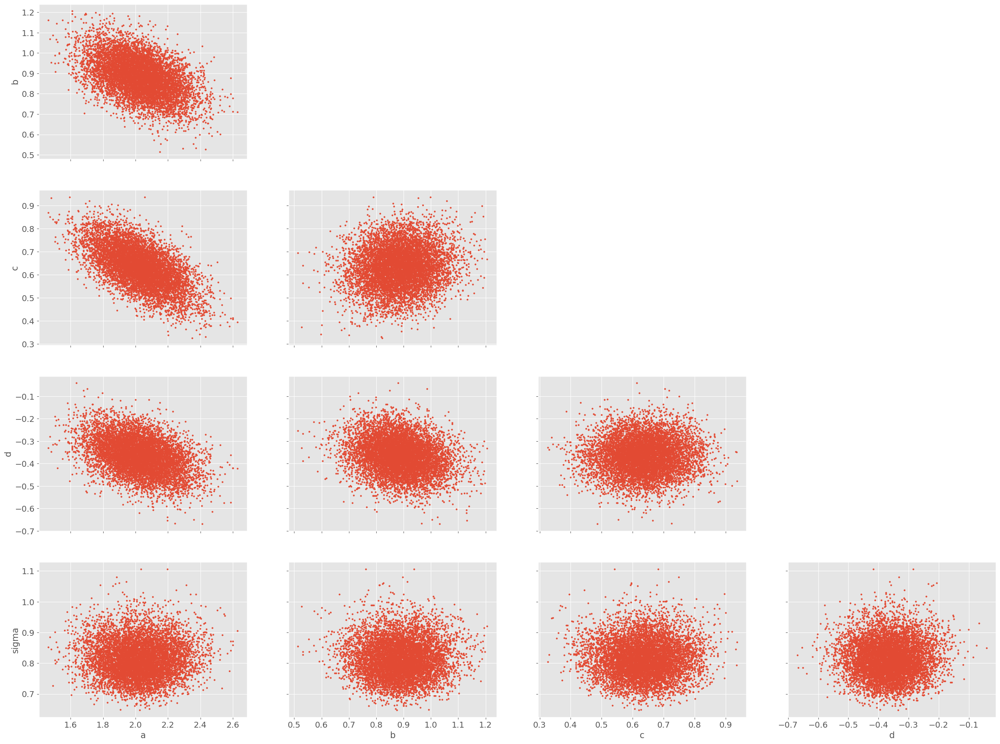

In [ ]:
az.plot_pair(
    cmdstanpy_data,
    divergences=True,
    var_names=ls_varname
)

### モデル収束性 ###
            R_hat    N_Eff
lp__     1.000410  3479.99
a        0.999757  5028.58
b        1.000280  6007.86
c        1.000150  5677.29
d        0.999865  6036.64
...           ...      ...
mu[96]   0.999983  6526.61
mu[97]   0.999690  7740.00
mu[98]   1.000050  7712.33
mu[99]   0.999763  7930.60
mu[100]  0.999629  6535.05

[306 rows x 2 columns]
R-hatはすべて1.01未満です。モデルは収束しています。
有効サンプルサイズ(N_Eff)は十分です。


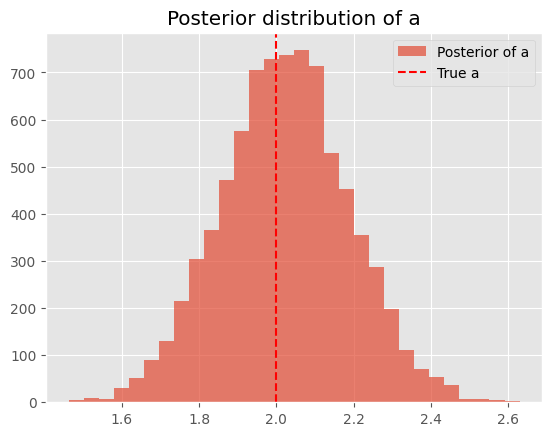

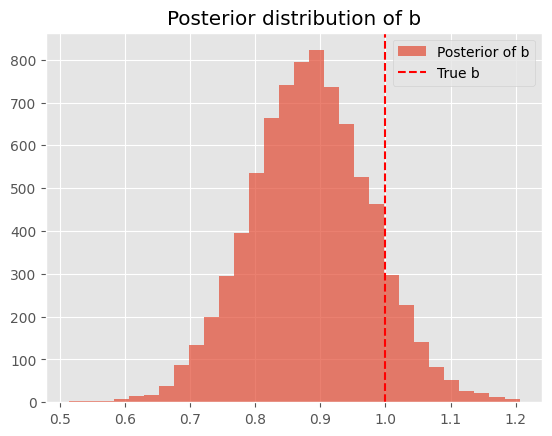

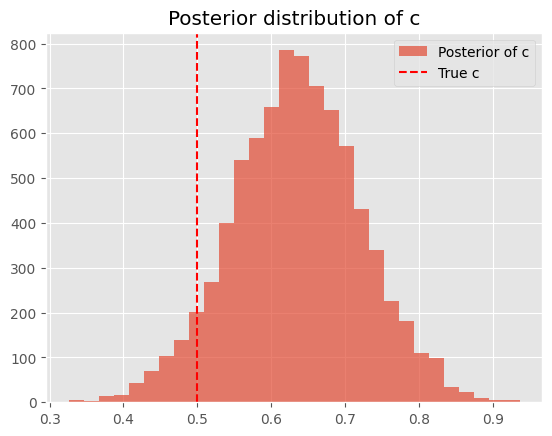

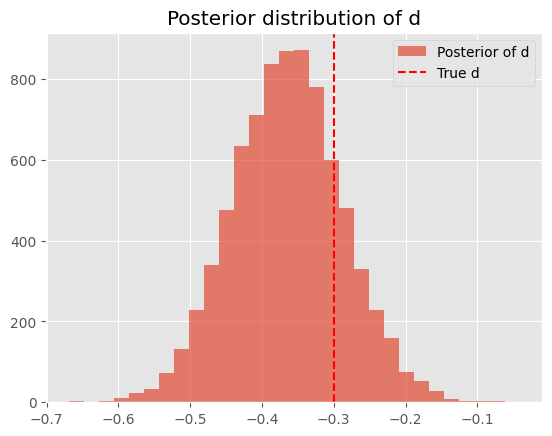

In [ ]:
# モデルの事後分布出力から評価指標を確認するためのコード

# Stan モデルの出力結果
fit_summary = fit.summary()
posterior_samples = fit.draws_pd()

# --- 1. モデル収束性の確認 ---
print("### モデル収束性 ###")
print(fit_summary[["R_hat", "N_Eff"]])

# R-hatと有効サンプルサイズを確認
if all(fit_summary["R_hat"] < 1.01):
    print("R-hatはすべて1.01未満です。モデルは収束しています。")
else:
    print("R-hatが1.01を超えているパラメータがあります。モデルの収束に問題があります。")

if all(fit_summary["N_Eff"] > 100):
    print("有効サンプルサイズ(N_Eff)は十分です。")
else:
    print("n_effが小さいパラメータがあります。サンプル数を増やすことを検討してください。")

# --- 2. 事後分布の形状と真の値 ---
a_samples = posterior_samples["a"]
b_samples = posterior_samples["b"]
c_samples = posterior_samples["c"]
d_samples = posterior_samples["d"]

# a の分布
plt.hist(a_samples, bins=30, alpha=0.7, label="Posterior of a")
plt.axvline(a_mu, color="red", linestyle="--", label="True a")
plt.legend()
plt.title("Posterior distribution of a")
plt.show()

# b の分布
plt.hist(b_samples, bins=30, alpha=0.7, label="Posterior of b")
plt.axvline(b_mu, color="red", linestyle="--", label="True b")
plt.legend()
plt.title("Posterior distribution of b")
plt.show()

# c の分布
plt.hist(c_samples, bins=30, alpha=0.7, label="Posterior of c")
plt.axvline(c_mu, color="red", linestyle="--", label="True c")
plt.legend()
plt.title("Posterior distribution of c")
plt.show()

# d の分布
plt.hist(d_samples, bins=30, alpha=0.7, label="Posterior of d")
plt.axvline(d_mu, color="red", linestyle="--", label="True d")
plt.legend()
plt.title("Posterior distribution of d")
plt.show()

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.598
Model:                            OLS   Adj. R-squared:                  0.585
Method:                 Least Squares   F-statistic:                     47.57
Date:                Mon, 02 Dec 2024   Prob (F-statistic):           6.28e-19
Time:                        10:42:26   Log-Likelihood:                -118.13
No. Observations:                 100   AIC:                             244.3
Df Residuals:                      96   BIC:                             254.7
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.0251      0.164     12.331      0.0

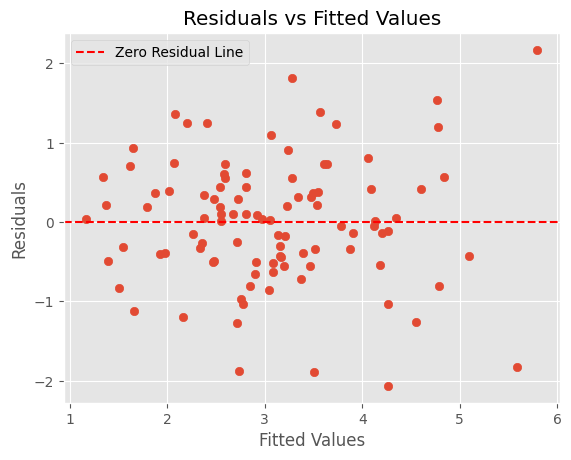

In [ ]:
# データフレームに整理
data = pd.DataFrame({'x1': x1, 'x2': x2, 'x3': x3, 'y': y})

# 説明変数と目的変数の分割
X = data[['x1', 'x2', 'x3']]  # 説明変数
X = sm.add_constant(X)  # 切片項を追加
y = data['y']  # 目的変数

# モデルの適合
model = sm.OLS(y, X)  # OLS（最小二乗法）モデル
results = model.fit()

# 結果の概要を表示
print(results.summary())

# 回帰係数の抽出
coefficients = results.params
print(f"回帰係数:\n{coefficients}")

# 残差プロット
plt.scatter(results.fittedvalues, results.resid)
plt.axhline(0, color='red', linestyle='--', label='Zero Residual Line')
plt.xlabel('Fitted Values')
plt.ylabel('Residuals')
plt.title('Residuals vs Fitted Values')
plt.legend()
plt.show()

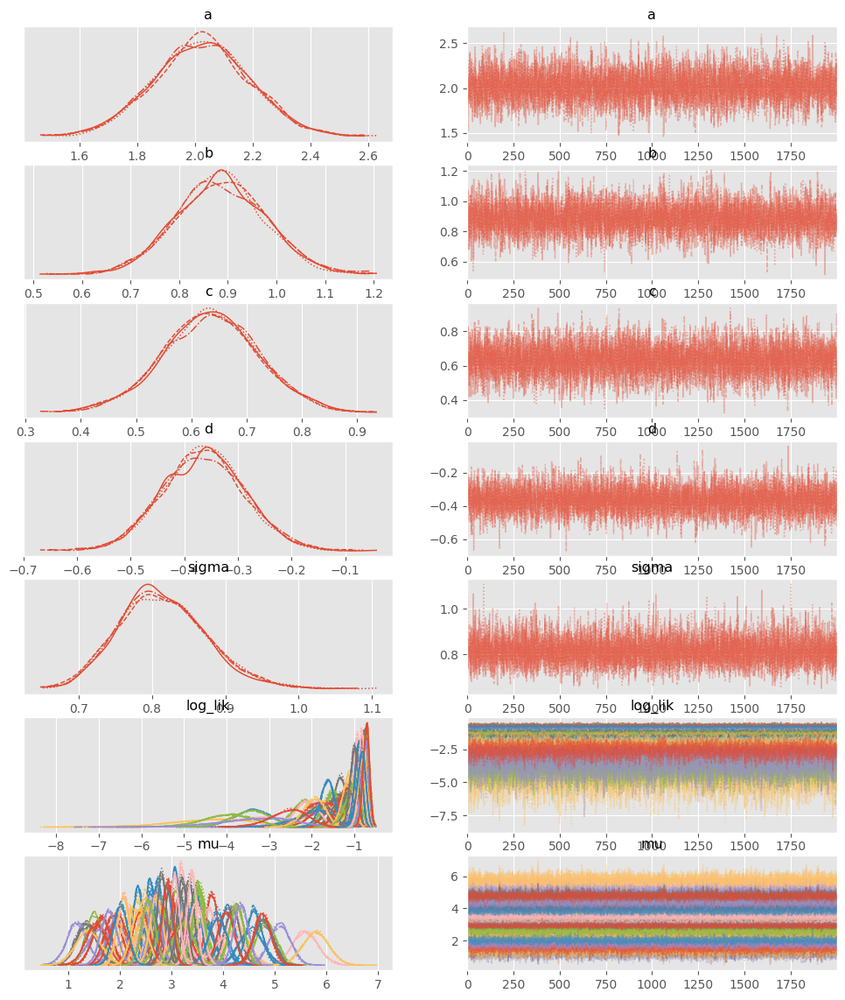

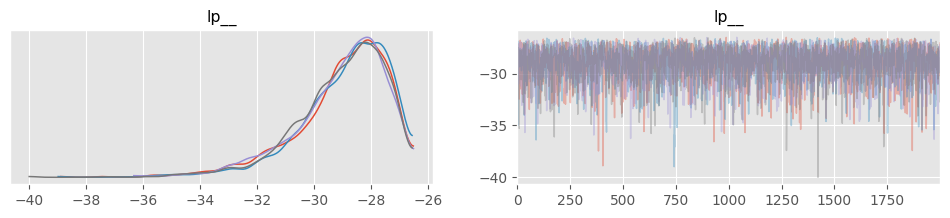

In [ ]:
# 上記のa, b, sigmaの係数に影響？
cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    posterior_predictive="y_pred",
    log_likelihood="lp__",
    observed_data = {"y":data["y"]}
)

# トレースプロットの作成
az.plot_trace(cmdstanpy_data)
plt.show()

# cmdstanpy_data
ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False)
plt.show()

In [ ]:
df_summary = fit.summary()
df_summary = df_summary.loc[df_summary.index.str.contains("y_pred"), :]
df_summary["y_act"] = y

df_summary

In [ ]:
def plot_yy(y_act, y_pred, err_lower,err_upper, min_value=None,max_value=None):
    if min_value == None: min_value = min(y_act) - np.abs(min(y_act)*0.3)
    if max_value == None: max_value = max(y_act) + np.abs(max(y_act)*0.3)
    
    plt.figure(figsize=(5, 5))
    plt.plot([min_value, max_value], [min_value, max_value], c="lightgray")
    plt.scatter(y_act, y_pred)
    plt.errorbar(y_act, y_pred, yerr=[err_lower, err_upper], fmt="o")
    plt.xlim([min_value, max_value])
    plt.ylim([min_value, max_value])
    plt.xlabel("y_actual")
    plt.ylabel("y_pred")
    plt.show()

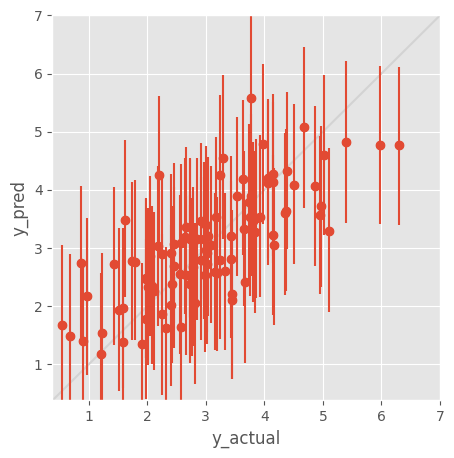

In [ ]:
plot_yy(y_act=df_summary["y_act"], y_pred=df_summary["Mean"], err_lower=df_summary["Mean"]-df_summary["5%"], err_upper=-df_summary["Mean"]+df_summary["95%"],max_value = 7)

In [ ]:
fit.summary()


,Mean,MCSE,StdDev,5%,50%,95%,N_Eff,N_Eff/s,R_hat
lp__,-7.25424,0.017428,0.706380,-8.674270,-6.982680,-6.750230,1642.80,39114.2,1.00142
theta,0.24869,0.002925,0.117611,0.081149,0.235571,0.461952,1616.25,38482.2,1.00104


# 因子分析

## データ作成部

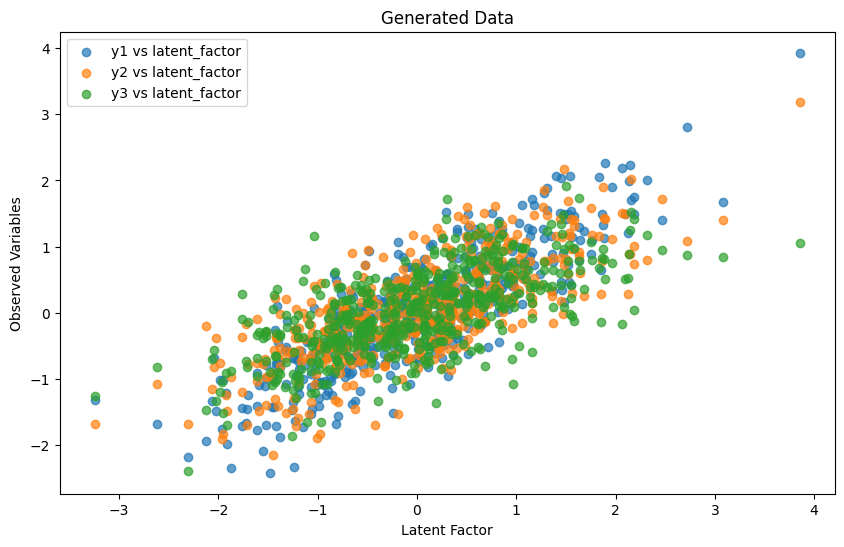

In [24]:
# 再現性のためのシード
np.random.seed(42)

# サンプルサイズ
N = 500

# 因子（潜在変数）
latent_factor = np.random.normal(0, 1, N)  # 平均0、標準偏差1の標準正規分布

# 観測変数のパラメータ
beta_1 = 0.8  # 因子負荷量（変数1）
beta_2 = 0.6  # 因子負荷量（変数2）
beta_3 = 0.4  # 因子負荷量（変数3）

sigma_1 = 0.5  # 観測誤差（変数1）
sigma_2 = 0.5  # 観測誤差（変数2）
sigma_3 = 0.5  # 観測誤差（変数3）

# 観測変数の生成
y1 = beta_1 * latent_factor + np.random.normal(0, sigma_1, N)
y2 = beta_2 * latent_factor + np.random.normal(0, sigma_2, N)
y3 = beta_3 * latent_factor + np.random.normal(0, sigma_3, N)

# データフレームにまとめる
data = pd.DataFrame({'y1': y1, 'y2': y2, 'y3': y3})

# データの可視化
plt.figure(figsize=(10, 6))
plt.scatter(latent_factor, y1, label='y1 vs latent_factor', alpha=0.7)
plt.scatter(latent_factor, y2, label='y2 vs latent_factor', alpha=0.7)
plt.scatter(latent_factor, y3, label='y3 vs latent_factor', alpha=0.7)
plt.xlabel('Latent Factor')
plt.ylabel('Observed Variables')
plt.legend()
plt.title('Generated Data')
plt.show()


## モデル構築部

In [169]:
# stan モデリング部 (線形回帰モデルの例)
stan_code = """
data {
    int N;              // サンプル数
    vector[N] y1;                // 観測変数1
    vector[N] y2;                // 観測変数2
    vector[N] y3;                // 観測変数3
}

parameters {
    real<lower=0> sigma1;        // 観測誤差（変数1）
    real<lower=0> sigma2;        // 観測誤差（変数2）
    real<lower=0> sigma3;        // 観測誤差（変数3）
    real<lower=0> beta1;                  // 因子負荷量（変数1）
    real<lower=0> beta2;                  // 因子負荷量（変数2）
    real<lower=0> beta3;                  // 因子負荷量（変数3）
    vector[N] nu;                // 潜在因子
}

model {
    // 潜在因子の事前分布
    nu ~ std_normal();           // 標準正規分布

    // 因子負荷量の事前分布
    beta1 ~ normal(0.5, 0.5);
    beta2 ~ normal(0.5, 0.5);
    beta3 ~ normal(0.5, 0.5);

    // 観測誤差の事前分布
    sigma1 ~ exponential(1);
    sigma2 ~ exponential(1);
    sigma3 ~ exponential(1);

    // 観測変数のモデル
    y1 ~ normal(beta1 * nu, sigma1);
    y2 ~ normal(beta2 * nu, sigma2);
    y3 ~ normal(beta3 * nu, sigma3);
}

generated quantities {
    vector[N] y1_hat;            // 予測値（変数1）
    vector[N] y2_hat;            // 予測値（変数2）
    vector[N] y3_hat;            // 予測値（変数3）

    for (n in 1:N) {
        y1_hat[n] = beta1 * nu[n];
        y2_hat[n] = beta2 * nu[n];
        y3_hat[n] = beta3 * nu[n];
    }
}
"""

stan_model_path = "./model/factor_alysis.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_code)


## モデル実行部

In [170]:
# Stanモデルのコンパイル
stan_model = stan.CmdStanModel(stan_file=stan_model_path)

09:48:03 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/factor_alysis.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/factor_alysis
09:48:12 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/factor_alysis


In [25]:
# データ整形部
data = {
    "N": N,           # データの長さを指定
    "y1": y1,                # 入力データ
    "y2": y2,                # 入力データ
    "y3": y3                 # 入力データ
}

In [26]:
data

{'N': 500,
 'y1': array([ 8.60460096e-01,  8.44096879e-01, -1.81132956e-01,  1.49990850e+00,
        -5.12643984e-01, -4.30872257e-01,  9.67173290e-01,  1.81952398e-01,
        -3.51318695e-01,  1.85729767e-02, -2.35505741e-01, -3.97702858e-01,
         7.40957938e-02, -1.98440603e+00, -1.66831993e+00, -7.21344105e-02,
        -5.59806302e-01, -2.37379756e-01, -6.76753108e-01, -7.54149399e-01,
         3.37816375e-01,  9.10590558e-02, -2.77289316e-01, -8.54499215e-01,
        -8.17135758e-01, -8.13702979e-01, -1.73456608e+00,  3.24600888e-01,
        -3.50649701e-01, -6.85513312e-01, -1.62069060e-01,  6.51062516e-01,
        -4.38376791e-02, -1.45167684e+00,  3.32117876e-01, -9.52975584e-01,
        -2.63115807e-01, -1.76001387e+00, -5.59402435e-01, -1.30956946e-01,
         1.00861932e+00, -4.27758802e-01,  1.72383463e-01,  4.79901354e-01,
        -2.41863984e+00, -9.74322994e-01, -7.99749532e-02,  7.44175088e-01,
         4.60467568e-01, -1.71242472e+00,  3.02562069e-01, -3.85904442e

In [172]:
num_cpu = multiprocessing.cpu_count()

# モデルのフィッティング
fit = stan_model.sample(
    data=data,
    chains=4,
    seed=1,
    iter_warmup=1000,
    iter_sampling=5000,
    parallel_chains=num_cpu, # 並列数,
    save_warmup=False,
    thin=5,
    output_dir="./output/",
    show_progress=True
    # show_console=True  # コンソール出力を表示
)

09:48:12 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
09:48:13 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status


chain 1 |▎         | 00:00 Iteration:    1 / 6000 [  0%]  (Warmup)


chain 1 |▋         | 00:00 Iteration:  200 / 6000 [  3%]  (Warmup)


chain 1 |█▏        | 00:00 Iteration:  500 / 6000 [  8%]  (Warmup)


chain 1 |█▌        | 00:00 Iteration:  800 / 6000 [ 13%]  (Warmup)


chain 1 |██▎       | 00:00 Iteration: 1100 / 6000 [ 18%]  (Sampling)


chain 1 |██▋       | 00:00 Iteration: 1400 / 6000 [ 23%]  (Sampling)


chain 1 |███▏      | 00:01 Iteration: 1700 / 6000 [ 28%]  (Sampling)


chain 1 |███▋      | 00:01 Iteration: 2000 / 6000 [ 33%]  (Sampling)


chain 1 |████▏     | 00:01 Iteration: 2300 / 6000 [ 38%]  (Sampling)


chain 1 |████▋     | 00:01 Iteration: 2600 / 6000 [ 43%]  (Sampling)


chain 1 |█████▏    | 00:01 Iteration: 2900 / 6000 [ 48%]  (Sampling)


chain 1 |█████▋    | 00


09:48:16 - cmdstanpy - INFO - CmdStan done processing.
09:48:16 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'factor_alysis.stan', line 36, column 4 to column 36)
Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'factor_alysis.stan', line 34, column 4 to column 36)
Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'factor_alysis.stan', line 35, column 4 to column 36)
	Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'factor_alysis.stan', line 35, column 4 to column 36)
Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'factor_alysis.stan', line 34, column 4 to column 36)
Consider re-running with show_console=True if the above output is unclear!


## 結果確認部

array([[<Axes: title={'center': 'lp__'}>,
        <Axes: title={'center': 'lp__'}>]], dtype=object)

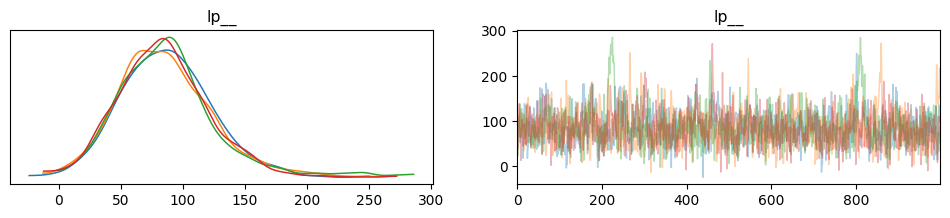

In [173]:
# 結果が収束しているかどうかの確認をしている。
cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    # posterior_predictive="y_pred",
    log_likelihood="lp__",
    # observed_data = {"y":data["y"]}
)

ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False)


array([[<Axes: title={'center': 'beta1\n0'}>,
        <Axes: title={'center': 'beta1\n1'}>,
        <Axes: title={'center': 'beta1\n2'}>],
       [<Axes: title={'center': 'beta1\n3'}>,
        <Axes: title={'center': 'beta2\n0'}>,
        <Axes: title={'center': 'beta2\n1'}>],
       [<Axes: title={'center': 'beta2\n2'}>,
        <Axes: title={'center': 'beta2\n3'}>,
        <Axes: title={'center': 'beta3\n0'}>],
       [<Axes: title={'center': 'beta3\n1'}>,
        <Axes: title={'center': 'beta3\n2'}>,
        <Axes: title={'center': 'beta3\n3'}>]], dtype=object)

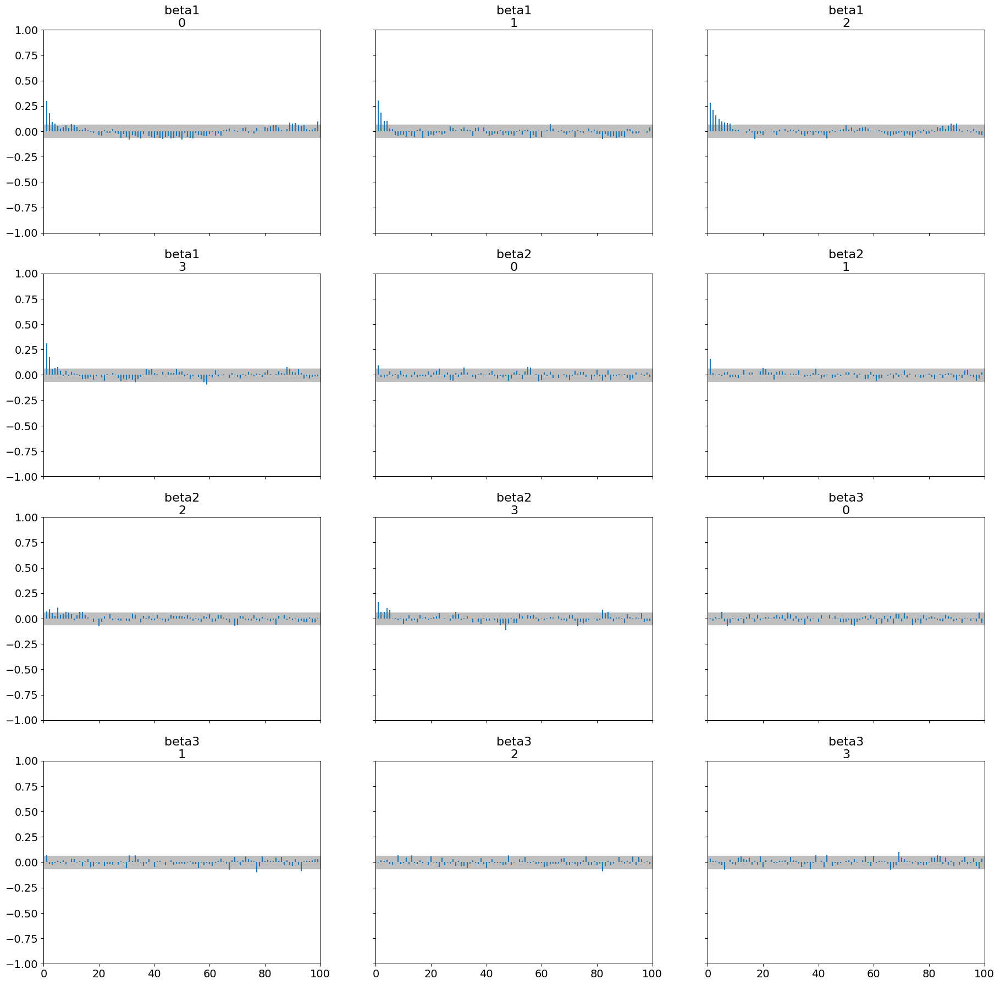

In [176]:
# 定数宣言
ls_varname = [ "beta1", "beta2","beta3"]

# 自己相関を確認？これがみられる場合は、thinを調整する必要がある。
az.plot_autocorr(cmdstanpy_data, var_names=ls_varname)

array([<Axes: title={'center': 'beta1'}>,
       <Axes: title={'center': 'beta2'}>,
       <Axes: title={'center': 'beta3'}>], dtype=object)

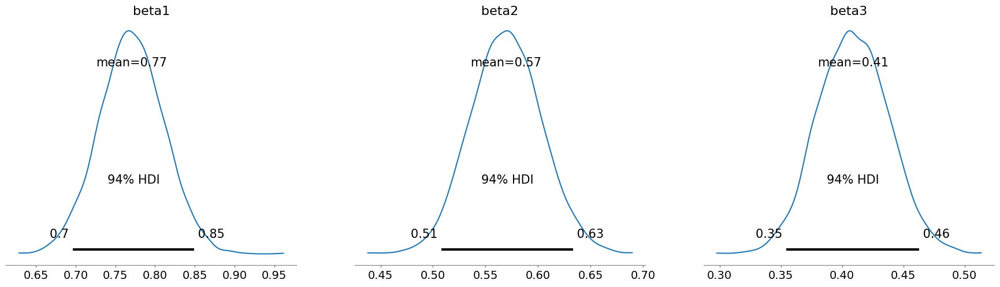

In [177]:
# 大体どのあたりに、meanがあるかの確認。
az.plot_posterior(cmdstanpy_data, var_names=ls_varname)

array([[<Axes: title={'center': 'beta1'}>,
        <Axes: title={'center': 'beta1'}>],
       [<Axes: title={'center': 'beta2'}>,
        <Axes: title={'center': 'beta2'}>],
       [<Axes: title={'center': 'beta3'}>,
        <Axes: title={'center': 'beta3'}>]], dtype=object)

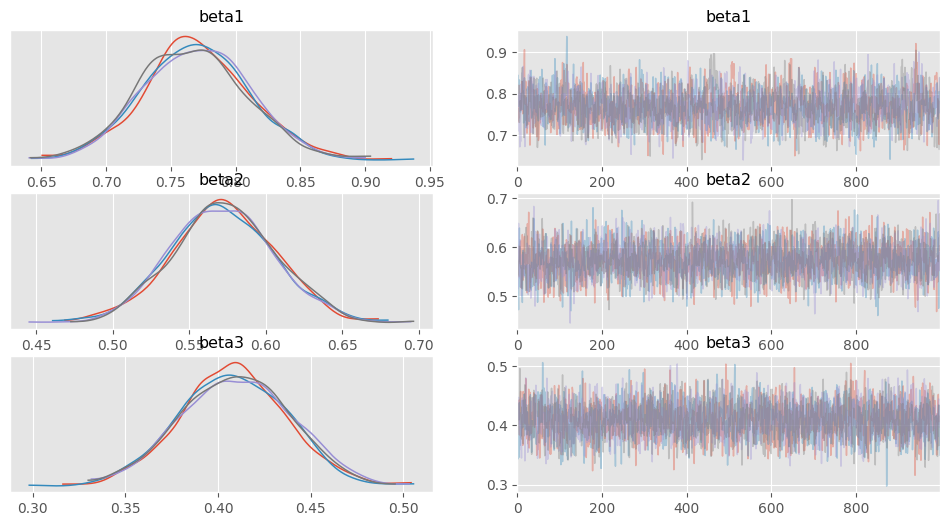

In [ ]:
# 各係数の収束を確認
az.plot_trace(cmdstanpy_data, compact=False, var_names=ls_varname)

array([[<Axes: ylabel='beta2'>, <Axes: >],
       [<Axes: xlabel='beta1', ylabel='beta3'>, <Axes: xlabel='beta2'>]],
      dtype=object)

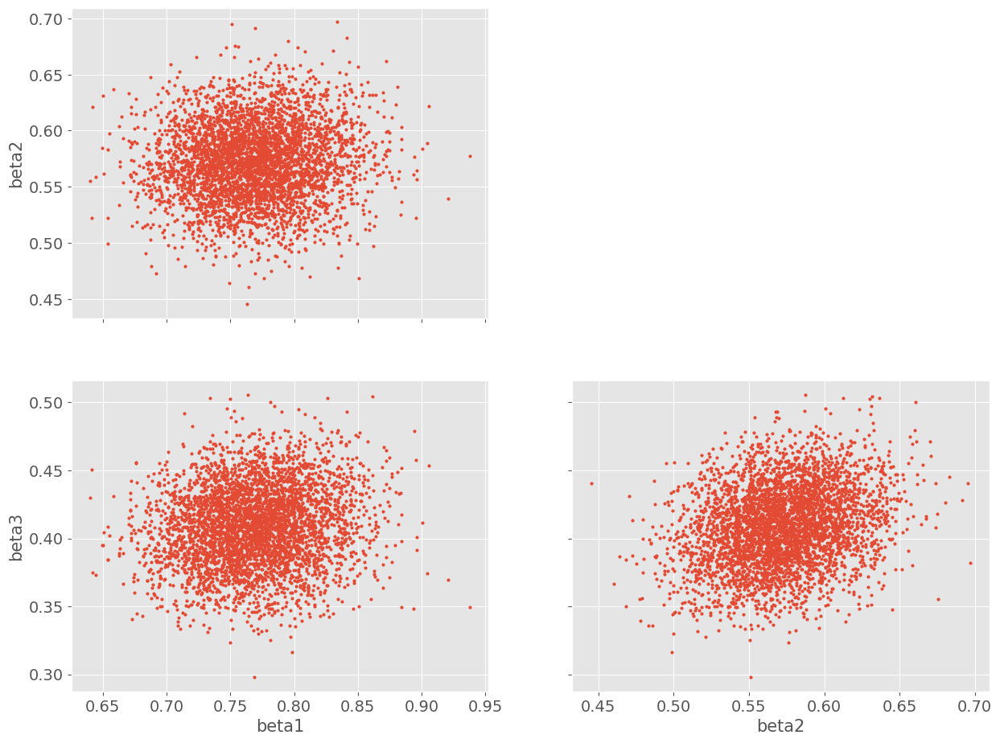

In [ ]:
az.plot_pair(
    cmdstanpy_data,
    divergences=True,
    var_names=ls_varname
)

In [ ]:
# モデルの事後分布出力から評価指標を確認するためのコード

# Stan モデルの出力結果
fit_summary = fit.summary()
posterior_samples = fit.draws_pd()

# --- 1. モデル収束性の確認 ---
print("### モデル収束性 ###")
print(fit_summary[["R_hat", "N_Eff"]])

# R-hatと有効サンプルサイズを確認
if all(fit_summary["R_hat"] < 1.01):
    print("R-hatはすべて1.01未満です。モデルは収束しています。")
else:
    print("R-hatが1.01を超えているパラメータがあります。モデルの収束に問題があります。")

if all(fit_summary["N_Eff"] > 100):
    print("有効サンプルサイズ(N_Eff)は十分です。")
else:
    print("n_effが小さいパラメータがあります。サンプル数を増やすことを検討してください。")

### モデル収束性 ###
                R_hat    N_Eff
lp__         1.002590  1220.58
sigma1       1.002130  1286.71
sigma2       1.001940  2150.35
sigma3       0.999464  3628.25
beta1        1.001310  1826.13
...               ...      ...
y3_hat[496]  0.999653  3607.60
y3_hat[497]  1.002340  4039.04
y3_hat[498]  0.999440  3548.79
y3_hat[499]  1.001110  3935.85
y3_hat[500]  0.999745  3669.06

[2007 rows x 2 columns]
R-hatはすべて1.01未満です。モデルは収束しています。
有効サンプルサイズ(N_Eff)は十分です。


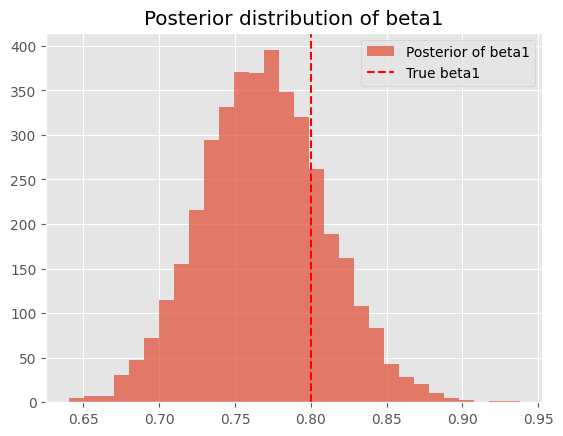

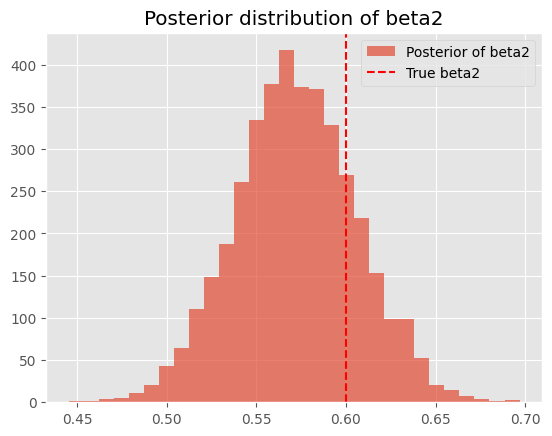

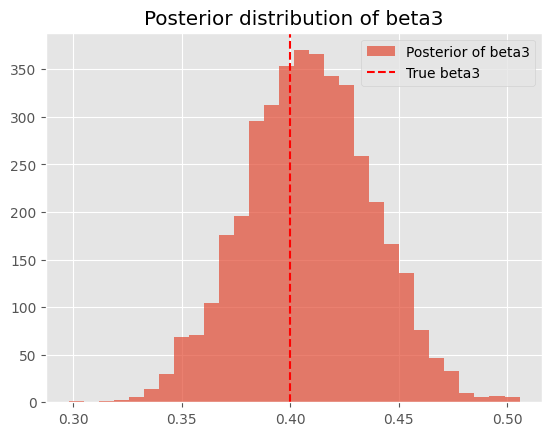

In [ ]:
# --- 2. 事後分布の形状と真の値 ---
b1_samples = posterior_samples["beta1"]
b2_samples = posterior_samples["beta2"]
b3_samples = posterior_samples["beta3"]


# 分布
plt.hist(b1_samples, bins=30, alpha=0.7, label="Posterior of beta1")
plt.axvline(beta_1, color="red", linestyle="--", label="True beta1")
plt.legend()
plt.title("Posterior distribution of beta1")
plt.show()

plt.hist(b2_samples, bins=30, alpha=0.7, label="Posterior of beta2")
plt.axvline(beta_2, color="red", linestyle="--", label="True beta2")
plt.legend()
plt.title("Posterior distribution of beta2")
plt.show()

plt.hist(b3_samples, bins=30, alpha=0.7, label="Posterior of beta3")
plt.axvline(beta_3, color="red", linestyle="--", label="True beta3")
plt.legend()
plt.title("Posterior distribution of beta3")
plt.show()


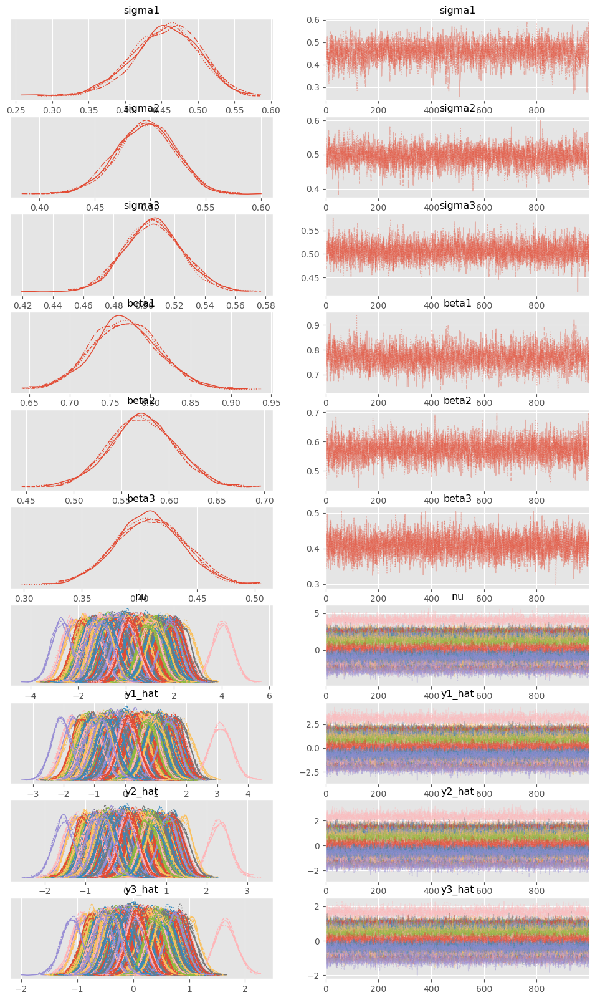

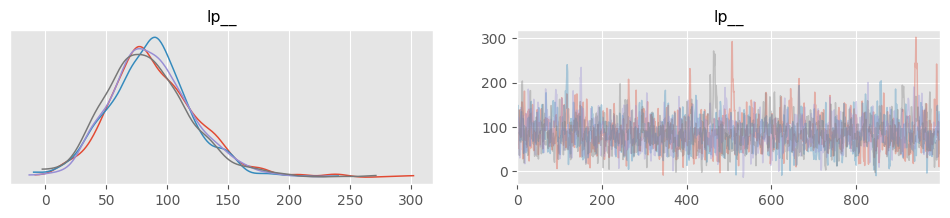

In [ ]:
# 上記のa, b, sigmaの係数に影響？
cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    log_likelihood="lp__",
    observed_data = {"y":data["y"]}
)

# トレースプロットの作成
az.plot_trace(cmdstanpy_data)
plt.show()

# cmdstanpy_data
ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False)
plt.show()

In [ ]:
df_summary = fit.summary()
df_summary

,Mean,MCSE,StdDev,5%,50%,95%,N_Eff,N_Eff/s,R_hat
lp__,87.061700,1.031720,36.044900,34.093700,84.680400,148.174000,1220.58,85.0576,1.002590
sigma1,0.455325,0.001276,0.045788,0.377731,0.458178,0.525806,1286.71,89.6665,1.002130
sigma2,0.496054,0.000570,0.026422,0.451583,0.496704,0.537466,2150.35,149.8500,1.001940
sigma3,0.506046,0.000316,0.019054,0.475866,0.506002,0.538123,3628.25,252.8400,0.999464
beta1,0.769099,0.000959,0.040964,0.702438,0.768747,0.837810,1826.13,127.2560,1.001310
...,...,...,...,...,...,...,...,...,...
y3_hat[496],0.378357,0.002941,0.176649,0.098443,0.372429,0.668712,3607.60,251.4010,0.999653
y3_hat[497],0.039888,0.002666,0.169428,-0.239678,0.036620,0.318692,4039.04,281.4660,1.002340
y3_hat[498],0.066866,0.002824,0.168241,-0.212456,0.066025,0.345204,3548.79,247.3030,0.999440
y3_hat[499],-0.310986,0.002770,0.173782,-0.596117,-0.309941,-0.022567,3935.85,274.2750,1.001110


# bayesian SEM

## データ作成部

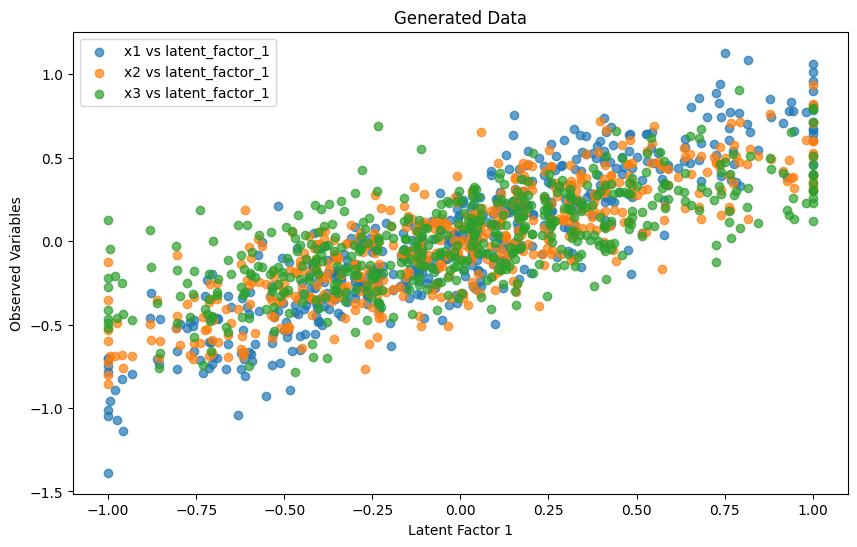

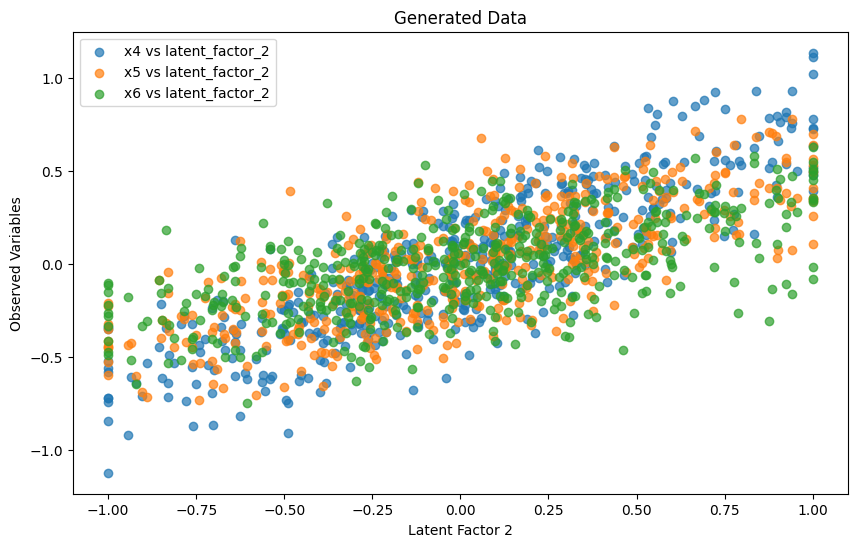

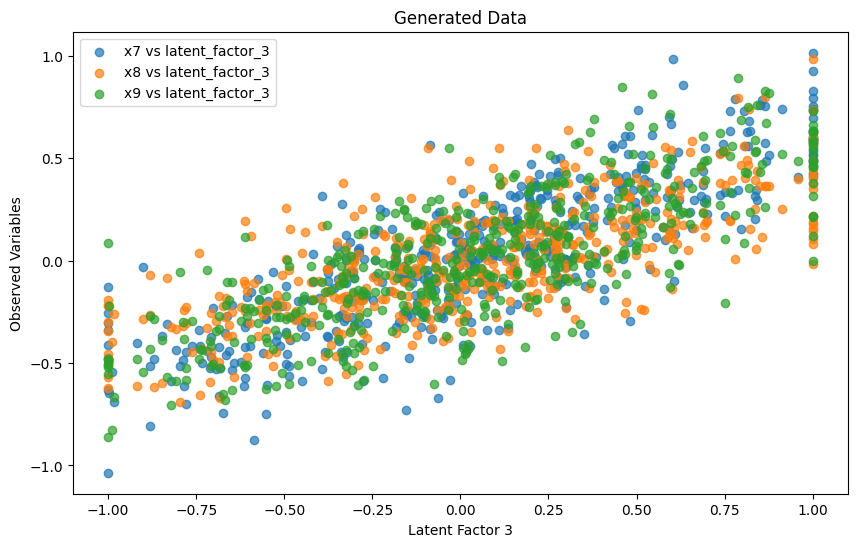

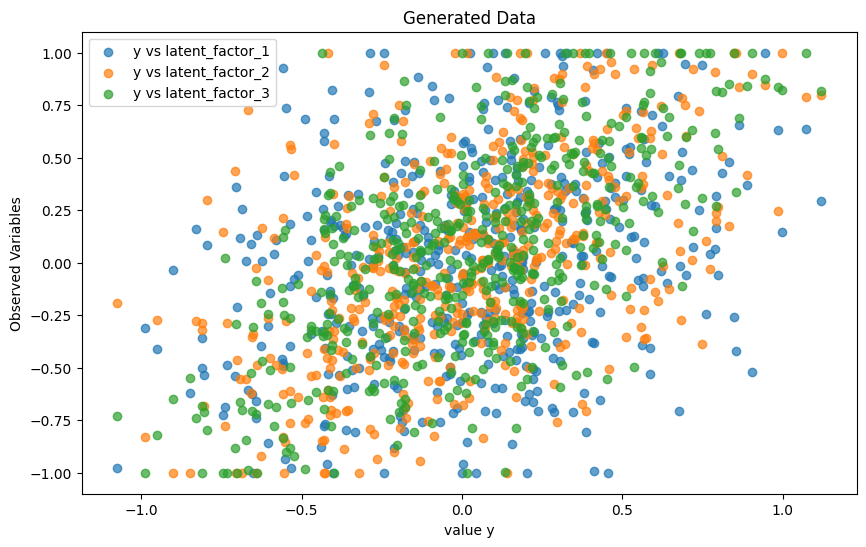

In [211]:
# 再現性のためのシード
np.random.seed(42)

# サンプル数
N = 500

# 潜在因子の生成（f1, f2, f3 は独立と仮定）
f1 = np.random.normal(0, 0.5, N)  # f1 ~ x1 + x2 + x3
f2 = np.random.normal(0, 0.5, N)  # f2 ~ x4 + x5 + x6
f3 = np.random.normal(0, 0.5, N)  # f2 ~ x4 + x5 + x6

# -1から1の範囲に制限
f1 = np.clip(f1, -1, 1)
f2 = np.clip(f2, -1, 1)
f3 = np.clip(f3, -1, 1)

# 観測変数（説明変数）の生成
x1, x2, x3 = f1 * 0.8 + np.random.normal(0, 0.2, N), f1 * 0.6 + np.random.normal(0, 0.2, N), f1 * 0.4 + np.random.normal(0, 0.2, N)
x4, x5, x6 = f2 * 0.7 + np.random.normal(0, 0.2, N), f2 * 0.5 + np.random.normal(0, 0.2, N), f2 * 0.3 + np.random.normal(0, 0.2, N)
x7, x8, x9 = f3 * 0.6 + np.random.normal(0, 0.2, N), f3 * 0.4 + np.random.normal(0, 0.2, N), f3 * 0.5 + np.random.normal(0, 0.2, N)

# 目的変数の生成（y は f1, f2, f3 の線形結合）
y = 0.3 * f1 + 0.4 * f2 + 0.5 * f3 + np.random.normal(0, 0.2, N)

# データフレームとしてまとめる
data = pd.DataFrame({
    'x1': x1, 'x2': x2, 'x3': x3,
    'x4': x4, 'x5': x5, 'x6': x6,
    'x7': x7, 'x8': x8, 'x9': x9,
    'f1': f1, 'f2': f2, 'f3': f3,
    'y': y
})

# データ確認
plt.figure(figsize=(10, 6))
plt.scatter(f1, x1, label='x1 vs latent_factor_1', alpha=0.7)
plt.scatter(f1, x2, label='x2 vs latent_factor_1', alpha=0.7)
plt.scatter(f1, x3, label='x3 vs latent_factor_1', alpha=0.7)
plt.xlabel('Latent Factor 1')
plt.ylabel('Observed Variables')
plt.legend()
plt.title('Generated Data')
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(f2, x4, label='x4 vs latent_factor_2', alpha=0.7)
plt.scatter(f2, x5, label='x5 vs latent_factor_2', alpha=0.7)
plt.scatter(f2, x6, label='x6 vs latent_factor_2', alpha=0.7)
plt.xlabel('Latent Factor 2')
plt.ylabel('Observed Variables')
plt.legend()
plt.title('Generated Data')
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(f3, x7, label='x7 vs latent_factor_3', alpha=0.7)
plt.scatter(f3, x8, label='x8 vs latent_factor_3', alpha=0.7)
plt.scatter(f3, x9, label='x9 vs latent_factor_3', alpha=0.7)
plt.xlabel('Latent Factor 3')
plt.ylabel('Observed Variables')
plt.legend()
plt.title('Generated Data')
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(y, f1, label='y vs latent_factor_1', alpha=0.7)
plt.scatter(y, f2, label='y vs latent_factor_2', alpha=0.7)
plt.scatter(y, f3, label='y vs latent_factor_3', alpha=0.7)
plt.xlabel('value y')
plt.ylabel('Observed Variables')
plt.legend()
plt.title('Generated Data')
plt.show()


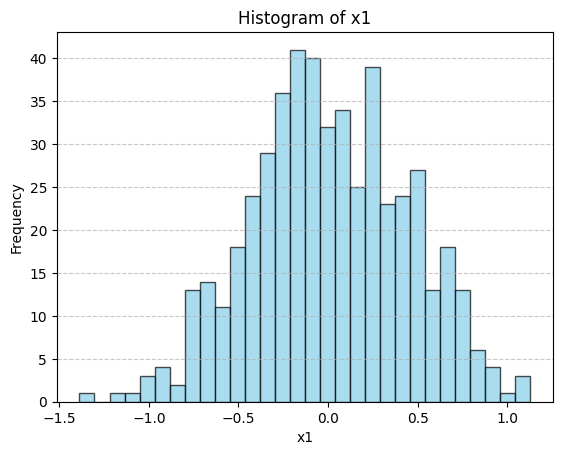

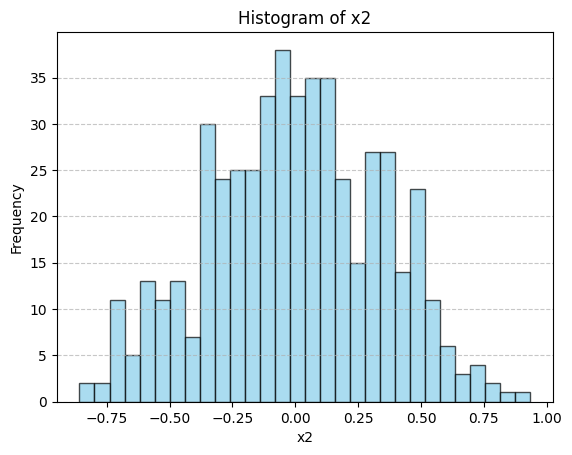

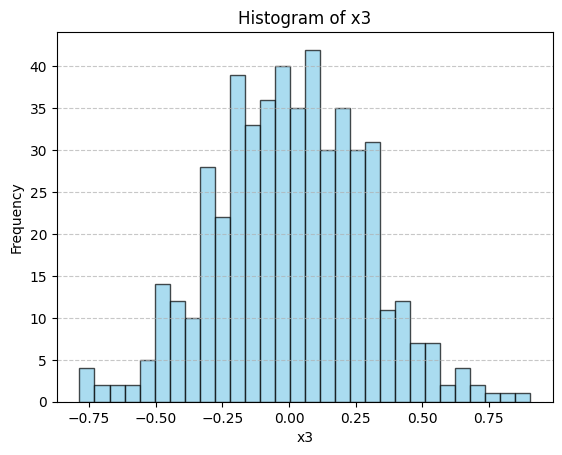

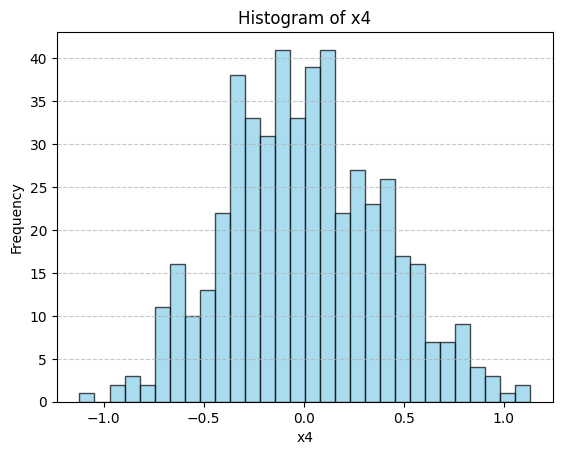

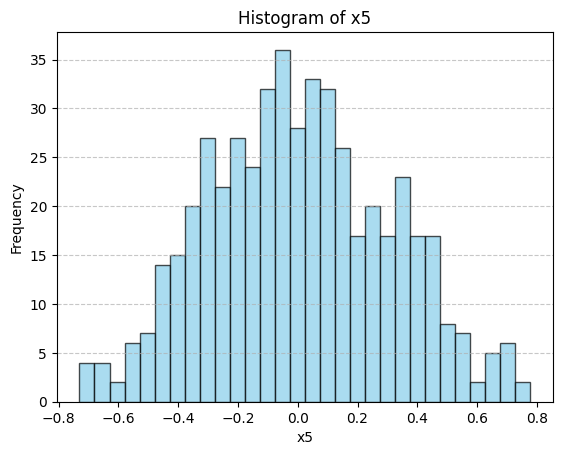

...

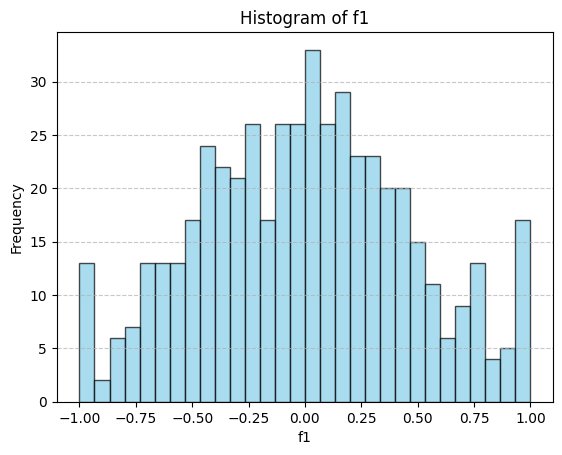

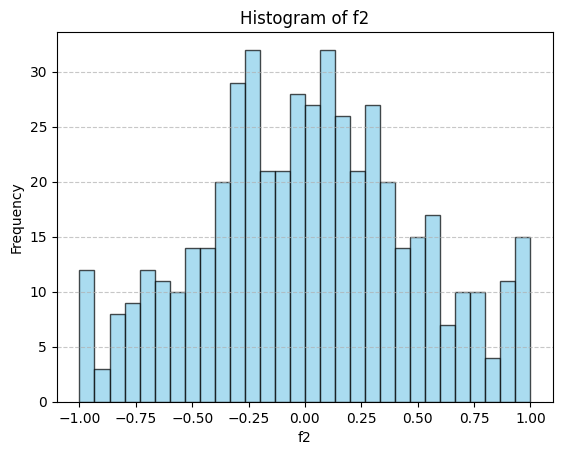

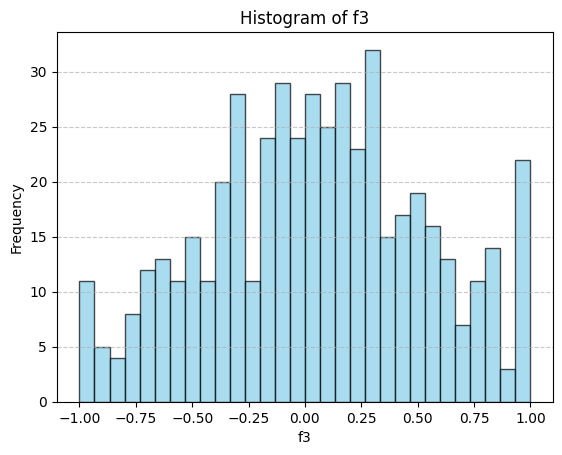

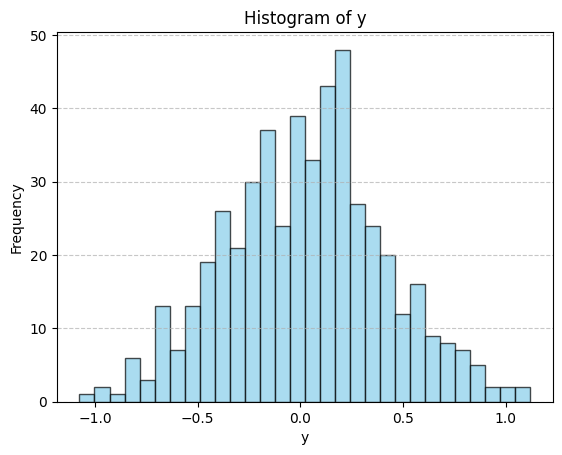

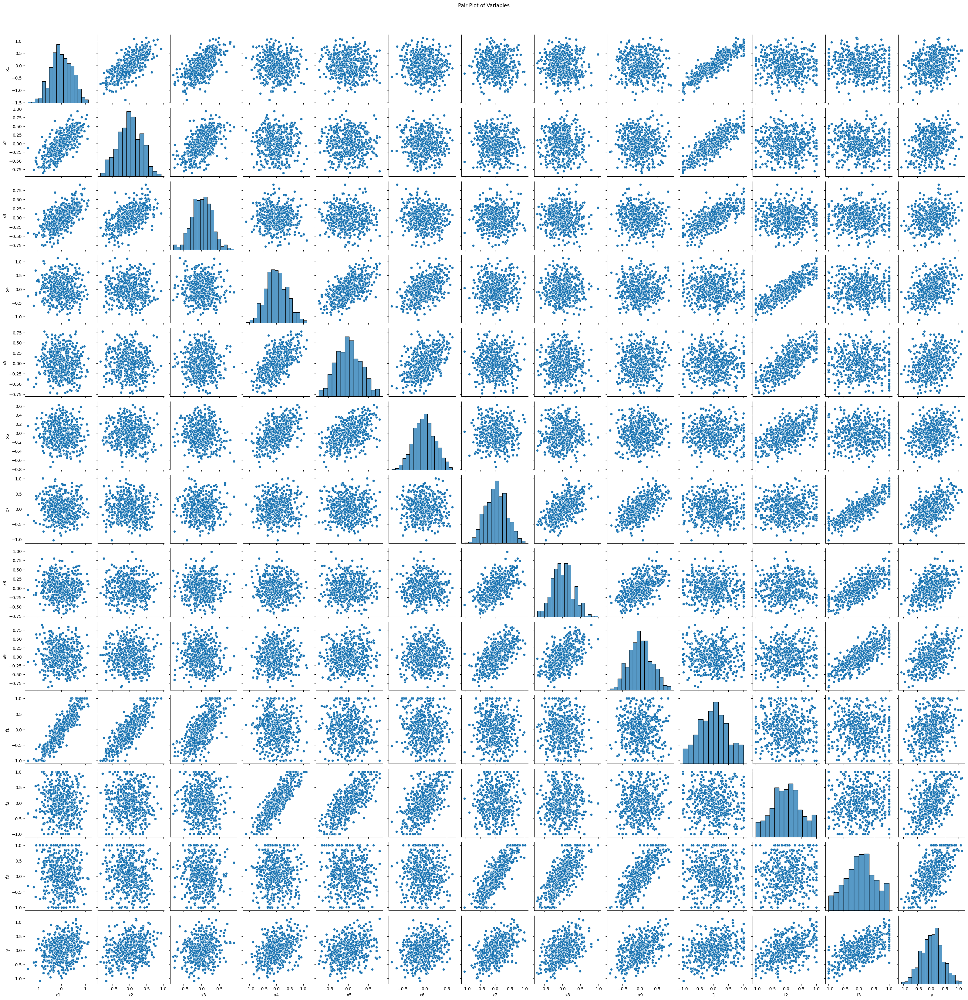

In [212]:
# --- ヒストグラムのプロット ---
for column in data.columns:
    plt.hist(data[column], bins=30, alpha=0.7, color='skyblue', edgecolor='black')
    plt.title(f"Histogram of {column}")
    plt.xlabel(column)
    plt.ylabel("Frequency")
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

# --- ペアプロットのプロット ---
# x1, x2, ..., y 全ての変数をプロット
sns.pairplot(data, diag_kind="hist", corner=False)
plt.suptitle("Pair Plot of Variables", y=1.02)
plt.show()


## モデル構築部

In [214]:
# stan モデリング部 (線形回帰モデルの例)
stan_code = """
data {
    int<lower=0> N;              // サンプル数
    vector[N] x1;                // 観測変数
    vector[N] x2;
    vector[N] x3;
    vector[N] x4;
    vector[N] x5;
    vector[N] x6;
    vector[N] x7;
    vector[N] x8;
    vector[N] x9;
    vector[N] y;                 // 目的変数
}

parameters {
    // 潜在因子
    vector[N] f1;                // 潜在変数 f1
    vector[N] f2;                // 潜在変数 f2
    vector[N] f3;                // 潜在変数 f3

    // 回帰係数
    real<lower=0> beta_f1_x1;             // f1 ~ x1
    real<lower=0> beta_f1_x2;             // f1 ~ x2
    real<lower=0> beta_f1_x3;             // f1 ~ x3
    real<lower=0> beta_f2_x4;             // f2 ~ x4
    real<lower=0> beta_f2_x5;             // f2 ~ x5
    real<lower=0> beta_f2_x6;             // f2 ~ x6
    real<lower=0> beta_f3_x7;             // f3 ~ x7
    real<lower=0> beta_f3_x8;             // f3 ~ x8
    real<lower=0> beta_f3_x9;             // f3 ~ x9

    // 潜在因子と目的変数の回帰係数
    real gamma_y_f1;             // y ~ f1
    real gamma_y_f2;             // y ~ f2
    real gamma_y_f3;             // y ~ f3

    // 観測変数の誤差
    real<lower=0> sigma;      // 誤差項
    real<lower=0> sigma_y;       // yの誤差
}

model {
    for (n in 1:N) {
        x1[n] ~ normal(beta_f1_x1 * f1[n], sigma);
        x2[n] ~ normal(beta_f1_x2 * f1[n], sigma);
        x3[n] ~ normal(beta_f1_x3 * f1[n], sigma);

        x4[n] ~ normal(beta_f2_x4 * f2[n], sigma);
        x5[n] ~ normal(beta_f2_x5 * f2[n], sigma);
        x6[n] ~ normal(beta_f2_x6 * f2[n], sigma);

        x7[n] ~ normal(beta_f3_x7 * f3[n], sigma);
        x8[n] ~ normal(beta_f3_x8 * f3[n], sigma);
        x9[n] ~ normal(beta_f3_x9 * f3[n], sigma);
    }

    f1 ~ normal(0, 1);
    f2 ~ normal(0, 1);
    f3 ~ normal(0, 1);

    y ~ normal(gamma_y_f1 * f1 + gamma_y_f2 * f2 + gamma_y_f3 * f3, sigma_y);

    beta_f1_x1 ~ normal(1, 0.5);
    beta_f1_x2 ~ normal(1, 0.5);
    beta_f1_x3 ~ normal(1, 0.5);
    beta_f2_x4 ~ normal(1, 0.5);
    beta_f2_x5 ~ normal(1, 0.5);
    beta_f2_x6 ~ normal(1, 0.5);
    beta_f3_x7 ~ normal(1, 0.5);
    beta_f3_x8 ~ normal(1, 0.5);
    beta_f3_x9 ~ normal(1, 0.5);
    gamma_y_f1 ~ normal(0, 1);
    gamma_y_f2 ~ normal(0, 1);
    gamma_y_f3 ~ normal(0, 1);
    sigma ~ exponential(1);
    sigma_y ~ exponential(1);
}

generated quantities {
    vector[N] mu;
    vector[N] y_pred;
    vector[N] log_lik;

    for (n in 1:N) {
        mu[n] = gamma_y_f1 * f1[n] + gamma_y_f2 * f2[n] + gamma_y_f3 * f3[n];
        log_lik[n] = normal_lpdf(y[n] | mu[n], sigma_y);
        y_pred[n] = normal_rng(mu[n], sigma_y);
    }
}
"""

stan_model_path = "./model/multi_factor_alysis.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_code)


In [ ]:
# stan モデリング部 (線形回帰モデルの例)
stan_code = """
data {
    int<lower=0> N;              // サンプル数
    vector[N] x1;                // 観測変数
    vector[N] x2;
    vector[N] x3;
    vector[N] x4;
    vector[N] x5;
    vector[N] x6;
    vector[N] x7;
    vector[N] x8;
    vector[N] x9;
    vector[N] y;                 // 目的変数
}

parameters {
    // 潜在因子
    vector[N]<lower=-1,upper=1> f1;                // 潜在変数 f1
    vector[N]<lower=-1,upper=1> f2;                // 潜在変数 f2
    vector[N]<lower=-1,upper=1> f3;                // 潜在変数 f3

    // 回帰係数
    real<lower=0> beta_f1_x1;             // f1 ~ x1
    real<lower=0> beta_f1_x2;             // f1 ~ x2
    real<lower=0> beta_f1_x3;             // f1 ~ x3
    real<lower=0> beta_f2_x4;             // f2 ~ x4
    real<lower=0> beta_f2_x5;             // f2 ~ x5
    real<lower=0> beta_f2_x6;             // f2 ~ x6
    real<lower=0> beta_f3_x7;             // f3 ~ x7
    real<lower=0> beta_f3_x8;             // f3 ~ x8
    real<lower=0> beta_f3_x9;             // f3 ~ x9

    // 潜在因子と目的変数の回帰係数
    real gamma_y_f1;             // y ~ f1
    real gamma_y_f2;             // y ~ f2
    real gamma_y_f3;             // y ~ f3

    // 観測変数の誤差
    real<lower=0> sigma;      // 誤差項
    real<lower=0> sigma_y;       // yの誤差
}

model {
    // 潜在因子のモデル
    f1 ~ normal(beta_f1_x1 * x1 + beta_f1_x2 * x2 + beta_f1_x3 * x3, sigma);
    f2 ~ normal(beta_f2_x4 * x4 + beta_f2_x5 * x5 + beta_f2_x6 * x6, sigma);
    f3 ~ normal(beta_f3_x7 * x7 + beta_f3_x8 * x8 + beta_f3_x9 * x9, sigma);

    // 目的変数のモデル
    y ~ normal(gamma_y_f1 * f1 + gamma_y_f2 * f2 + gamma_y_f3 * f3, sigma_y);

    // 弱い事前分布
    beta_f1_x1 ~ normal(1, 0.5);
    beta_f1_x2 ~ normal(1, 0.5);
    beta_f1_x3 ~ normal(1, 0.5);
    beta_f2_x4 ~ normal(1, 0.5);
    beta_f2_x5 ~ normal(1, 0.5);
    beta_f2_x6 ~ normal(1, 0.5);
    beta_f3_x7 ~ normal(1, 0.5);
    beta_f3_x8 ~ normal(1, 0.5);
    beta_f3_x9 ~ normal(1, 0.5);
    gamma_y_f1 ~ normal(0, 1);
    gamma_y_f2 ~ normal(0, 1);
    gamma_y_f3 ~ normal(0, 1);
    sigma ~ exponential(1);
    sigma_y ~ exponential(1);
}

generated quantities {
    vector[N] mu;
    vector[N] y_pred;
    vector[N] log_lik;

    for (n in 1:N) {
        mu[n] = gamma_y_f1 * f1[n] + gamma_y_f2 * f2[n] + gamma_y_f3 * f3[n];
        log_lik[n] = normal_lpdf(y[n] | mu[n], sigma_y);
        y_pred[n] = normal_rng(mu[n], sigma_y);
    }
}
"""

stan_model_path = "./model/multi_factor_alysis.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_code)


## 結果確認部

## モデル実行部

In [215]:
# Stanモデルのコンパイル
stan_model = stan.CmdStanModel(stan_file=stan_model_path)

10:25:17 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/multi_factor_alysis.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/multi_factor_alysis
10:25:30 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/multi_factor_alysis


In [216]:
stan_data = {
    'N': len(data),
    'x1': data['x1'].values,
    'x2': data['x2'].values,
    'x3': data['x3'].values,
    'x4': data['x4'].values,
    'x5': data['x5'].values,
    'x6': data['x6'].values,
    'x7': data['x7'].values,
    'x8': data['x8'].values,
    'x9': data['x9'].values,
    'y': data['y'].values
}


In [217]:
num_cpu = multiprocessing.cpu_count()

# モデルのフィッティング
fit = stan_model.sample(
    data=stan_data,
    chains=6,
    seed=123,
    iter_warmup=10000,
    iter_sampling=10000,
    parallel_chains=num_cpu, # 並列数,
    save_warmup=False,
    thin=10,
    output_dir="./output/",
    show_progress=True
    # show_console=True  # コンソール出力を表示
)

10:25:30 - cmdstanpy - INFO - Requested 10 parallel_chains but only 6 required, will run all chains in parallel.
10:25:30 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status









chain 1 |          | 00:04 Iteration:     1 / 20000 [  0%]  (Warmup)




chain 1 |▏         | 00:04 Iteration:   100 / 20000 [  0%]  (Warmup)









chain 1 |▏         | 00:05 Iteration:   200 / 20000 [  1%]  (Warmup)






chain 1 |▏         | 00:05 Iteration:   300 / 20000 [  1%]  (Warmup)









chain 1 |▎         | 00:06 Iteration:   400 / 20000 [  2%]  (Warmup)










chain 1 |▎         | 00:06 Iteration:   500 / 20000 [  2%]  (Warmup)









chain 1 |▍         | 00:07 Iteration:   600 / 20000 [  3%]  (Warmup)







chain 1 |▍         | 00:07 Iteration:   700 / 20000 [  3%]  (Warmup)











chain 1 |▍         | 00:08 Iteration:   800 / 20000 [  4%]  (Warmup)









chain 1 |▌         | 00:08 Iteration:   900 / 20000 [  4%]  (Warmup)







chain 1 |▌        


10:27:18 - cmdstanpy - INFO - CmdStan done processing.
10:27:18 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'multi_factor_alysis.stan', line 45, column 8 to column 50)
	Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'multi_factor_alysis.stan', line 45, column 8 to column 50)
Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'multi_factor_alysis.stan', line 62, column 4 to column 77)
	Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'multi_factor_alysis.stan', line 62, column 4 to column 77)
Consider re-running with show_console=True if the above output is unclear!


## 結果確認部

array([[<Axes: title={'center': 'lp__'}>,
        <Axes: title={'center': 'lp__'}>]], dtype=object)

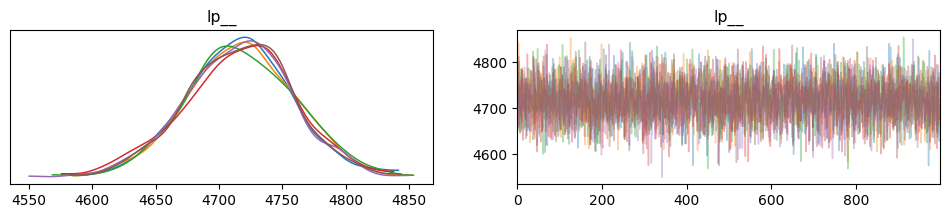

In [218]:
# 結果が収束しているかどうかの確認をしている。

# 上記のa, b, sigmaの係数に影響？
cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    posterior_predictive="y_pred",
    log_likelihood="lp__",
    observed_data = {"y":data["y"]}
)

ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False)


/opt/miniconda3/envs/cmdstanpy_env/lib/python3.10/site-packages/arviz/plots/plot_utils.py:270: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of variables to plot (72) in plot_autocorr, generating only 40 plots
  warnings.warn(


array([[<Axes: title={'center': 'beta_f1_x1\n0'}>,
        <Axes: title={'center': 'beta_f1_x1\n1'}>,
        <Axes: title={'center': 'beta_f1_x1\n2'}>,
        <Axes: title={'center': 'beta_f1_x1\n3'}>],
       [<Axes: title={'center': 'beta_f1_x1\n4'}>,
        <Axes: title={'center': 'beta_f1_x1\n5'}>,
        <Axes: title={'center': 'beta_f1_x2\n0'}>,
        <Axes: title={'center': 'beta_f1_x2\n1'}>],
       [<Axes: title={'center': 'beta_f1_x2\n2'}>,
        <Axes: title={'center': 'beta_f1_x2\n3'}>,
        <Axes: title={'center': 'beta_f1_x2\n4'}>,
        <Axes: title={'center': 'beta_f1_x2\n5'}>],
       [<Axes: title={'center': 'beta_f1_x3\n0'}>,
        <Axes: title={'center': 'beta_f1_x3\n1'}>,
        <Axes: title={'center': 'beta_f1_x3\n2'}>,
        <Axes: title={'center': 'beta_f1_x3\n3'}>],
       [<Axes: title={'center': 'beta_f1_x3\n4'}>,
        <Axes: title={'center': 'beta_f1_x3\n5'}>,
        <Axes: title={'center': 'beta_f2_x4\n0'}>,
        <Axes: title={'cent

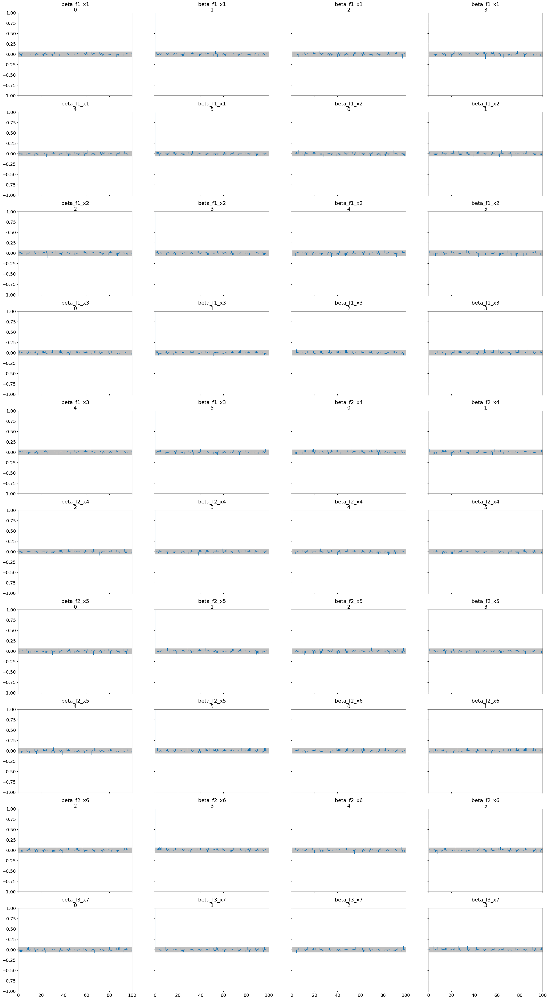

In [219]:
# 定数宣言
ls_varname = [
    "beta_f1_x1", "beta_f1_x2", "beta_f1_x3",
    "beta_f2_x4", "beta_f2_x5", "beta_f2_x6",
    "beta_f3_x7", "beta_f3_x8", "beta_f3_x9",
    "gamma_y_f1", "gamma_y_f2", "gamma_y_f3"
]

# 自己相関を確認？これがみられる場合は、thinを調整する必要がある。
az.plot_autocorr(cmdstanpy_data, var_names=ls_varname)

array([[<Axes: title={'center': 'beta_f1_x1'}>,
        <Axes: title={'center': 'beta_f1_x2'}>,
        <Axes: title={'center': 'beta_f1_x3'}>],
       [<Axes: title={'center': 'beta_f2_x4'}>,
        <Axes: title={'center': 'beta_f2_x5'}>,
        <Axes: title={'center': 'beta_f2_x6'}>],
       [<Axes: title={'center': 'beta_f3_x7'}>,
        <Axes: title={'center': 'beta_f3_x8'}>,
        <Axes: title={'center': 'beta_f3_x9'}>],
       [<Axes: title={'center': 'gamma_y_f1'}>,
        <Axes: title={'center': 'gamma_y_f2'}>,
        <Axes: title={'center': 'gamma_y_f3'}>]], dtype=object)

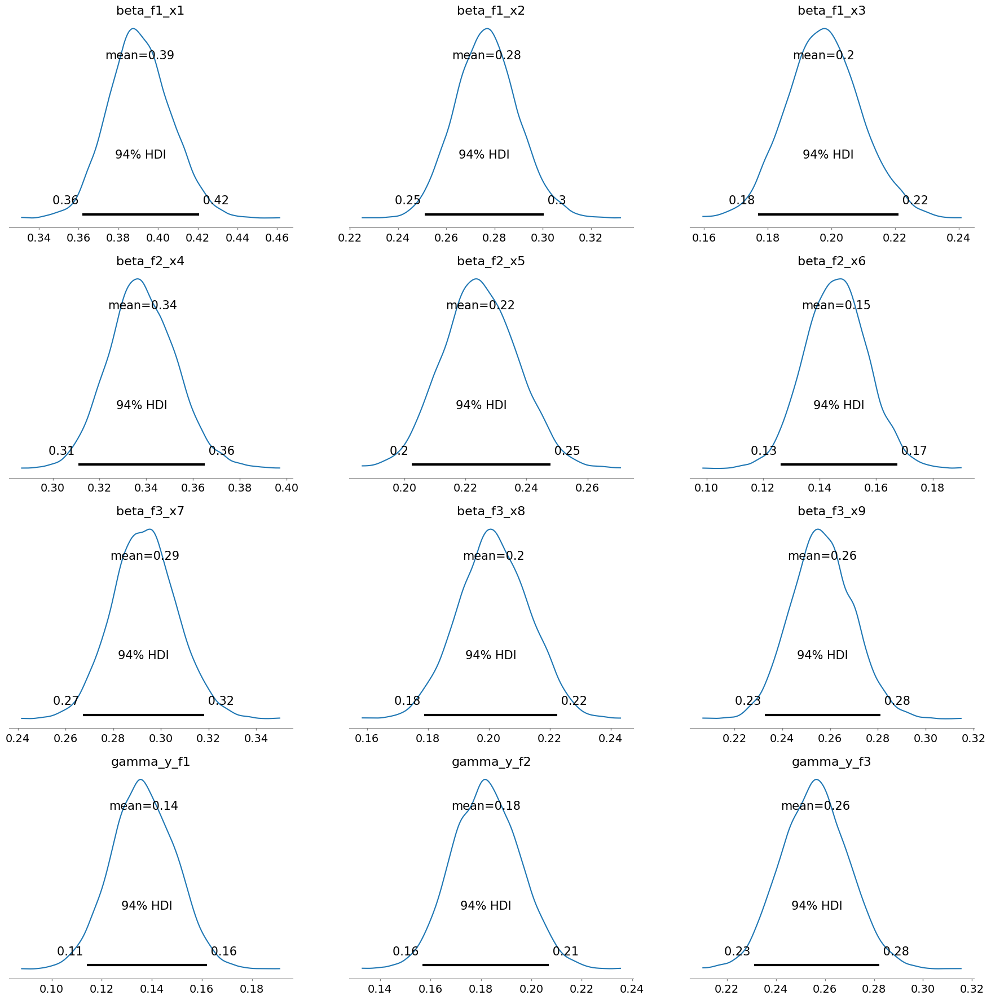

In [220]:
# 大体どのあたりに、meanがあるかの確認。
az.plot_posterior(cmdstanpy_data, var_names=ls_varname)

array([[<Axes: title={'center': 'beta_f1_x1'}>,
        <Axes: title={'center': 'beta_f1_x1'}>],
       [<Axes: title={'center': 'beta_f1_x2'}>,
        <Axes: title={'center': 'beta_f1_x2'}>],
       [<Axes: title={'center': 'beta_f1_x3'}>,
        <Axes: title={'center': 'beta_f1_x3'}>],
       [<Axes: title={'center': 'beta_f2_x4'}>,
        <Axes: title={'center': 'beta_f2_x4'}>],
       [<Axes: title={'center': 'beta_f2_x5'}>,
        <Axes: title={'center': 'beta_f2_x5'}>],
       [<Axes: title={'center': 'beta_f2_x6'}>,
        <Axes: title={'center': 'beta_f2_x6'}>],
       [<Axes: title={'center': 'beta_f3_x7'}>,
        <Axes: title={'center': 'beta_f3_x7'}>],
       [<Axes: title={'center': 'beta_f3_x8'}>,
        <Axes: title={'center': 'beta_f3_x8'}>],
       [<Axes: title={'center': 'beta_f3_x9'}>,
        <Axes: title={'center': 'beta_f3_x9'}>],
       [<Axes: title={'center': 'gamma_y_f1'}>,
        <Axes: title={'center': 'gamma_y_f1'}>],
       [<Axes: title={'center'

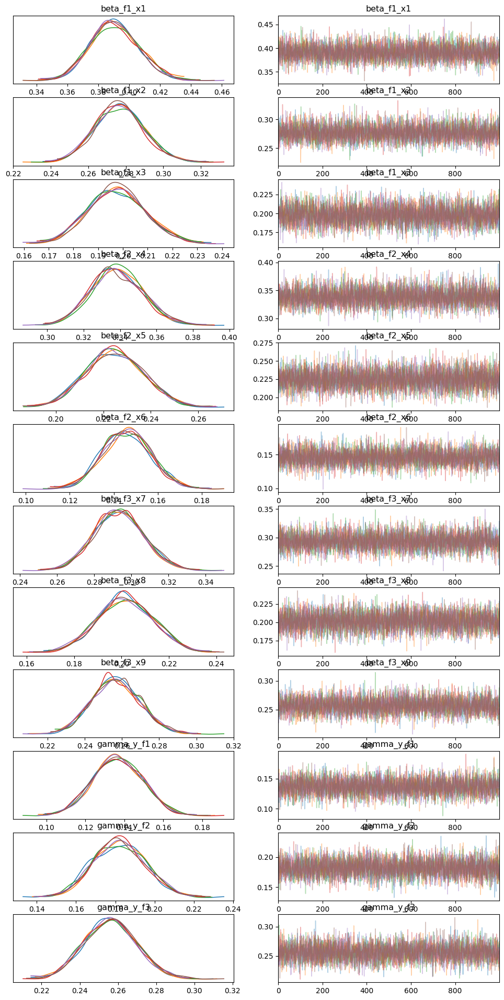

In [221]:
# 各係数の収束を確認
az.plot_trace(cmdstanpy_data, compact=False, var_names=ls_varname)

/opt/miniconda3/envs/cmdstanpy_env/lib/python3.10/site-packages/arviz/plots/backends/matplotlib/pairplot.py:233: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of resulting pair plots with these variables, generating only a 8x8 grid
  warnings.warn(


array([[<Axes: ylabel='beta_f1_x2'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='beta_f1_x3'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='beta_f2_x4'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='beta_f2_x5'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='beta_f2_x6'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='beta_f3_x7'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: ylabel='beta_f3_x8'>, <Axes: >, <Axes: >, <Axes: >,
        <Axes: >, <Axes: >, <Axes: >, <Axes: >],
       [<Axes: xlabel='beta_f1_x1', ylabel='beta_f3_x9'>,
        <Axes: xlabel='beta_f1_x2'>, <Axes: xlabel='beta_f1_x3'>,
        <Axes: xlabel='beta_f2_x4'>, <Axes: xlabel='beta_f2_x5'>

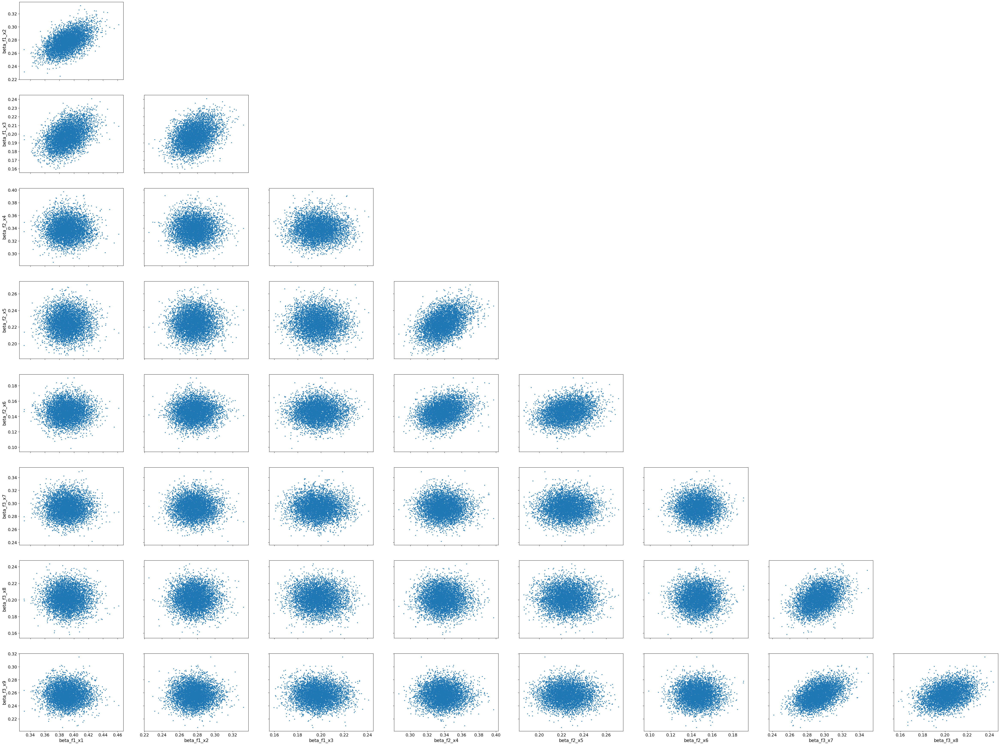

In [222]:
az.plot_pair(
    cmdstanpy_data,
    divergences=True,
    var_names=ls_varname
)

In [223]:
df_summary.loc[df_summary.index.str.contains("y_pred"), :]

,Mean,MCSE,StdDev,5%,50%,95%,N_Eff,N_Eff/s,R_hat,y_act
y_pred[1],0.230006,0.002641,0.198781,-0.094760,0.224422,0.567637,5665.490,10.570500,1.000420,0.208423
y_pred[2],0.039963,0.003636,0.203627,-0.313183,0.054989,0.356864,3136.380,5.851760,1.004340,0.101913
y_pred[3],-0.037214,0.002590,0.199186,-0.360553,-0.043731,0.294688,5914.000,11.034100,1.000310,-0.063230
y_pred[4],0.530463,0.002749,0.200302,0.206128,0.522400,0.867464,5307.960,9.903420,1.001240,0.491216
y_pred[5],-0.162801,0.002582,0.198317,-0.497096,-0.155840,0.157013,5900.360,11.008700,1.002830,-0.131733
...,...,...,...,...,...,...,...,...,...,...
y_pred[496],0.435919,0.002640,0.201470,0.094592,0.442599,0.765436,5822.520,10.863500,1.001310,0.464348
y_pred[497],-0.007302,0.013747,0.221194,-0.403304,0.021381,0.309870,258.900,0.483047,1.029080,0.170474
y_pred[498],0.163397,0.014135,0.223936,-0.235306,0.187784,0.485660,250.996,0.468300,1.030370,0.345163
y_pred[499],-0.319807,0.002577,0.201450,-0.649351,-0.319301,0.020761,6113.000,11.405400,0.999539,-0.318249


In [224]:
df_summary = fit.summary()
df_summary

,Mean,MCSE,StdDev,5%,50%,95%,N_Eff,N_Eff/s,R_hat
lp__,4716.530000,0.580836,42.720700,4644.570000,4717.560000,4787.120000,5409.64,19.2110,0.999506
f1[1],0.600557,0.004730,0.355987,0.006773,0.603368,1.193640,5665.45,20.1194,0.999971
f1[2],-0.120843,0.004705,0.362640,-0.732301,-0.125330,0.473837,5940.51,21.0962,0.999342
f1[3],0.190587,0.004688,0.358229,-0.392250,0.192589,0.771501,5839.42,20.7373,0.999990
f1[4],1.202730,0.004603,0.355491,0.629087,1.198420,1.783220,5963.26,21.1770,0.999771
...,...,...,...,...,...,...,...,...,...
log_lik[496],0.508839,0.003168,0.245835,0.022431,0.588842,0.722085,6020.05,21.3787,0.999727
log_lik[497],0.089548,0.007572,0.585535,-1.061980,0.248619,0.689596,5979.51,21.2347,1.000100
log_lik[498],0.172341,0.007224,0.539225,-0.919379,0.338324,0.693476,5572.18,19.7882,1.000930
log_lik[499],0.504451,0.003183,0.243748,-0.001753,0.587061,0.723941,5863.06,20.8212,0.999631


In [227]:
df_summary = fit.summary()
df_summary = df_summary.loc[df_summary.index.str.contains("y_pred"), :]
df_summary["y_act"] = y

df_summary



,Mean,MCSE,StdDev,5%,50%,95%,N_Eff,N_Eff/s,R_hat,y_act
y_pred[1],0.399481,0.002995,0.234172,0.015529,0.394778,0.778643,6114.31,21.7134,0.999822,0.386765
y_pred[2],0.369724,0.003076,0.232260,-0.014885,0.369414,0.752827,5701.68,20.2481,0.999986,0.466116
y_pred[3],-0.367670,0.002957,0.233340,-0.750675,-0.368692,0.016298,6225.81,22.1094,0.999491,-0.356065
y_pred[4],0.138639,0.003123,0.234497,-0.251140,0.143919,0.519177,5638.90,20.0251,0.999553,0.069715
y_pred[5],-0.065731,0.003093,0.234546,-0.455869,-0.065169,0.318973,5749.96,20.4196,0.999819,-0.033526
...,...,...,...,...,...,...,...,...,...,...
y_pred[496],0.597718,0.002995,0.232579,0.220277,0.597304,0.982368,6030.00,21.4141,0.999945,0.600902
y_pred[497],0.712634,0.003105,0.238553,0.311720,0.715552,1.105340,5904.48,20.9683,0.999601,0.903403
y_pred[498],0.470312,0.003028,0.234728,0.087152,0.473355,0.851678,6007.87,21.3354,1.000410,0.638087
y_pred[499],0.012217,0.003143,0.234975,-0.374759,0.012424,0.395730,5590.11,19.8519,1.000320,-0.002853


In [228]:
def plot_yy(y_act, y_pred, err_lower,err_upper, min_value=None,max_value=None):
    if min_value == None: min_value = min(y_act) - np.abs(min(y_act)*0.3)
    if max_value == None: max_value = max(y_act) + np.abs(max(y_act)*0.3)
    
    plt.figure(figsize=(5, 5))
    plt.plot([min_value, max_value], [min_value, max_value], c="lightgray")
    plt.scatter(y_act, y_pred)
    plt.errorbar(y_act, y_pred, yerr=[err_lower, err_upper], fmt="o")
    plt.xlim([min_value, max_value])
    plt.ylim([min_value, max_value])
    plt.xlabel("y_actual")
    plt.ylabel("y_pred")
    plt.show()

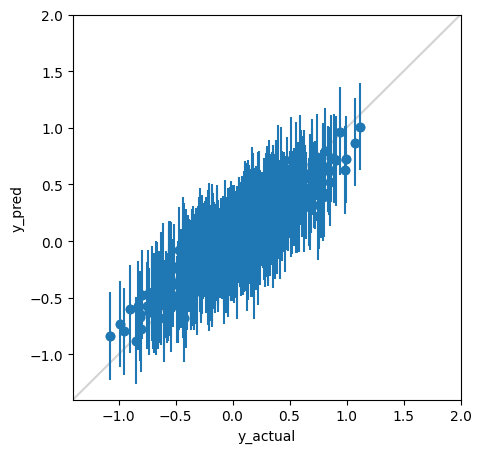

In [229]:
plot_yy(y_act=df_summary["y_act"], y_pred=df_summary["Mean"], err_lower=df_summary["Mean"]-df_summary["5%"], err_upper=-df_summary["Mean"]+df_summary["95%"],max_value = 2)

In [230]:
# モデルの事後分布出力から評価指標を確認するためのコード

# Stan モデルの出力結果
fit_summary = fit.summary()
posterior_samples = fit.draws_pd()

# --- 1. モデル収束性の確認 ---
print("### モデル収束性 ###")
print(fit_summary[["R_hat", "N_Eff"]])

# R-hatと有効サンプルサイズを確認
if all(fit_summary["R_hat"] < 1.01):
    print("R-hatはすべて1.01未満です。モデルは収束しています。")
else:
    print("R-hatが1.01を超えているパラメータがあります。モデルの収束に問題があります。")

if all(fit_summary["N_Eff"] > 100):
    print("有効サンプルサイズ(N_Eff)は十分です。")
else:
    print("n_effが小さいパラメータがあります。サンプル数を増やすことを検討してください。")

### モデル収束性 ###
                 R_hat    N_Eff
lp__          0.999506  5409.64
f1[1]         0.999971  5665.45
f1[2]         0.999342  5940.51
f1[3]         0.999990  5839.42
f1[4]         0.999771  5963.26
...                ...      ...
log_lik[496]  0.999727  6020.05
log_lik[497]  1.000100  5979.51
log_lik[498]  1.000930  5572.18
log_lik[499]  0.999631  5863.06
log_lik[500]  0.999621  6132.67

[3015 rows x 2 columns]
R-hatはすべて1.01未満です。モデルは収束しています。
有効サンプルサイズ(N_Eff)は十分です。


In [204]:
fit_summary[fit_summary["R_hat"] > 1.01].describe()

,Mean,MCSE,StdDev,5%,50%,95%,N_Eff,N_Eff/s,R_hat
count,1999.000000,1999.000000,1999.000000,1999.000000,1999.000000,1999.000000,1999.000000,1999.000000,1999.000000
mean,0.753473,0.141801,0.899918,-0.505400,0.650027,2.347639,260.775205,0.486546,1.038097
std,27.444631,4.583877,17.465006,6.439784,23.768019,60.331670,230.689116,0.430413,0.025716
min,-5.697870,0.002477,0.058830,-8.558050,-5.577430,-3.313500,14.526800,0.027104,1.010010
25%,-0.281751,0.019658,0.218573,-1.044115,-0.282483,0.176687,123.864500,0.231102,1.019310
50%,0.196279,0.032750,0.544314,-0.397231,0.175687,0.878721,167.669000,0.312832,1.032730
75%,0.654727,0.050938,0.632049,0.016538,0.590077,1.770990,344.642500,0.643023,1.048625
max,1226.300000,204.981000,781.267000,282.431000,1061.830000,2697.880000,2340.650000,4.367120,1.293960


# 実データでのモデル検証

## データ作成部

In [194]:
raw_data = pd.read_csv("./data/data_questionnaire.csv")

/var/folders/l3/m4gqq46s65j7ryscv8skvykw0000gn/T/ipykernel_51045/3818647635.py:1: DtypeWarning: Columns (183,274) have mixed types. Specify dtype option on import or set low_memory=False.
  raw_data = pd.read_csv("./data/data_questionnaire.csv")


In [78]:
col_list = ["Q1","Q3S1.1","Q3S2.1","Q3S3.1","Q3S4.1","Q3S5.1","Q3S6.1","Q3S7.1","Q3S8.1","Q3S9.1","Q3S10.1","Q3S11.1","Q3S12.1"]
pickdata = raw_data[col_list]
pickdata = (pickdata-6)/5

In [79]:
pickdata.describe()

,Q1,Q3S1.1,Q3S2.1,Q3S3.1,Q3S4.1,Q3S5.1,Q3S6.1,Q3S7.1,Q3S8.1,Q3S9.1,Q3S10.1,Q3S11.1,Q3S12.1
count,10619.000000,10619.000000,10619.000000,10619.000000,10619.000000,10619.000000,10619.000000,10619.000000,10619.000000,10619.000000,10619.000000,10619.000000,10619.000000
mean,0.157096,-0.027630,-0.043733,0.121480,0.073077,0.109389,0.117808,0.082042,-0.115792,0.121010,0.154836,0.047142,-0.043130
std,0.472540,0.464503,0.442063,0.441782,0.423025,0.435535,0.411341,0.412651,0.428723,0.392554,0.387439,0.391100,0.382043
min,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,0.000000,-0.400000,-0.400000,-0.200000,-0.200000,-0.200000,0.000000,-0.200000,-0.400000,0.000000,0.000000,0.000000,-0.200000
50%,0.200000,0.000000,0.000000,0.200000,0.000000,0.200000,0.000000,0.000000,0.000000,0.000000,0.200000,0.000000,0.000000
75%,0.600000,0.400000,0.200000,0.400000,0.400000,0.400000,0.400000,0.400000,0.200000,0.400000,0.400000,0.200000,0.200000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


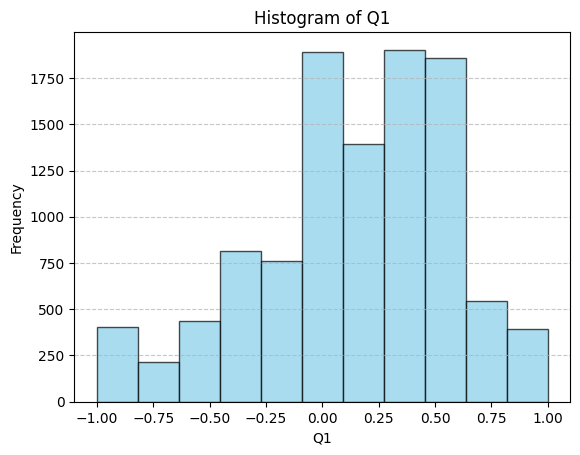

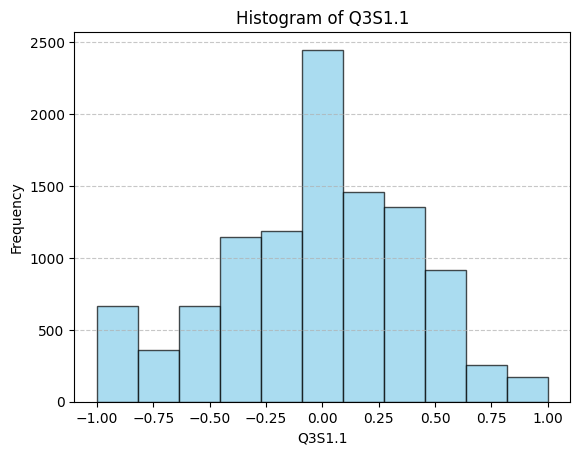

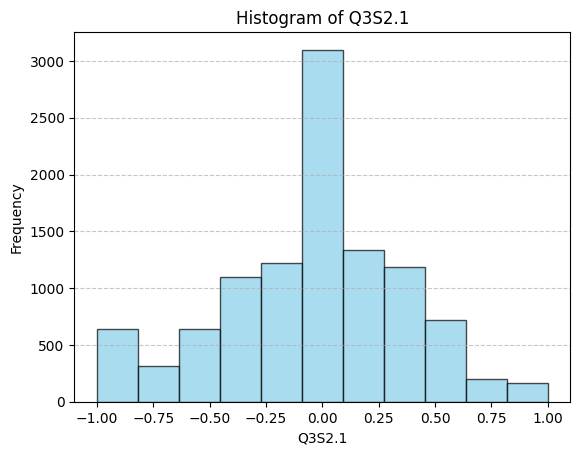

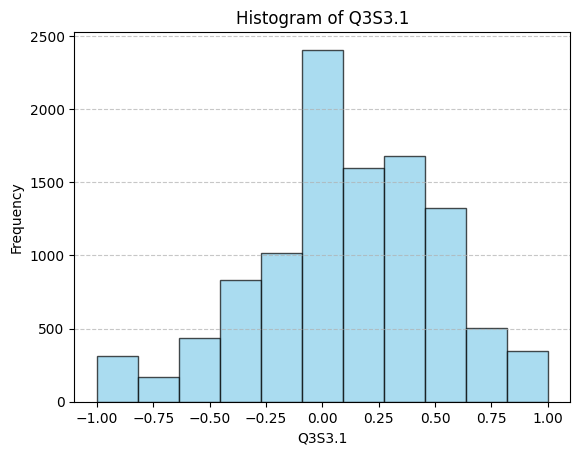

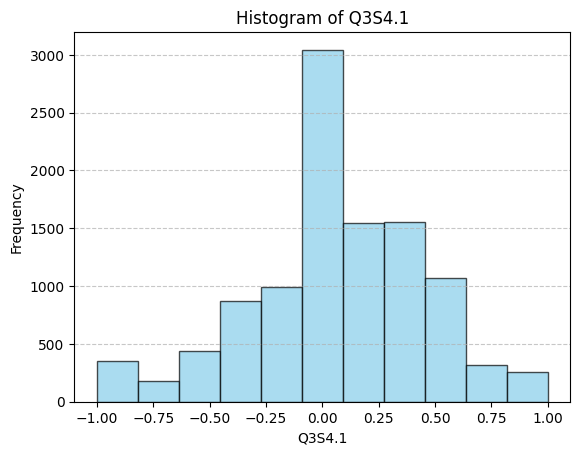

...

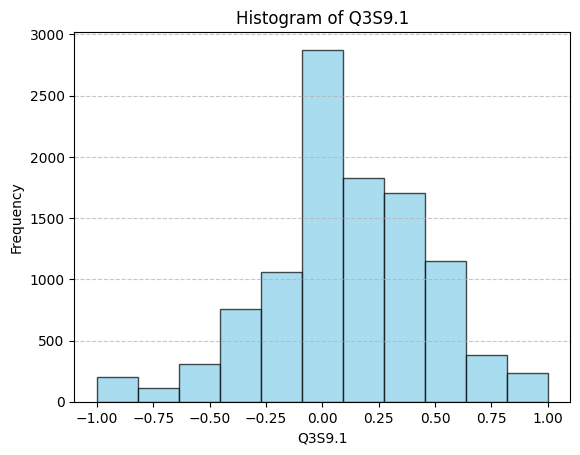

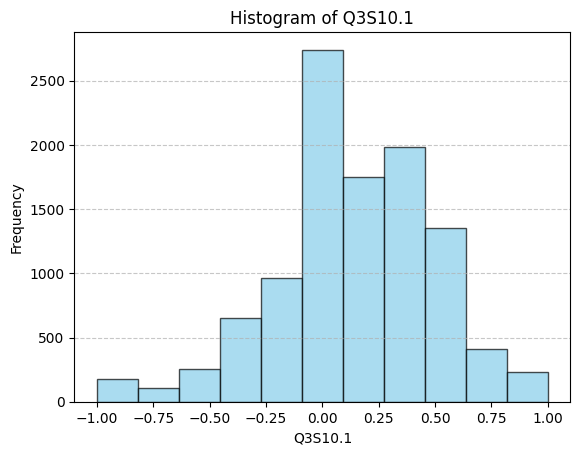

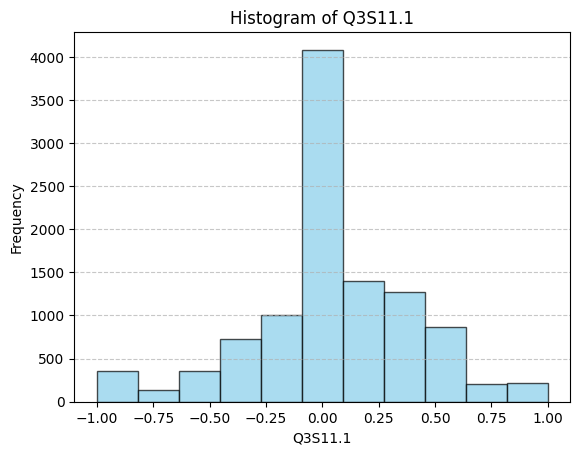

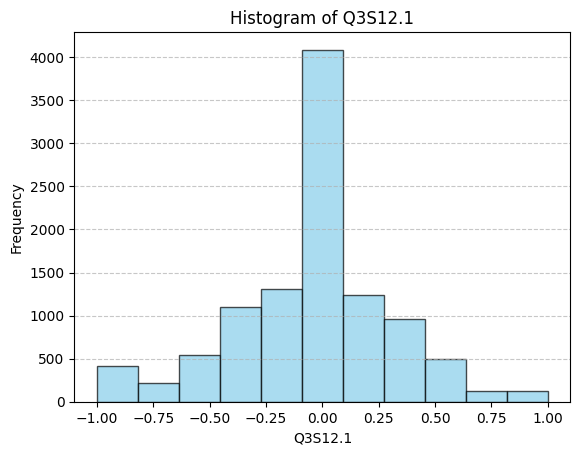

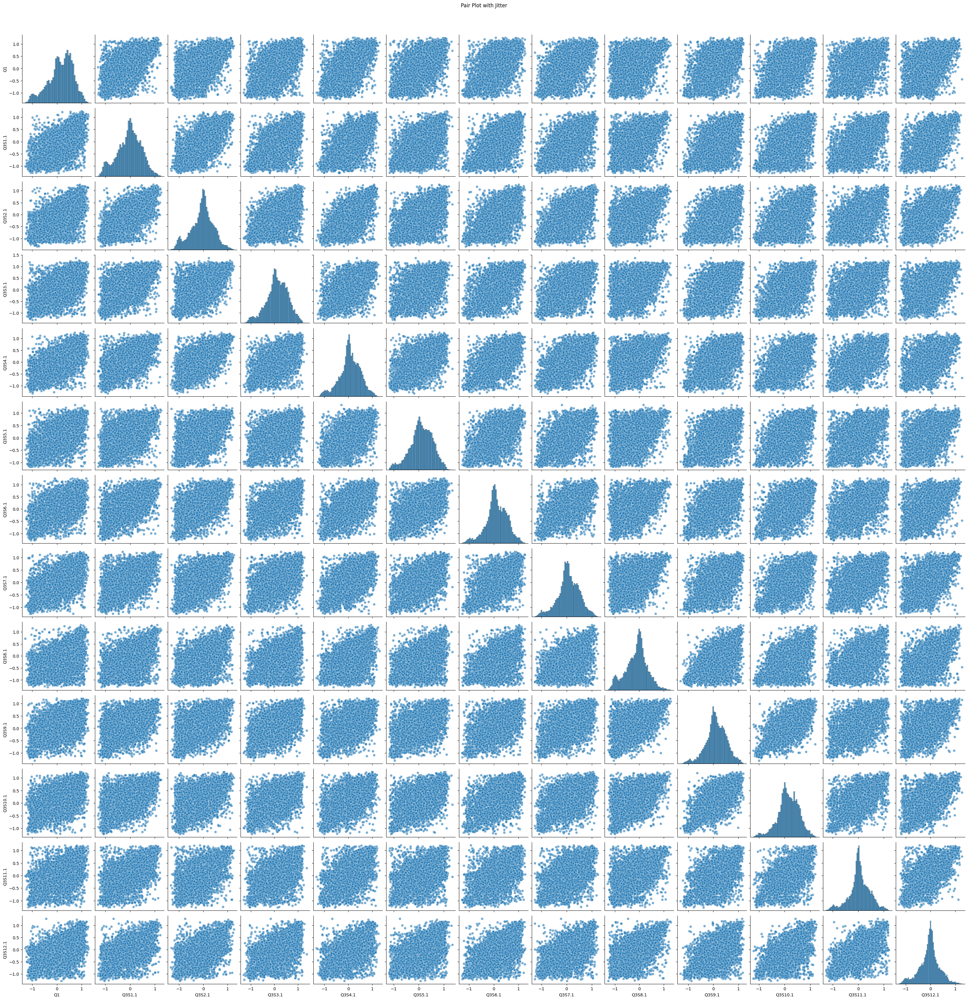

In [80]:
# --- ヒストグラムのプロット ---
for column in pickdata.columns:
    plt.hist(pickdata[column], bins=11, alpha=0.7, color='skyblue', edgecolor='black')
    plt.title(f"Histogram of {column}")
    plt.xlabel(column)
    plt.ylabel("Frequency")
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

# --- ペアプロットのプロット ---
# x1, x2, ..., y 全ての変数をプロット
# sns.pairplot(pickdata, diag_kind="hist", corner=False)
# plt.suptitle("Pair Plot of Variables", y=1.02)
# plt.show()

# ジッターを加える
pickdata_jittered = pickdata + np.random.normal(0, 0.1, pickdata.shape)

sns.pairplot(pickdata_jittered, diag_kind="hist", corner=False, plot_kws={"alpha": 0.6})
plt.suptitle("Pair Plot with Jitter", y=1.02)
plt.show()

# Use only Fin data

## make model

In [ ]:
# Stanモデルのコード
stan_model_code = """
data {
  int<lower=1> N;  // サンプル数
  int<lower=1> K_fin;  // 説明変数の数
  int<lower=1> K_health;  // 説明変数の数
  matrix[N, K_fin] X_fin;  // 説明変数
  matrix[N, K_health] X_health;  // 説明変数
  array[N] int<lower=0, upper=12> y;  // 目的変数
}

transformed data {
  ordered[10] tau = to_vector({1.5,2.5,3.5,4.5,5.5,6.5,7.5,8.5,9.5,10.5});  // 固定された閾値
}

parameters {
  real alpha;  // 切片
  real f1; // f1からの係数
  vector<lower=0>[K_fin] beta_fin;  // 因子負荷量（変数1）
  vector<lower=0>[K_health] beta_health;  // 因子負荷量（変数1）
  vector<lower=0>[2] beta;  // 重回帰分析
  vector[N] nu_fin;                // 潜在因子
  vector[N] nu_health;                // 潜在因子
  real<lower=0.1> sigma;
}

model {
  // 潜在因子の事前分布
  nu_fin ~ std_normal();           // 標準正規分布
  mu_health ~ std_normal();

  vector[N] z;

  // 因子負荷量の事前分布
  beta_fin ~ normal(0.5,0.5);
  beta_health ~ normal(0.5,0.5);
  beta ~ normal(0.5,0.5);

  for (k in 1:K_fin){
    X_fin[,k] ~ normal(beta_fin[k] * nu_fin, sigma);
  }

  for (k in 1:K_health){
    X_health[,k] ~ normal(beta_health[k] * nu_health, sigma);
  }

  z = beta[1]* nu_fin + beta[2]* nu_health + alpha; 
  
  // 観測データ y を ordered_logistic 分布でモデル化
  y ~ ordered_logistic(z, tau);
}

generated quantities {
  vector[N] z;             // 潜在スコア（線形予測子）
  array[N] int y_pred_step; // 予測されたカテゴリ
  
  for (n in 1:N) {
    // 潜在スコア z の計算
    z[n] = alpha + dot_product(X[n], beta);

    // y_pred_step を ordered_logistic_rng を用いて生成
    y_pred_step[n] = ordered_logistic_rng(z[n], tau);
  }
}
"""

stan_model_path = "./model/bayesian_sem_orderedprobit.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_model_code)

# Stanモデルのコンパイル
stan_model = CmdStanModel(stan_file=stan_model_path)

In [148]:
stan_model_code = """data {
  int<lower=1> N;  // サンプル数
  int<lower=1> K_fin;  // 経済要因の説明変数の数
  int<lower=1> K_health;  // 健康要因の説明変数の数
  matrix[N, K_fin] X_fin;  // 経済要因の説明変数
  matrix[N, K_health] X_health;  // 健康要因の説明変数
  array[N] int<lower=1, upper=11> y;  // 目的変数（1から11のカテゴリ）
}

transformed data {
  ordered[10] tau = to_vector({1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5, 10.5});  // 固定された閾値
}

parameters {
  real alpha;  // 切片
  vector<lower=0>[K_fin] beta_fin;  // 経済要因の因子負荷量
  vector<lower=0>[K_health] beta_health;  // 健康要因の因子負荷量
  vector[N] nu_fin;  // 経済要因の潜在因子
  vector[N] nu_health;  // 健康要因の潜在因子
  real nu_beta_fin;
  real nu_alpha_fin;
  real nu_beta_health;
  real nu_alpha_health;
  real<lower=0.1> sigma_fin;
  real<lower=0.1> sigma_health;
}

model {
  vector[N] z_fin;
  vector[N] z_health;

  // 潜在因子の事前分布
  nu_fin ~ normal(0, 1);  // 経済要因は標準正規分布
  nu_health ~ normal(0, 1);  // 健康要因も標準正規分布

  // 因子負荷量の事前分布
  beta_fin ~ normal(0.5, 0.5);
  beta_health ~ normal(0.5, 0.5);

  // 経済要因の説明変数をモデル化
  for (k in 1:K_fin) {
    X_fin[, k] ~ normal(beta_fin[k] * nu_fin, sigma_fin);
  }

  // 健康要因の説明変数をモデル化
  for (k in 1:K_health) {
    X_health[, k] ~ normal(beta_health[k] * nu_health, sigma_health);
  }

  // 潜在因子の線形結合
  z_fin = nu_fin * nu_beta_fin + nu_alpha_fin;
  z_health = nu_health * nu_beta_health + nu_alpha_health;

  // 観測データ y を ordered_logistic 分布でモデル化
  y ~ ordered_logistic(alpha + z_fin + z_health, tau);
}

generated quantities {
  array[N] real y_pred;  // 予測されたカテゴリ
  for (n in 1:N) {
    y_pred[n] = alpha + nu_fin[n] * nu_beta_fin + nu_alpha_fin + nu_health[n] * nu_beta_health + nu_alpha_health;
  }
}
"""

stan_model_path = "./model/bayesian_sem_orderedprobit.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_model_code)

# Stanモデルのコンパイル
stan_model = CmdStanModel(stan_file=stan_model_path)

17:32:36 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_orderedprobit.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_orderedprobit
17:32:48 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_orderedprobit


In [149]:
num_cpu = multiprocessing.cpu_count()

# データをStanに渡す形式に変換
data_list = {
    'N': len(raw_data),
    'K_fin': 3,  # 説明変数の数
    'K_health': 2,  # 説明変数の数
    'X_fin': raw_data[["Q3S1.1", "Q3S2.1", "Q3S3.1"]].values,  # 説明変数
    'X_health': raw_data[["Q3S4.1", "Q3S5.1"]].values,  # 説明変数
    'y': raw_data['Q1'].values  # 目的変数
}

# モデルのサンプリング
fit = stan_model.sample(
    data=data_list,
    seed=42,
    # inits= init_values,
    iter_warmup=1000, 
    iter_sampling=200, 
    chains=4,
    thin = 1,
    parallel_chains=num_cpu, # 並列数,
    output_dir="./output",
    show_console=True)

17:34:18 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
17:34:19 - cmdstanpy - INFO - Chain [1] start processing
17:34:19 - cmdstanpy - INFO - Chain [2] start processing
17:34:19 - cmdstanpy - INFO - Chain [3] start processing
17:34:19 - cmdstanpy - INFO - Chain [4] start processing


Chain [1] method = sample (Default)
Chain [1] sample
Chain [1] num_samples = 200
Chain [1] num_warmup = 1000 (Default)
Chain [1] save_warmup = false (Default)
Chain [1] thin = 1 (Default)
Chain [1] adapt
Chain [1] engaged = true (Default)
Chain [1] gamma = 0.05 (Default)
Chain [1] delta = 0.8 (Default)
Chain [1] kappa = 0.75 (Default)
Chain [1] t0 = 10 (Default)
Chain [1] init_buffer = 75 (Default)
Chain [1] term_buffer = 50 (Default)
Chain [1] window = 25 (Default)
Chain [1] save_metric = false (Default)
Chain [1] algorithm = hmc (Default)
Chain [1] hmc
Chain [1] engine = nuts (Default)
Chain [1] nuts
Chain [1] max_depth = 10 (Default)
Chain [1] metric = diag_e (Default)
Chain [1] metric_file =  (Default)
Chain [1] stepsize = 1 (Default)
Chain [1] stepsize_jitter = 0 (Default)
Chain [1] num_chains = 1 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /var/folders/l3/m4gqq46s65j7ryscv8skvykw0000gn/T/tmpwv9oywc6/s40kwyuw.json
Chain [1] init = 2 (Default)
Chain [1] ran

20:44:58 - cmdstanpy - INFO - Chain [2] done processing


Chain [2] 
Chain [2] Elapsed Time: 1853.32 seconds (Warm-up)
Chain [2] 9585.4 seconds (Sampling)
Chain [2] 11438.7 seconds (Total)
Chain [2] 
Chain [2] 
Chain [3] Iteration: 1200 / 1200 [100%]  (Sampling)


21:28:07 - cmdstanpy - INFO - Chain [3] done processing


Chain [3] 
Chain [3] Elapsed Time: 1932.18 seconds (Warm-up)
Chain [3] 12096 seconds (Sampling)
Chain [3] 14028.2 seconds (Total)
Chain [3] 
Chain [3] 
Chain [1] Iteration: 1200 / 1200 [100%]  (Sampling)


21:45:02 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] 
Chain [1] Elapsed Time: 1936.87 seconds (Warm-up)
Chain [1] 13106.5 seconds (Sampling)
Chain [1] 15043.4 seconds (Total)
Chain [1] 
Chain [1] 
Chain [4] Iteration: 1200 / 1200 [100%]  (Sampling)


22:27:45 - cmdstanpy - INFO - Chain [4] done processing


Chain [4] 
Chain [4] Elapsed Time: 2955.89 seconds (Warm-up)
Chain [4] 14649.8 seconds (Sampling)
Chain [4] 17605.7 seconds (Total)
Chain [4] 
Chain [4] 
Chain [4] 
Chain [4] 


22:27:45 - cmdstanpy - WARNING - Some chains may have failed to converge.
	Chain 1 had 200 iterations at max treedepth (100.0%)
	Chain 2 had 200 iterations at max treedepth (100.0%)
	Chain 3 had 200 iterations at max treedepth (100.0%)
	Chain 4 had 200 iterations at max treedepth (100.0%)
	Use the "diagnose()" method on the CmdStanMCMC object to see further information.


In [147]:
# Stanモデルのコード
stan_model_code = """
data {
  int<lower=1> N;  // サンプル数
  int<lower=1> K;  // 説明変数の数
  matrix[N, K] X;  // 説明変数
  array[N] int<lower=1, upper=11> y;  // 目的変数（1から11のカテゴリ）
}

transformed data {
  ordered[10] tau = to_vector({1.5,2.5,3.5,4.5,5.5,6.5,7.5,8.5,9.5,10.5});  // 固定された閾値
}

parameters {
  real alpha;  // 切片
  real f1; // f1からの係数
  vector<lower=0>[K] beta;  // 因子負荷量（変数1）
  vector<lower=0,upper=1>[N] nu;                // 潜在因子
  real nu_beta;
  real nu_alpha;
  real<lower=0.1> sigma;
}

model {
  // 潜在因子の事前分布
  nu ~ std_normal();           // 標準正規分布
  vector[N] z;

  // 因子負荷量の事前分布
  beta ~ normal(0.5,0.5);

  for (k in 1:K){
    X[,k] ~ normal(beta[k] * nu, sigma);
  }
  
  z = nu * nu_beta + nu_alpha;

  // 観測データ y を ordered_logistic 分布でモデル化
  y ~ ordered_logistic(nu * nu_beta + nu_alpha, tau);
}

generated quantities {
  array[N] real y_pred; // 予測されたカテゴリ  
  y_pred = nu * nu_beta + nu_alpha;
}
"""

stan_model_path = "./model/bayesian_sem_orderedprobit.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_model_code)

# Stanモデルのコンパイル
stan_model = CmdStanModel(stan_file=stan_model_path)

ValueError: Failed to get source info for Stan model '/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_orderedprobit.stan'. Console:
Semantic error in '/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_orderedprobit.stan', line 43, column 2 to column 8:
   -------------------------------------------------
    41:  generated quantities {
    42:    array[N] real y_pred; // 予測されたカテゴリ  
    43:    y_pred = nu * nu_beta + nu_alpha;
           ^
    44:  }
   -------------------------------------------------

Ill-typed arguments supplied to assignment operator =:
The left hand side has type
  array[] real
and the right hand side has type
  vector


In [115]:
num_cpu = multiprocessing.cpu_count()

# データをStanに渡す形式に変換
data_list = {
    'N': len(raw_data),
    'K': 3,  # 説明変数の数
    'X': raw_data[["Q3S1.1", "Q3S2.1", "Q3S3.1"]].values,  # 説明変数
    'y': raw_data['Q1'].values  # 目的変数
}

# モデルのサンプリング
fit = stan_model.sample(
    data=data_list,
    seed=42,
    # inits= init_values,
    iter_warmup=1000, 
    iter_sampling=200, 
    chains=4,
    thin = 1,
    parallel_chains=num_cpu, # 並列数,
    output_dir="./output",
    show_console=True)

15:59:21 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
15:59:22 - cmdstanpy - INFO - Chain [1] start processing
15:59:22 - cmdstanpy - INFO - Chain [2] start processing
15:59:22 - cmdstanpy - INFO - Chain [3] start processing
15:59:22 - cmdstanpy - INFO - Chain [4] start processing


Chain [1] method = sample (Default)
Chain [1] sample
Chain [1] num_samples = 200
Chain [1] num_warmup = 1000 (Default)
Chain [1] save_warmup = false (Default)
Chain [1] thin = 1 (Default)
Chain [1] adapt
Chain [1] engaged = true (Default)
Chain [1] gamma = 0.05 (Default)
Chain [1] delta = 0.8 (Default)
Chain [1] kappa = 0.75 (Default)
Chain [1] t0 = 10 (Default)
Chain [1] init_buffer = 75 (Default)
Chain [1] term_buffer = 50 (Default)
Chain [1] window = 25 (Default)
Chain [1] save_metric = false (Default)
Chain [1] algorithm = hmc (Default)
Chain [1] hmc
Chain [1] engine = nuts (Default)
Chain [2] method = sample (Default)
Chain [2] sample
Chain [2] num_samples = 200
Chain [2] num_warmup = 1000 (Default)
Chain [2] save_warmup = false (Default)
Chain [2] thin = 1 (Default)
Chain [2] adapt
Chain [2] engaged = true (Default)
Chain [1] nuts
Chain [1] max_depth = 10 (Default)
Chain [1] metric = diag_e (Default)
Chain [1] metric_file =  (Default)
Chain [1] stepsize = 1 (Default)
Chain [1] st

16:03:00 - cmdstanpy - INFO - Chain [3] done processing


Chain [3] Iteration: 1200 / 1200 [100%]  (Sampling)
Chain [3] 
Chain [3] Elapsed Time: 205.025 seconds (Warm-up)
Chain [3] 12.881 seconds (Sampling)
Chain [3] 217.906 seconds (Total)
Chain [3] 
Chain [3] 
Chain [3] 
Chain [3] 
Chain [1] Iteration: 1100 / 1200 [ 91%]  (Sampling)
Chain [2] Iteration: 1000 / 1200 [ 83%]  (Warmup)
Chain [2] Iteration: 1001 / 1200 [ 83%]  (Sampling)
Chain [4] Iteration: 1100 / 1200 [ 91%]  (Sampling)


16:03:06 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] Iteration: 1200 / 1200 [100%]  (Sampling)
Chain [1] 
Chain [1] Elapsed Time: 211.695 seconds (Warm-up)
Chain [1] 13.058 seconds (Sampling)
Chain [1] 224.753 seconds (Total)
Chain [1] 
Chain [1] 
Chain [2] Iteration: 1100 / 1200 [ 91%]  (Sampling)


16:03:11 - cmdstanpy - INFO - Chain [4] done processing


Chain [4] Iteration: 1200 / 1200 [100%]  (Sampling)
Chain [4] 
Chain [4] Elapsed Time: 216.219 seconds (Warm-up)
Chain [4] 12.638 seconds (Sampling)
Chain [4] 228.857 seconds (Total)
Chain [4] 
Chain [4] 


16:03:17 - cmdstanpy - INFO - Chain [2] done processing
16:03:17 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: normal_lpdf: Location parameter[1] is inf, but must be finite! (in 'bayesian_sem_orderedprobit.stan', line 32, column 4 to column 40)
	Exception: normal_lpdf: Location parameter[1] is inf, but must be finite! (in 'bayesian_sem_orderedprobit.stan', line 32, column 4 to column 40)
	Exception: normal_lpdf: Location parameter[1] is inf, but must be finite! (in 'bayesian_sem_orderedprobit.stan', line 32, column 4 to column 40)
	Exception: normal_lpdf: Location parameter[1] is inf, but must be finite! (in 'bayesian_sem_orderedprobit.stan', line 32, column 4 to column 40)
	Exception: normal_lpdf: Location parameter[1] is inf, but must be finite! (in 'bayesian_sem_orderedprobit.stan', line 32, column 4 to column 40)
	Exception: normal_lpdf: Location parameter[1] is inf, but must be finite! (in 'bayesian_sem_orderedprobit.stan', line 32, column 4 to column 40)
	Ex

Chain [2] Iteration: 1200 / 1200 [100%]  (Sampling)
Chain [2] 
Chain [2] Elapsed Time: 222.057 seconds (Warm-up)
Chain [2] 12.906 seconds (Sampling)
Chain [2] 234.963 seconds (Total)
Chain [2] 
Chain [2] 
Chain [2] 


In [152]:
# 結果が収束しているかどうかの確認をしている。
cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    posterior_predictive="y_pred",
    log_likelihood="lp__",
    # observed_data = {"y":data["y"]}
)

# トレースプロットの作成


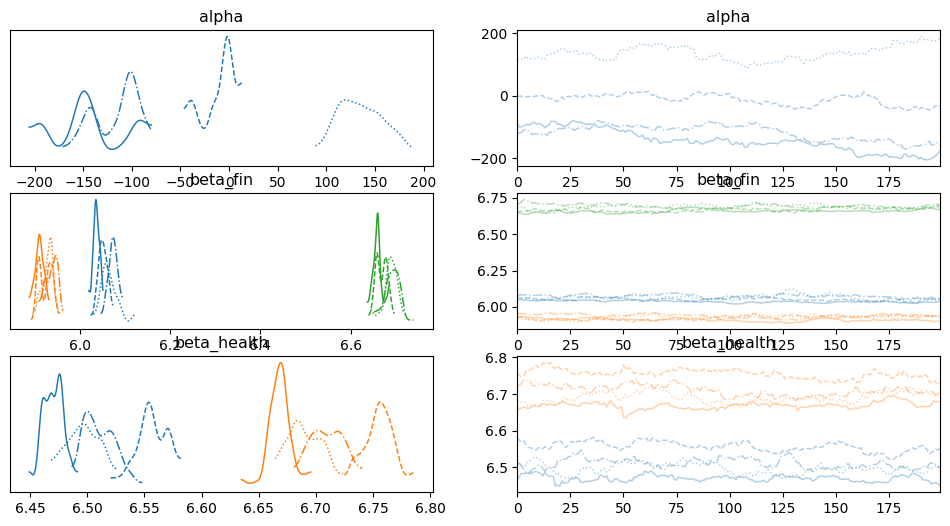

In [154]:
az.plot_trace(cmdstanpy_data,var_names=["alpha","beta_fin","beta_health"])
plt.show()

array([[<Axes: title={'center': 'lp__'}>,
        <Axes: title={'center': 'lp__'}>]], dtype=object)

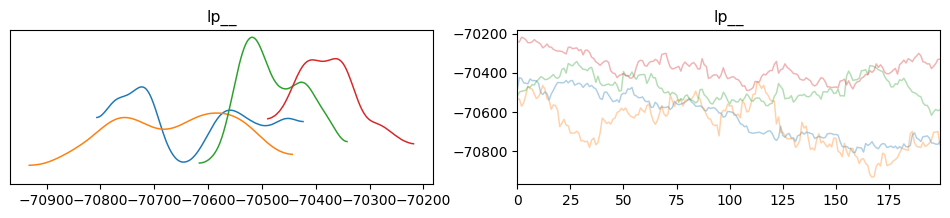

In [155]:
# # トレースプロットの作成
ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False)

In [104]:
raw_data["Q1"]

0        6
1        7
2        5
3        9
4        8
        ..
10614    1
10615    3
10616    9
10617    3
10618    2
Name: Q1, Length: 10619, dtype: int64

In [108]:
df_summary = fit.summary()
df_summary = df_summary.loc[df_summary.index.str.contains("beta"), :]

In [111]:
df_summary = fit.summary()
df_summary = df_summary.loc[df_summary.index.str.contains("nu"), :]

In [112]:
df_summary

,Mean,MCSE,StdDev,5%,50%,95%,N_Eff,N_Eff/s,R_hat
nu[1],1.441630,0.004772,0.192687,1.115210,1.443690,1.76440,1630.65,52.3166,0.995888
nu[2],1.678280,0.004648,0.175715,1.401360,1.672680,1.96634,1429.13,45.8509,0.997560
nu[3],0.986756,0.004858,0.174201,0.707695,0.985617,1.27427,1285.87,41.2547,0.998471
nu[4],2.322660,0.005138,0.180929,2.018060,2.324870,2.62460,1239.79,39.7765,0.996176
nu[5],1.916530,0.005097,0.184451,1.628740,1.918360,2.23208,1309.72,42.0199,0.999151
...,...,...,...,...,...,...,...,...,...
nu[10615],1.013920,0.004849,0.182927,0.714625,1.018560,1.30835,1423.18,45.6600,0.999334
nu[10616],1.109780,0.005312,0.187298,0.793922,1.115380,1.41998,1243.13,39.8834,0.998008
nu[10617],1.450350,0.005444,0.188528,1.131090,1.452770,1.76297,1199.20,38.4743,1.001160
nu[10618],0.918163,0.004476,0.179652,0.617891,0.911807,1.21150,1610.90,51.6829,0.996477


In [121]:
df_summary = fit.summary()
df_summary = df_summary.loc[df_summary.index.str.contains("z"), :]
df_summary = df_summary.reset_index()  # インデックスをリセット
df_summary["y_act"] = raw_data["Q1"].values  # インデックスを無視して直接代入
df_summary

,index,Mean,MCSE,StdDev,5%,50%,95%,N_Eff,N_Eff/s,R_hat,y_act
0,z[1],6.60023,0.022294,0.678908,5.49005,6.61189,7.75051,927.386,18.0134,1.001880,6
1,z[2],7.51013,0.020785,0.671062,6.38073,7.49056,8.60372,1042.370,20.2469,0.998924,7
2,z[3],4.92369,0.019610,0.640093,3.84394,4.93365,5.92809,1065.440,20.6950,1.003620,5
3,z[4],9.71200,0.019016,0.501189,8.72291,9.77377,10.35590,694.666,13.4931,0.997813,9
4,z[5],8.49384,0.025685,0.703833,7.32189,8.50291,9.62277,750.883,14.5851,0.997736,8
...,...,...,...,...,...,...,...,...,...,...,...
10614,z[10615],4.71282,0.022954,0.675007,3.56877,4.75687,5.78919,864.792,16.7976,0.996540,1
10615,z[10616],5.04243,0.023203,0.659751,3.96491,5.03111,6.15427,808.519,15.7046,0.998788,3
10616,z[10617],7.06435,0.022148,0.646811,6.01089,7.08296,8.11874,852.891,16.5665,1.000080,9
10617,z[10618],4.32232,0.022846,0.674510,3.23237,4.30549,5.42680,871.660,16.9310,0.997064,3


In [122]:
def plot_yy(y_act, y_pred, err_lower,err_upper, min_value=None,max_value=None):
    if min_value == None: min_value = min(y_act) - np.abs(min(y_act)*0.3)
    if max_value == None: max_value = max(y_act) + np.abs(max(y_act)*0.3)
    
    plt.figure(figsize=(5, 5))
    plt.plot([min_value, max_value], [min_value, max_value], c="lightgray")
    plt.scatter(y_act, y_pred)
    plt.errorbar(y_act, y_pred, yerr=[err_lower, err_upper], fmt="o")
    plt.xlim([min_value, max_value])
    plt.ylim([min_value, max_value])
    plt.xlabel("y_actual")
    plt.ylabel("y_pred")
    plt.show()

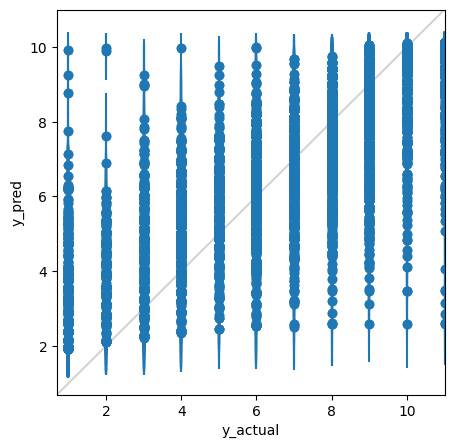

In [123]:
plot_yy(y_act=df_summary["y_act"], y_pred=df_summary["Mean"], err_lower=df_summary["Mean"]-df_summary["5%"], err_upper=-df_summary["Mean"]+df_summary["95%"],max_value = 11)

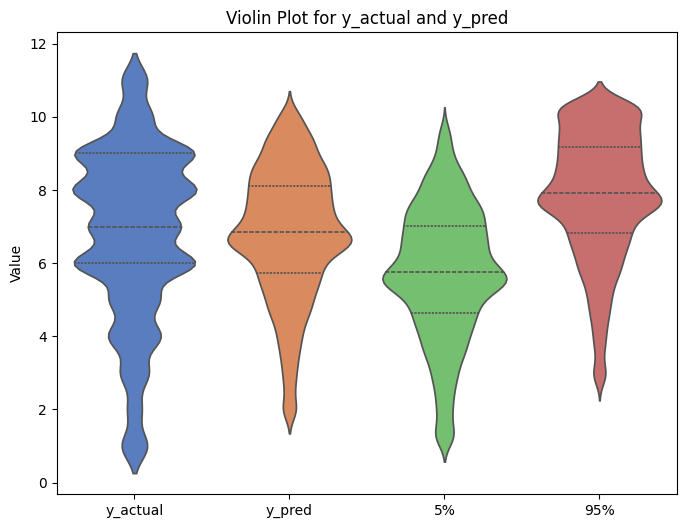

In [129]:
import seaborn as sns
import matplotlib.pyplot as plt

# バイオリンプロットを描画
plt.figure(figsize=(8, 6))

# y_act と y_pred の分布をプロット（2つのカテゴリで分けて表示）
sns.violinplot(data=[df_summary["y_act"], df_summary["Mean"], df_summary["5%"], df_summary["95%"]], inner="quart", palette="muted")

# ラベルの設定
plt.xticks([0, 1,2,3], ['y_actual', 'y_pred',"5%","95%"], rotation=0)
plt.ylabel("Value")
plt.title("Violin Plot for y_actual and y_pred")

# 表示
plt.show()


In [140]:
df_1 = df_summary[df_summary["y_act"]==1]["Mean"].copy()
df_2 = df_summary[df_summary["y_act"]==2]["Mean"].copy()
df_3 = df_summary[df_summary["y_act"]==3]["Mean"].copy()
df_4 = df_summary[df_summary["y_act"]==4]["Mean"].copy()


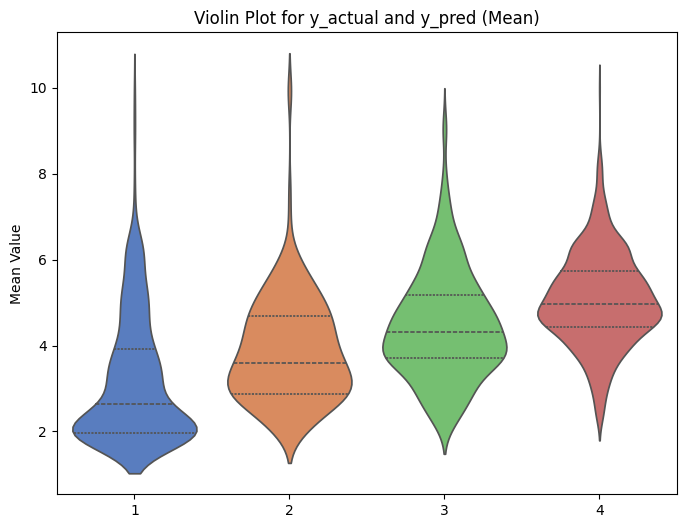

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# サンプルデータ（y_act が 1, 2, 3, 4 の値に対応する）
# データ行数が異なる場合でも問題ありません
plt.figure(figsize=(8, 6))

# バイオリンプロットの作成
sns.violinplot(data=[
    df_1.values,
    df_2.values,
    df_3.values,
    df_4.values
], inner="quart", palette="muted"
,color=["red","green","gray","blue"])

# x軸のラベル
plt.xticks([0, 1, 2, 3], ['1', '2', '3', '4'], rotation=0)

# y軸ラベルとタイトル
plt.ylabel("Mean Value")
plt.title("Violin Plot for y_actual and y_pred (Mean)")
plt.color
# 表示
plt.show()


In [7]:
stan_code = """
data {
    int<lower=0> N;              // サンプル数
    int<lower=0> K_fin;          // fFinanceの観測変数数
    matrix[N, K_fin] Q_fin;      // fFinance関連の観測変数
    array[N] int<lower = 1, upper = 11> Q1;                // 目的変数
}

transformed data {
    ordered[10] tau = to_vector({1.5, 2.5, 3.5, 4.5,5.5, 6.5, 7.5, 8.5,9.5, 10.5});  // 固定された閾値
}

parameters {
    vector[N] fFinance;          // 潜在変数 fFinance
    vector[K_fin] lambda_fin;    // 観測変数の回帰係数（因子負荷量）
    real beta_fin;               // 潜在変数と目的変数の回帰係数
    real<lower=0> sigma_param;   // 観測変数の誤差項
    real<lower=0> sigma_Q1;      // 目的変数の誤差項
}

model {
    vector[N] z;
    // 観測変数のモデル
    for (k in 1:K_fin)
        Q_fin[, k] ~ normal(lambda_fin[k] * fFinance, sigma_param);

    // 目的変数のモデル
    z = beta_fin * fFinance;
    Q1 ~ ordered_logistic(z, tau);

    // 弱い事前分布
    lambda_fin ~ normal(0, 1);
    beta_fin ~ normal(0, 1);
    sigma_param ~ exponential(1);
    //sigma_Q1 ~ exponential(1);
}

generated quantities {
    vector[N] mu;                // 潜在スコア（線形予測子）
    vector[N] y_pred;            // 目的変数の予測値
    vector[N] log_lik;           // 対数尤度

    for (n in 1:N) {
        // 潜在変数を用いた線形予測子
        mu[n] = beta_fin * fFinance[n];

        // 対数尤度
        log_lik[n] = ordered_logistic_lpmf(Q1[n] | mu[n], tau);

        // 予測値の生成
        y_pred[n] = ordered_logistic_rng(mu[n], tau);
    }
}
"""

stan_model_path = "./model/bayesian_sem_fin.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_code)

In [ ]:
stan_code = """
data {
    int<lower=0> N;              // サンプル数
    int<lower=0> K_fin;          // fFinanceの観測変数数
    matrix[N, K_fin] Q_fin;      // fFinance関連の観測変数
    array[N] int<lower = 1, upper = 11> Q1;                // 目的変数
}

transformed data {
    ordered[10] tau = to_vector({1.5, 2.5, 3.5, 4.5,5.5, 6.5, 7.5, 8.5,9.5, 10.5});  // 固定された閾値
}

parameters {
    vector[N] fFinance;          // 潜在変数 fFinance
    vector[K_fin] lambda_fin;    // 観測変数の回帰係数（因子負荷量）
    real beta_fin;               // 潜在変数と目的変数の回帰係数
    real<lower=0> sigma_param;   // 観測変数の誤差項
    real<lower=0> sigma_Q1;      // 目的変数の誤差項
}

model {
    vector[N] z;
    // 観測変数のモデル
    for (k in 1:K_fin)
        Q_fin[, k] ~ normal(lambda_fin[k] * fFinance, sigma_param);

    // 目的変数のモデル
    z ~ normal(beta_fin * fFinance,sigma_Q1);
    Q1 ~ ordered_logistic(z, tau);

    // 弱い事前分布
    lambda_fin ~ normal(0, 1);
    beta_fin ~ normal(0, 1);
    sigma_param ~ exponential(1);
    sigma_Q1 ~ exponential(1);
}

generated quantities {
    vector[N] mu;                // 潜在スコア（線形予測子）
    vector[N] y_pred;            // 目的変数の予測値
    vector[N] log_lik;           // 対数尤度

    for (n in 1:N) {
        // 潜在変数を用いた線形予測子
        mu[n] = beta_fin * fFinance[n];

        // 対数尤度
        log_lik[n] = ordered_logistic_lpmf(Q1[n] | mu[n], tau);

        // 予測値の生成
        y_pred[n] = ordered_logistic_rng(mu[n], tau);
    }
}
"""

stan_model_path = "./model/bayesian_sem_fin.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_code)

In [8]:
# Stanモデルのコンパイル
stan_model = CmdStanModel(stan_file=stan_model_path)


14:05:00 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_fin.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_fin
14:05:11 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_fin


## prepaired data

In [9]:
# Define column mappings based on the lavaan structure
latent_variable_mapping = {
    "fEnvironment": ["Q3S9.1", "Q3S10.1"],
    "fFinance": ["Q3S1.1", "Q3S2.1", "Q3S3.1"],
    "fSocial": ["Q3S11.1", "Q3S12.1", "Q3S8.1"],
    "fCommunity": ["Q3S6.1", "Q3S7.1"],
    "fHealth": ["Q3S4.1", "Q3S5.1"]
}

# Extract relevant columns for each latent variable and target variable
stan_data = {
    "N": raw_data.shape[0],  # Number of samples
    # "K_env": len(latent_variable_mapping["fEnvironment"]),
    "K_fin": int(len(latent_variable_mapping["fFinance"])),
    # "K_soc": len(latent_variable_mapping["fSocial"]),
    # "K_com": len(latent_variable_mapping["fCommunity"]),
    # "K_health": len(latent_variable_mapping["fHealth"]),
    # "Q_env": raw_data[latent_variable_mapping["fEnvironment"]].to_numpy(),
    "Q_fin": raw_data[latent_variable_mapping["fFinance"]].to_numpy(),
    # "Q_soc": raw_data[latent_variable_mapping["fSocial"]].to_numpy(),
    # "Q_com": raw_data[latent_variable_mapping["fCommunity"]].to_numpy(),
    # "Q_health": raw_data[latent_variable_mapping["fHealth"]].to_numpy(),
    "Q1": raw_data["Q1"].to_numpy()  # Target variable
}


In [10]:
num_cpu = multiprocessing.cpu_count()

# モデルのフィッティング
fit = stan_model.sample(
    data=stan_data,
    chains=4,
    seed=1,
    iter_warmup=500,
    iter_sampling=2000,
    parallel_chains=num_cpu, # 並列数,
    save_warmup=False,
    thin=1,
    output_dir="./output/",
    show_progress=True,
    show_console=True  # コンソール出力を表示
)

14:06:06 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
14:06:08 - cmdstanpy - INFO - Chain [1] start processing
14:06:08 - cmdstanpy - INFO - Chain [2] start processing
14:06:08 - cmdstanpy - INFO - Chain [3] start processing
14:06:08 - cmdstanpy - INFO - Chain [4] start processing


Chain [1] method = sample (Default)
Chain [1] sample
Chain [1] num_samples = 2000
Chain [1] num_warmup = 500
Chain [1] save_warmup = false (Default)
Chain [1] thin = 1 (Default)
Chain [1] adapt
Chain [1] engaged = true (Default)
Chain [1] gamma = 0.05 (Default)
Chain [1] delta = 0.8 (Default)
Chain [1] kappa = 0.75 (Default)
Chain [1] t0 = 10 (Default)
Chain [1] init_buffer = 75 (Default)
Chain [1] term_buffer = 50 (Default)
Chain [1] window = 25 (Default)
Chain [1] save_metric = false (Default)
Chain [1] algorithm = hmc (Default)
Chain [1] hmc
Chain [1] engine = nuts (Default)
Chain [1] nuts
Chain [1] max_depth = 10 (Default)
Chain [1] metric = diag_e (Default)
Chain [1] metric_file =  (Default)
Chain [1] stepsize = 1 (Default)
Chain [1] stepsize_jitter = 0 (Default)
Chain [1] num_chains = 1 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /var/folders/l3/m4gqq46s65j7ryscv8skvykw0000gn/T/tmpxy_mx2jp/krapkepa.json
Chain [1] init = 2 (Default)
Chain [1] random
Chain 

14:09:40 - cmdstanpy - INFO - Chain [3] done processing


Chain [3] Iteration: 2500 / 2500 [100%]  (Sampling)
Chain [3] 
Chain [3] Elapsed Time: 133.569 seconds (Warm-up)
Chain [3] 78.838 seconds (Sampling)
Chain [3] 212.407 seconds (Total)
Chain [3] 
Chain [3] 
Chain [4] Iteration: 2400 / 2500 [ 96%]  (Sampling)
Chain [2] Iteration: 2300 / 2500 [ 92%]  (Sampling)


14:09:44 - cmdstanpy - INFO - Chain [4] done processing


Chain [1] Iteration: 1500 / 2500 [ 60%]  (Sampling)
Chain [4] Iteration: 2500 / 2500 [100%]  (Sampling)
Chain [4] 
Chain [4] Elapsed Time: 137.666 seconds (Warm-up)
Chain [4] 78.684 seconds (Sampling)
Chain [4] 216.35 seconds (Total)
Chain [4] 
Chain [4] 
Chain [2] Iteration: 2400 / 2500 [ 96%]  (Sampling)
Chain [1] Iteration: 1600 / 2500 [ 64%]  (Sampling)


14:09:49 - cmdstanpy - INFO - Chain [2] done processing


Chain [2] Iteration: 2500 / 2500 [100%]  (Sampling)
Chain [2] 
Chain [2] Elapsed Time: 121.855 seconds (Warm-up)
Chain [2] 99.476 seconds (Sampling)
Chain [2] 221.331 seconds (Total)
Chain [2] 
Chain [2] 
Chain [1] Iteration: 1700 / 2500 [ 68%]  (Sampling)
Chain [1] Iteration: 1800 / 2500 [ 72%]  (Sampling)
Chain [1] Iteration: 1900 / 2500 [ 76%]  (Sampling)
Chain [1] Iteration: 2000 / 2500 [ 80%]  (Sampling)
Chain [1] Iteration: 2100 / 2500 [ 84%]  (Sampling)
Chain [1] Iteration: 2200 / 2500 [ 88%]  (Sampling)
Chain [1] Iteration: 2300 / 2500 [ 92%]  (Sampling)
Chain [1] Iteration: 2400 / 2500 [ 96%]  (Sampling)


14:10:33 - cmdstanpy - INFO - Chain [1] done processing
14:10:33 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'bayesian_sem_fin.stan', line 25, column 8 to column 67)
	Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'bayesian_sem_fin.stan', line 25, column 8 to column 67)
Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'bayesian_sem_fin.stan', line 25, column 8 to column 67)
	Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'bayesian_sem_fin.stan', line 25, column 8 to column 67)


Chain [1] Iteration: 2500 / 2500 [100%]  (Sampling)
Chain [1] 
Chain [1] Elapsed Time: 170.228 seconds (Warm-up)
Chain [1] 95.057 seconds (Sampling)
Chain [1] 265.285 seconds (Total)
Chain [1] 
Chain [1] 


14:10:40 - cmdstanpy - WARNING - Some chains may have failed to converge.
	Chain 1 had 2000 divergent transitions (100.0%)
	Chain 2 had 2000 divergent transitions (100.0%)
	Chain 3 had 2000 divergent transitions (100.0%)
	Chain 4 had 2000 divergent transitions (100.0%)
	Use the "diagnose()" method on the CmdStanMCMC object to see further information.


array([[<Axes: title={'center': 'lp__'}>,
        <Axes: title={'center': 'lp__'}>]], dtype=object)

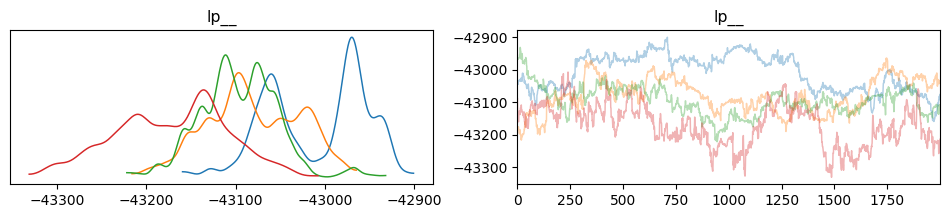

In [ ]:
# 結果が収束しているかどうかの確認をしている。
cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    posterior_predictive="y_pred",
    log_likelihood="lp__",
    # observed_data = {"y":data["y"]}
)

# トレースプロットの作成
az.plot_trace(cmdstanpy_data)
plt.show()

# cmdstanpy_data
ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False)
plt.show()

In [4]:
# 大体どのあたりに、meanがあるかの確認。
az.plot_posterior(cmdstanpy_data,var_names = ["fFinance"])

NameError: name 'cmdstanpy_data' is not defined

In [3]:
# トレースプロットの作成
az.plot_trace(cmdstanpy_data)
plt.show()

# cmdstanpy_data
ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False)
plt.show()

NameError: name 'cmdstanpy_data' is not defined

# HERE IS OVER.

In [ ]:
# stan モデリング部 (線形回帰モデルの例)
stan_code = """
data {
    int<lower=0> N;              // サンプル数
    int<lower=0> K_env;          // fEnvironmentの観測変数数
    int<lower=0> K_fin;          // fFinanceの観測変数数
    int<lower=0> K_soc;          // fSocialの観測変数数
    int<lower=0> K_com;          // fCommunityの観測変数数
    int<lower=0> K_health;       // fHealthの観測変数数

    matrix[N, K_env] Q_env;      // fEnvironment関連の観測変数
    matrix[N, K_fin] Q_fin;      // fFinance関連の観測変数
    matrix[N, K_soc] Q_soc;      // fSocial関連の観測変数
    matrix[N, K_com] Q_com;      // fCommunity関連の観測変数
    matrix[N, K_health] Q_health; // fHealth関連の観測変数

    vector[N] Q1;                // 目的変数
}

transformed data {
  ordered[10] tau = to_vector({-0.9, -0.7, -0.5, -0.3,-0.1, 0.1, 0.3, 0.5, 0.7, 0.9});  // 固定された閾値
}

parameters {
    vector[N] fEnvironment;  // 潜在変数 fEnvironment
    vector[N] fFinance;      // 潜在変数 fFinance
    vector[N] fSocial;       // 潜在変数 fSocial
    vector[N] fCommunity;    // 潜在変数 fCommunity
    vector[N] fHealth;       // 潜在変数 fHealth

    // 観測変数の回帰係数（因子負荷量）
    vector[K_env] lambda_env;
    vector[K_fin] lambda_fin;
    vector[K_soc] lambda_soc;
    vector[K_com] lambda_com;
    vector[K_health] lambda_health;

    // 潜在変数と目的変数の回帰係数
    real beta_env;
    real beta_fin;
    real beta_soc;
    real beta_com;
    real beta_health;

    // 観測変数の誤差項
    real<lower=0> sigma_param;
    real<lower=0> sigma_Q1;
}

model {
    // 観測変数のモデル
    for (k in 1:K_env)
        Q_env[, k] ~ normal(lambda_env[k] * fEnvironment, sigma_param);
    for (k in 1:K_fin)
        Q_fin[, k] ~ normal(lambda_fin[k] * fFinance, sigma_param);
    for (k in 1:K_soc)
        Q_soc[, k] ~ normal(lambda_soc[k] * fSocial, sigma_param);
    for (k in 1:K_com)
        Q_com[, k] ~ normal(lambda_com[k] * fCommunity, sigma_param);
    for (k in 1:K_health)
        Q_health[, k] ~ normal(lambda_health[k] * fHealth, sigma_param);

    // 目的変数のモデル

    // 潜在スコア z のモデル
    z = normal(alpha + beta_env * fEnvironment
              + beta_fin * fFinance
              + beta_soc * fSocial
              + beta_com * fCommunity
              + beta_health * fHealth);

    Q1 ~ ordered_logistic(z, tau);

    // 弱い事前分布
    lambda_env ~ normal(0, 1);
    lambda_fin ~ normal(0, 1);
    lambda_soc ~ normal(0, 1);
    lambda_com ~ normal(0, 1);
    lambda_health ~ normal(0, 1);
    beta_env ~ normal(0, 1);
    beta_fin ~ normal(0, 1);
    beta_soc ~ normal(0, 1);
    beta_com ~ normal(0, 1);
    beta_health ~ normal(0, 1);
    sigma_param ~ exponential(1);
    sigma_Q1 ~ exponential(1);
}

generated quantities {
    vector[N] mu;                // 潜在スコア（線形予測子）
    vector[N] y_pred;            // 目的変数の予測値
    vector[N] log_lik;           // 対数尤度

    for (n in 1:N) {
        // 潜在変数を用いた線形予測子
        mu[n] = beta_env * fEnvironment[n]
              + beta_fin * fFinance[n]
              + beta_soc * fSocial[n]
              + beta_com * fCommunity[n]
              + beta_health * fHealth[n];

        // 対数尤度
        log_lik[n] = normal_lpdf(Q1[n] | mu[n], sigma_Q1);

        // 予測値の生成
        y_pred[n] = normal_rng(mu[n], sigma_Q1);
        y_pred_step[n] = ordered_logistic_rng(mu[n], tau);
    }
}
"""

stan_model_path = "./model/bayesian_sem.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_code)


## test with small model

In [ ]:
# stan モデリング部 (線形回帰モデルの例)
stan_code = """
data {
    int<lower=0> N;              // サンプル数

    // fFinance関連の観測変数
    vector[N] Q_fin1;
    vector[N] Q_fin2;
    vector[N] Q_fin3;

    // fHealth関連の観測変数
    vector[N] Q_health1;
    vector[N] Q_health2;

    vector[N] Q1;                // 目的変数
}

parameters {
    vector[N] fFinance;          // 潜在変数 fFinance
    vector[N] fHealth;           // 潜在変数 fHealth

    // 観測変数の回帰係数（因子負荷量）
    real lambda_fin1;
    real lambda_fin2;
    real lambda_fin3;
    real lambda_health1;
    real lambda_health2;

    // 潜在変数と目的変数の回帰係数
    real beta_fin;
    real beta_health;

    // 誤差項
    real<lower=0> sigma_fa;
    real<lower=0> sigma_Q1;
}

model {
    // 観測変数のモデル
    Q_fin1 ~ normal(lambda_fin1 * fFinance, sigma_fa);
    Q_fin2 ~ normal(lambda_fin2 * fFinance, sigma_fa);
    Q_fin3 ~ normal(lambda_fin3 * fFinance, sigma_fa);
    Q_health1 ~ normal(lambda_health1 * fHealth, sigma_fa);
    Q_health2 ~ normal(lambda_health2 * fHealth, sigma_fa);

    // 目的変数のモデル
    Q1 ~ normal(beta_fin * fFinance
              + beta_health * fHealth,
              sigma_Q1);

    // 弱い事前分布
    lambda_fin1 ~ normal(0, 1);
    lambda_fin2 ~ normal(0, 1);
    lambda_fin3 ~ normal(0, 1);
    lambda_health1 ~ normal(0, 1);
    lambda_health2 ~ normal(0, 1);
    beta_fin ~ normal(0, 1);
    beta_health ~ normal(0, 1);
    sigma_fa ~ exponential(1);
    sigma_Q1 ~ exponential(1);
}

generated quantities {
    vector[N] mu;                // 潜在変数からの予測値
    vector[N] y_pred;            // 目的変数の予測値
    vector[N] log_lik;           // 対数尤度

    for (n in 1:N) {
        // 潜在変数を用いた線形予測子
        mu[n] = beta_fin * fFinance[n]
              + beta_health * fHealth[n];

        // 対数尤度
        log_lik[n] = normal_lpdf(Q1[n] | mu[n], sigma_Q1);

        // 予測値の生成
        y_pred[n] = normal_rng(mu[n], sigma_Q1);
    }
}
"""

stan_model_path = "./model/bayesian_sem_small.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_code)


## 順序ロジットテスト

In [33]:
# データの生成

np.random.seed(42)  # 再現性のための乱数の種

# サンプル数
N = 1000

# 説明変数をランダムに生成（1〜5の整数）
X1 = np.random.randint(1, 12, N)  # 美味しかった
X2 = np.random.randint(1, 12, N)  # 店内が綺麗だった
X3 = np.random.randint(1, 12, N)  # 接客が良かった
X4 = np.random.randint(1, 12, N)  # コストパフォーマンスが良かった

# 係数
beta1 = 0.8
beta2 = 0.2
beta3 = 0.3
beta4 = 0.6

# 潜在スコアzを計算（線形回帰式）
z = ((beta1 * X1 + beta2 * X2 + beta3 * X3 + beta4 * X4)-11)/1.3

# 潜在スコアzを基に目的変数y（1〜5のカテゴリ）を生成
# 閾値を定義
# tau = [-4,-3 -2, -1, 0, 1,2,3,4]  # 閾値（4つの閾値）
tau = [-5,-4,-3,-2,-1,-0,1,2,3,4]

# 目的変数yを生成
y = np.digitize(z, tau) + 1  # 1〜5の範囲に変換

# DataFrameにデータをまとめる
df = pd.DataFrame({
    'delicious': X1,
    'cleanriness': X2,
    'customer service': X3,
    'price': X4,
    'target': y,
    "z":z
})

# データの確認
print(df.head())

   delicious  cleanriness  customer service  price  target         z
0          7            7                 3      5       6 -0.076923
1          4            8                 5      5       5 -1.307692
2         11            3                 5      4       8  1.769231
3          8            6                 9      4       8  1.307692
4          5            1                10      1       4 -2.461538


(array([ 17.,  54.,  96., 157., 205., 172., 133.,  99.,  61.,   6.]),
 array([-6.53846154, -5.18461538, -3.83076923, -2.47692308, -1.12307692,
         0.23076923,  1.58461538,  2.93846154,  4.29230769,  5.64615385,
         7.        ]),
 <BarContainer object of 10 artists>)

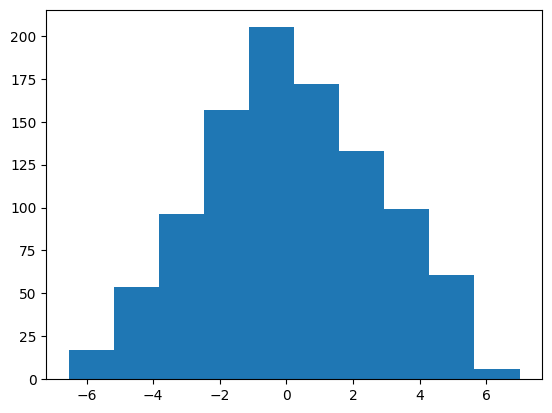

In [34]:
plt.hist(df["z"])

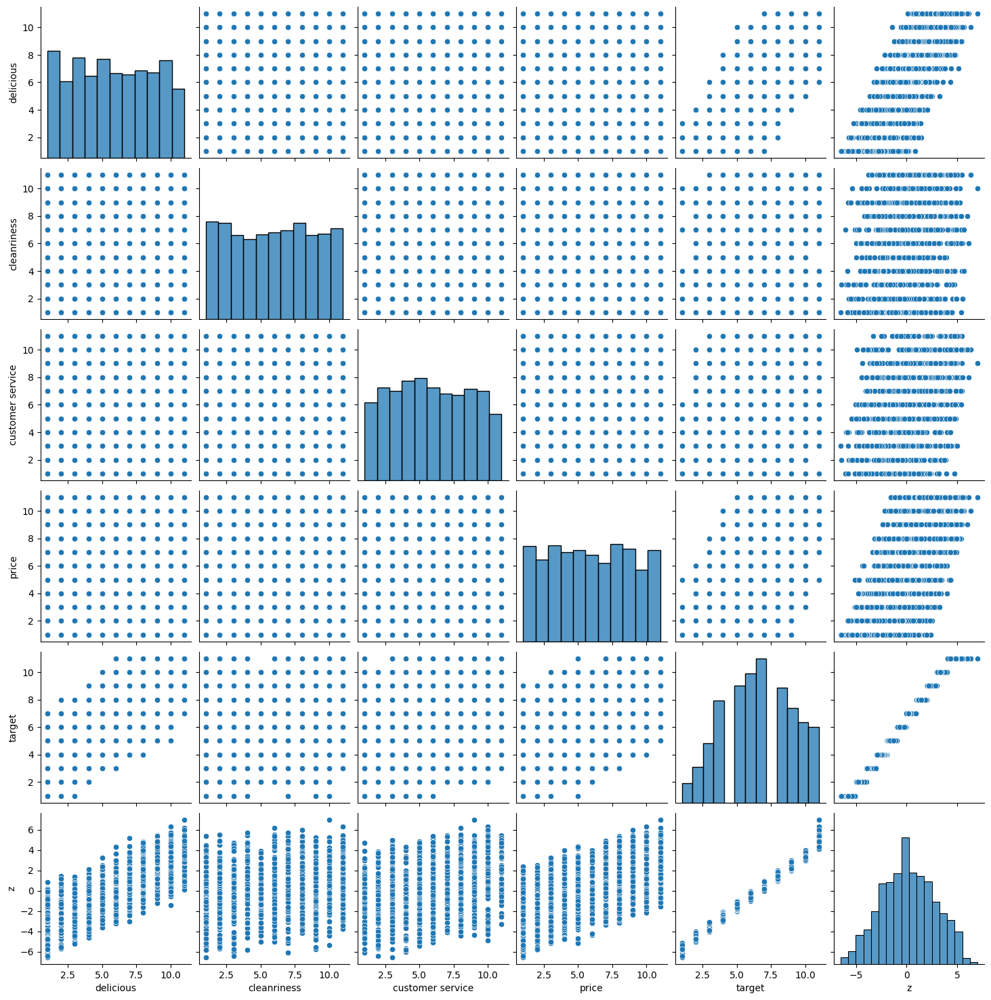

In [35]:
sns.pairplot(df)

In [36]:
# Stanモデルのコード
stan_model_code = """
data {
  int<lower=1> N;  // サンプル数
  int<lower=1> K;  // 説明変数の数
  matrix[N, K] X;  // 説明変数
  array[N] int<lower=0, upper=12> y;  // 目的変数
}

transformed data {
  ordered[10] tau = to_vector({-5,-4,-3,-2,-1,-0,1,2,3,4});  // 固定された閾値
}

parameters {
  real alpha;  // 切片
  vector[K] beta;  // 各説明変数の係数
}

model {
  vector[N] z;

  // 潜在スコア z のモデル
  z = alpha + X * beta;

  // 観測データ y を ordered_logistic 分布でモデル化
  y ~ ordered_logistic(z, tau);
}

generated quantities {
  vector[N] z;             // 潜在スコア（線形予測子）
  array[N] int y_pred_step; // 予測されたカテゴリ

  for (n in 1:N) {
    // 潜在スコア z の計算
    z[n] = alpha + dot_product(X[n], beta);

    // y_pred_step を ordered_logistic_rng を用いて生成
    y_pred_step[n] = ordered_logistic_rng(z[n], tau);
  }
}
"""

stan_model_path = "./model/bayesian_sem_orderedprobit.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_model_code)

# データをStanに渡す形式に変換
data_list = {
    'N': N,
    'K': 4,  # 説明変数の数
    'X': df[['delicious', 'cleanriness', 'customer service', 'price']].values,  # 説明変数
    'y': df['target'].values  # 目的変数
}

# Stanモデルのコンパイル
stan_model = CmdStanModel(stan_file=stan_model_path)

14:45:29 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_orderedprobit.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_orderedprobit
14:45:39 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_orderedprobit


In [168]:
raw_data[latent_variable_mapping["fFinance"]].describe()

,Q3S1.1,Q3S2.1,Q3S3.1
count,10619.000000,10619.000000,10619.000000
mean,5.861851,5.781335,6.607402
std,2.322516,2.210317,2.208911
min,1.000000,1.000000,1.000000
25%,4.000000,4.000000,5.000000
50%,6.000000,6.000000,7.000000
75%,8.000000,7.000000,8.000000
max,11.000000,11.000000,11.000000


In [38]:
num_cpu = multiprocessing.cpu_count()

# モデルのサンプリング
fit = stan_model.sample(
    data=data_list,
    seed=42,
    # inits= init_values,
    iter_warmup=10000, 
    iter_sampling=2000, 
    chains=4,
    thin = 10,
    parallel_chains=num_cpu, # 並列数,
    output_dir="./output",
    show_console=True)

14:45:56 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
14:45:56 - cmdstanpy - INFO - Chain [1] start processing
14:45:56 - cmdstanpy - INFO - Chain [2] start processing
14:45:56 - cmdstanpy - INFO - Chain [3] start processing
14:45:56 - cmdstanpy - INFO - Chain [4] start processing


Chain [1] method = sample (Default)
Chain [1] sample
Chain [1] num_samples = 2000
Chain [1] num_warmup = 10000
Chain [1] save_warmup = false (Default)
Chain [1] thin = 10
Chain [1] adapt
Chain [1] engaged = true (Default)
Chain [1] gamma = 0.05 (Default)
Chain [1] delta = 0.8 (Default)
Chain [1] kappa = 0.75 (Default)
Chain [1] t0 = 10 (Default)
Chain [1] init_buffer = 75 (Default)
Chain [1] term_buffer = 50 (Default)
Chain [1] window = 25 (Default)
Chain [1] save_metric = false (Default)
Chain [1] algorithm = hmc (Default)
Chain [1] hmc
Chain [1] engine = nuts (Default)
Chain [1] nuts
Chain [1] max_depth = 10 (Default)
Chain [1] metric = diag_e (Default)
Chain [1] metric_file =  (Default)
Chain [1] stepsize = 1 (Default)
Chain [1] stepsize_jitter = 0 (Default)
Chain [1] num_chains = 1 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /var/folders/l3/m4gqq46s65j7ryscv8skvykw0000gn/T/tmpwv9oywc6/thekg41i.json
Chain [1] init = 2 (Default)
Chain [1] random
Chain [1] see

14:46:09 - cmdstanpy - INFO - Chain [1] done processing


Chain [1] Iteration: 11900 / 12000 [ 99%]  (Sampling)
Chain [2] Iteration: 11800 / 12000 [ 98%]  (Sampling)
Chain [4] Iteration: 11600 / 12000 [ 96%]  (Sampling)
Chain [3] Iteration: 11700 / 12000 [ 97%]  (Sampling)
Chain [1] Iteration: 12000 / 12000 [100%]  (Sampling)
Chain [1] 
Chain [1] Elapsed Time: 10.086 seconds (Warm-up)
Chain [1] 2.814 seconds (Sampling)
Chain [1] 12.9 seconds (Total)
Chain [1] 
Chain [1] 
Chain [1] 
Chain [2] Iteration: 11900 / 12000 [ 99%]  (Sampling)
Chain [4] Iteration: 11700 / 12000 [ 97%]  (Sampling)


14:46:09 - cmdstanpy - INFO - Chain [2] done processing


Chain [3] Iteration: 11800 / 12000 [ 98%]  (Sampling)
Chain [2] Iteration: 12000 / 12000 [100%]  (Sampling)
Chain [2] 
Chain [2] Elapsed Time: 10.078 seconds (Warm-up)
Chain [2] 2.983 seconds (Sampling)
Chain [2] 13.061 seconds (Total)
Chain [2] 
Chain [2] 
Chain [2] 
Chain [4] Iteration: 11800 / 12000 [ 98%]  (Sampling)
Chain [3] Iteration: 11900 / 12000 [ 99%]  (Sampling)


14:46:10 - cmdstanpy - INFO - Chain [3] done processing
14:46:10 - cmdstanpy - INFO - Chain [4] done processing


Chain [4] Iteration: 11900 / 12000 [ 99%]  (Sampling)
Chain [3] Iteration: 12000 / 12000 [100%]  (Sampling)
Chain [3] 
Chain [3] Elapsed Time: 10.157 seconds (Warm-up)
Chain [3] 3.167 seconds (Sampling)
Chain [3] 13.324 seconds (Total)
Chain [3] 
Chain [3] 
Chain [4] Iteration: 12000 / 12000 [100%]  (Sampling)
Chain [4] 
Chain [4] Elapsed Time: 10.119 seconds (Warm-up)
Chain [4] 3.279 seconds (Sampling)
Chain [4] 13.398 seconds (Total)
Chain [4] 
Chain [4] 


array([[<Axes: title={'center': 'lp__'}>,
        <Axes: title={'center': 'lp__'}>]], dtype=object)

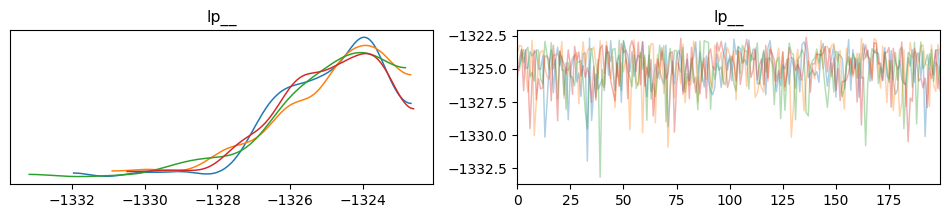

In [39]:
# 結果が収束しているかどうかの確認をしている。
cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    posterior_predictive="y_pred_step",
    log_likelihood="lp__",
    # observed_data = {"y":data["y"]}
)

ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False)


array([[<Axes: title={'center': 'beta\n0, 0'}>,
        <Axes: title={'center': 'beta\n0, 1'}>,
        <Axes: title={'center': 'beta\n0, 2'}>,
        <Axes: title={'center': 'beta\n0, 3'}>],
       [<Axes: title={'center': 'beta\n1, 0'}>,
        <Axes: title={'center': 'beta\n1, 1'}>,
        <Axes: title={'center': 'beta\n1, 2'}>,
        <Axes: title={'center': 'beta\n1, 3'}>],
       [<Axes: title={'center': 'beta\n2, 0'}>,
        <Axes: title={'center': 'beta\n2, 1'}>,
        <Axes: title={'center': 'beta\n2, 2'}>,
        <Axes: title={'center': 'beta\n2, 3'}>],
       [<Axes: title={'center': 'beta\n3, 0'}>,
        <Axes: title={'center': 'beta\n3, 1'}>,
        <Axes: title={'center': 'beta\n3, 2'}>,
        <Axes: title={'center': 'beta\n3, 3'}>]], dtype=object)

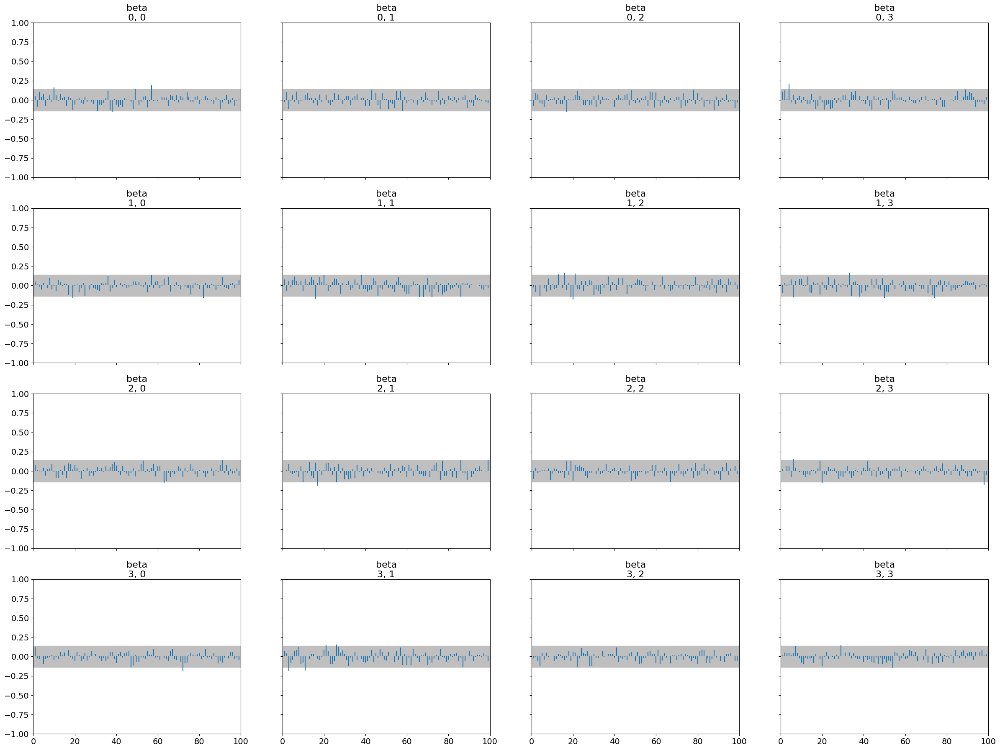

In [40]:
# 定数宣言
ls_varname = [ "beta"]

# 自己相関を確認？これがみられる場合は、thinを調整する必要がある。
az.plot_autocorr(cmdstanpy_data, var_names=ls_varname)

array([<Axes: title={'center': 'beta\n0'}>,
       <Axes: title={'center': 'beta\n1'}>,
       <Axes: title={'center': 'beta\n2'}>,
       <Axes: title={'center': 'beta\n3'}>], dtype=object)

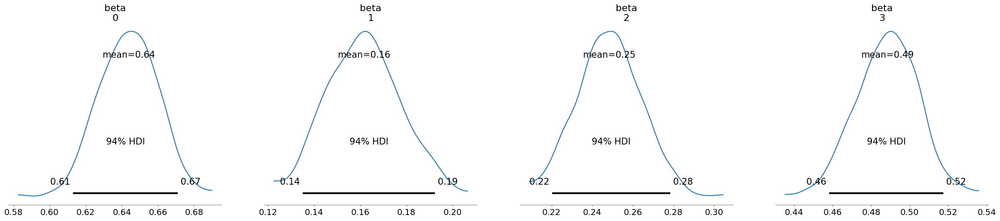

In [41]:
# 大体どのあたりに、meanがあるかの確認。
az.plot_posterior(cmdstanpy_data, var_names=ls_varname)

array([[<Axes: title={'center': 'beta\n0'}>,
        <Axes: title={'center': 'beta\n0'}>],
       [<Axes: title={'center': 'beta\n1'}>,
        <Axes: title={'center': 'beta\n1'}>],
       [<Axes: title={'center': 'beta\n2'}>,
        <Axes: title={'center': 'beta\n2'}>],
       [<Axes: title={'center': 'beta\n3'}>,
        <Axes: title={'center': 'beta\n3'}>]], dtype=object)

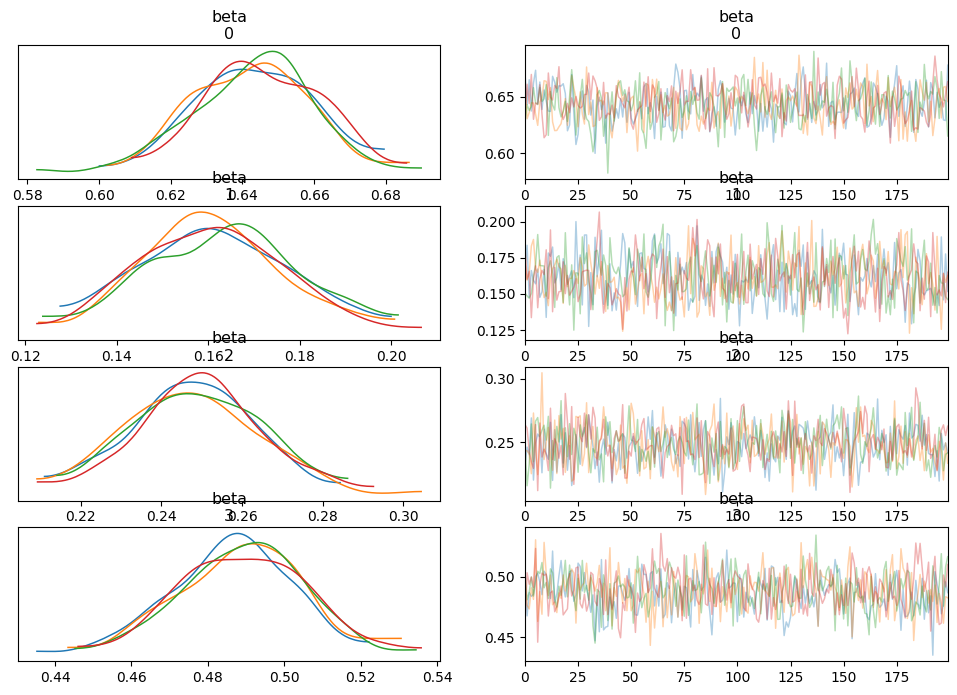

In [42]:
# 各係数の収束を確認
az.plot_trace(cmdstanpy_data, compact=False, var_names=ls_varname)

array([[<Axes: ylabel='beta\n1'>, <Axes: >, <Axes: >],
       [<Axes: ylabel='beta\n2'>, <Axes: >, <Axes: >],
       [<Axes: xlabel='beta\n0', ylabel='beta\n3'>,
        <Axes: xlabel='beta\n1'>, <Axes: xlabel='beta\n2'>]], dtype=object)

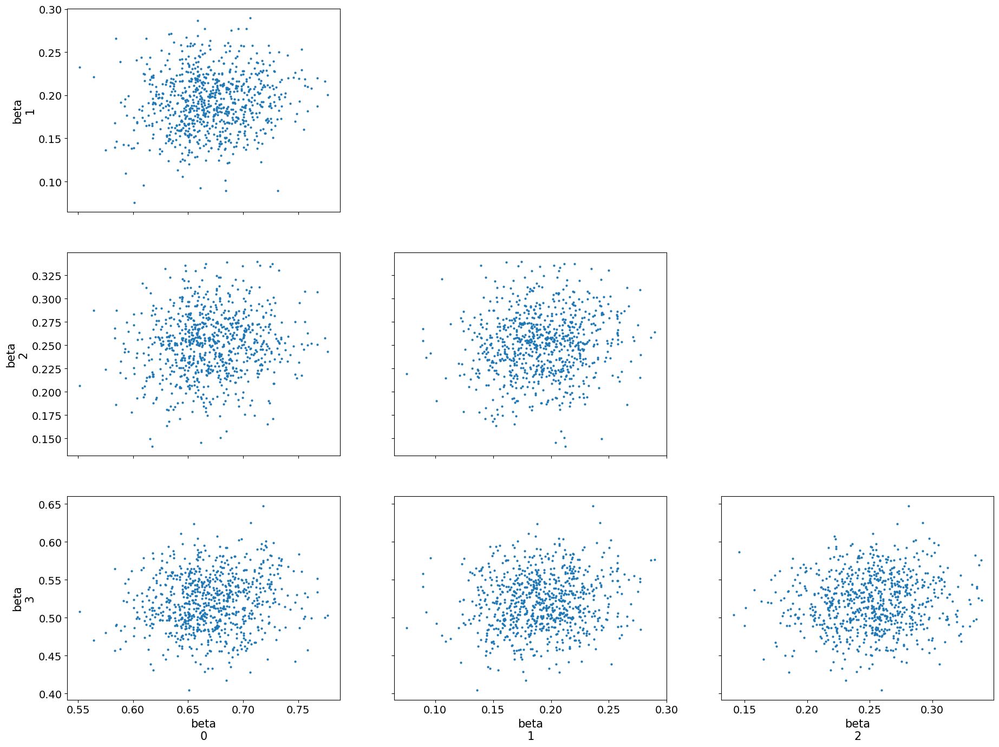

In [154]:
az.plot_pair(
    cmdstanpy_data,
    divergences=True,
    var_names=ls_varname
)

In [155]:
# モデルの事後分布出力から評価指標を確認するためのコード

# Stan モデルの出力結果
fit_summary = fit.summary()
posterior_samples = fit.draws_pd()

# --- 1. モデル収束性の確認 ---
print("### モデル収束性 ###")
print(fit_summary[["R_hat", "N_Eff"]])

# R-hatと有効サンプルサイズを確認
if all(fit_summary["R_hat"] < 1.01):
    print("R-hatはすべて1.01未満です。モデルは収束しています。")
else:
    print("R-hatが1.01を超えているパラメータがあります。モデルの収束に問題があります。")

if all(fit_summary["N_Eff"] > 100):
    print("有効サンプルサイズ(N_Eff)は十分です。")
else:
    print("n_effが小さいパラメータがあります。サンプル数を増やすことを検討してください。")

### モデル収束性 ###
                      R_hat    N_Eff
lp__               1.000600  784.505
alpha              1.007430  830.934
beta[1]            1.000050  888.966
beta[2]            1.001670  728.872
beta[3]            1.003850  848.566
...                     ...      ...
y_pred_step[996]   0.997117  661.076
y_pred_step[997]   0.998816  854.783
y_pred_step[998]   1.000290  713.130
y_pred_step[999]   1.001390  774.510
y_pred_step[1000]  1.001150  782.412

[2006 rows x 2 columns]
R-hatはすべて1.01未満です。モデルは収束しています。
有効サンプルサイズ(N_Eff)は十分です。


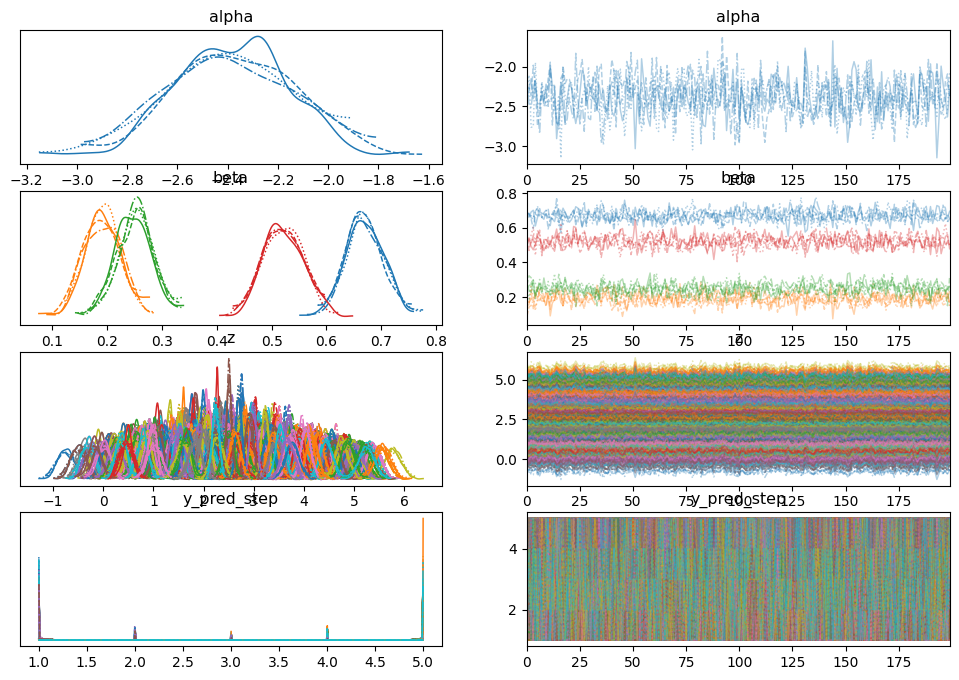

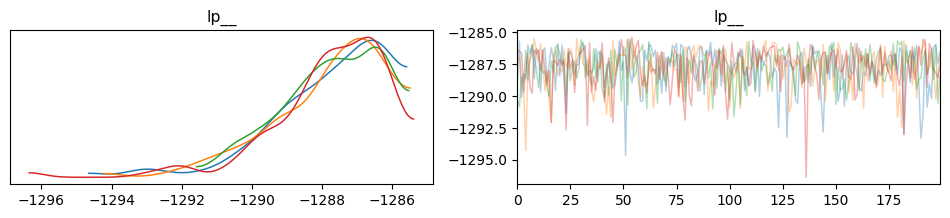

In [156]:
# 上記のa, b, sigmaの係数に影響？
cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    log_likelihood="lp__",
    observed_data = {"y":data["y"]}
)

# トレースプロットの作成
az.plot_trace(cmdstanpy_data)
plt.show()

# cmdstanpy_data
ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False)
plt.show()

### 単回帰テスト

In [63]:
# サンプルデータの作成
np.random.seed(42)
n_samples = 200

# 説明変数（おいしい〜まずいのスコア：1〜5）
delicious_score = np.random.randint(1, 6, size=n_samples)

# ノイズを加えた目的変数（また来店したい〜もう二度と来ないのスコア：1〜5）
visit_again_score = (
    delicious_score + np.random.choice([-1, 0, 1], size=n_samples, p=[0.2, 0.6, 0.2])
)
visit_again_score = np.clip(visit_again_score, 1, 5)  # 範囲を1〜5に限定

In [64]:
# データ準備
data = {
    "N": len(delicious_score),
    "K": 5,  # 目的変数のカテゴリ数
    "y": visit_again_score,
    "x": delicious_score
}

In [75]:
stan_code = """
data {
    int<lower=1> N;            // データ数
    int<lower=1> K;            // 目的変数のカテゴリ数
    vector[N] y; // 目的変数（1〜K）
    vector[N] x;               // 説明変数
}

parameters {
    real alpha;                // 切片
    real beta;                 // 回帰係数
    ordered[K] c;            // カテゴリの閾値
}

model {
    // 事前分布
    alpha ~ normal(0, 5);
    beta ~ normal(0, 5);
    c ~ normal(0, 5);
  
    // 尤度
    for (n in 1:N) {
        y[n] ~ ordered_logistic(alpha + beta * x[n], c);
  }
}
"""

stan_model_path = "./model/bayesian_sem_test_logi.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_code)

In [120]:
# Stanモデルの読み込みと実行
stan_model = CmdStanModel(stan_file=stan_model_path)


In [121]:
fit = stan_model.sample(
    data=data, 
    iter_sampling=1000, 
    iter_warmup=500, 
    chains=4, 
    seed=42,
    output_dir="./output",
    show_console=True  # コンソール出力を表示
    )

# 結果の可視化と解釈
az_data = az.from_cmdstanpy(fit)
az.plot_trace(az_data)
plt.show()

# 要約の表示
print(fit.summary())


13:32:27 - cmdstanpy - INFO - Chain [1] start processing
13:32:27 - cmdstanpy - INFO - Chain [2] start processing


13:32:27 - cmdstanpy - INFO - Chain [3] start processing
13:32:27 - cmdstanpy - INFO - Chain [4] start processing
13:32:27 - cmdstanpy - INFO - Chain [1] done processing
13:32:27 - cmdstanpy - ERROR - Chain [1] error: error during processing Operation not permitted
13:32:27 - cmdstanpy - INFO - Chain [3] done processing
13:32:27 - cmdstanpy - INFO - Chain [2] done processing
13:32:27 - cmdstanpy - ERROR - Chain [3] error: error during processing Operation not permitted
13:32:27 - cmdstanpy - ERROR - Chain [2] error: error during processing Operation not permitted
13:32:27 - cmdstanpy - INFO - Chain [4] done processing
13:32:27 - cmdstanpy - ERROR - Chain [4] error: error during processing Operation not permitted


Chain [1] method = sample (Default)
Chain [1] sample
Chain [1] num_samples = 1000 (Default)
Chain [1] num_warmup = 500
Chain [1] save_warmup = false (Default)
Chain [1] thin = 1 (Default)
Chain [1] adapt
Chain [1] engaged = true (Default)
Chain [1] gamma = 0.05 (Default)
Chain [1] delta = 0.8 (Default)
Chain [1] kappa = 0.75 (Default)
Chain [1] t0 = 10 (Default)
Chain [1] init_buffer = 75 (Default)
Chain [1] term_buffer = 50 (Default)
Chain [1] window = 25 (Default)
Chain [1] save_metric = false (Default)
Chain [1] algorithm = hmc (Default)
Chain [1] hmc
Chain [1] engine = nuts (Default)
Chain [1] nuts
Chain [1] max_depth = 10 (Default)
Chain [1] metric = diag_e (Default)
Chain [1] metric_file =  (Default)
Chain [1] stepsize = 1 (Default)
Chain [1] stepsize_jitter = 0 (Default)
Chain [1] num_chains = 1 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1]   file = /var/folders/l3/m4gqq46s65j7ryscv8skvykw0000gn/T/tmp4dfmjbhf/94tyr8_9.json
Chain [1] init = 2 (Default)
Chain [1] r

RuntimeError: Error during sampling:
Exception: mismatch in number dimensions declared and found in context; processing stage=data initialization; variable name=X; dims declared=(200,5); dims found=() (in 'bayesian_sem_orderedprobit.stan', line 5, column 2 to column 17)
Exception: mismatch in number dimensions declared and found in context; processing stage=data initialization; variable name=X; dims declared=(200,5); dims found=() (in 'bayesian_sem_orderedprobit.stan', line 5, column 2 to column 17)
Exception: mismatch in number dimensions declared and found in context; processing stage=data initialization; variable name=X; dims declared=(200,5); dims found=() (in 'bayesian_sem_orderedprobit.stan', line 5, column 2 to column 17)
Exception: mismatch in number dimensions declared and found in context; processing stage=data initialization; variable name=X; dims declared=(200,5); dims found=() (in 'bayesian_sem_orderedprobit.stan', line 5, column 2 to column 17)
Command and output files:
RunSet: chains=4, chain_ids=[1, 2, 3, 4], num_processes=4
 cmd (chain 1):
	['/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_orderedprobit', 'id=1', 'random', 'seed=42', 'data', 'file=/var/folders/l3/m4gqq46s65j7ryscv8skvykw0000gn/T/tmp4dfmjbhf/94tyr8_9.json', 'output', 'file=/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/output/bayesian_sem_orderedprobit-20241204133227_1.csv', 'method=sample', 'num_samples=1000', 'num_warmup=500', 'algorithm=hmc', 'adapt', 'engaged=1']
 retcodes=[1, 1, 1, 1]
 per-chain output files (showing chain 1 only):
 csv_file:
	/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/output/bayesian_sem_orderedprobit-20241204133227_1.csv
 console_msgs (if any):
	/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/output/bayesian_sem_orderedprobit-20241204133227_0-stdout.txt

In [81]:
stan_code = """
data {
    int<lower=0> N;                  // サンプル数
    vector[N] Q_fin1; // 説明変数（1〜11の離散値）
    vector[N] Q1;     // 目的変数（1〜11の離散値）
}

parameters {
    ordered[10] cutpoints_fin1;      // Q_fin1のカテゴリ境界
    real beta;                       // 回帰係数
    real alpha;                      // 切片
    ordered[10] cutpoints_Q1;         // Q1のカテゴリ境界
}

model {
    vector[N] z_fin;                 // Q_fin1の潜在変数

    // Q_fin1 を潜在変数にモデル化
    for (n in 1:N) {
        z_fin[n] = cutpoints_fin1[Q_fin1[n] - 1];
    }

    // Q1 の順序ロジスティックモデル
    Q1 ~ ordered_logistic(alpha + beta * z_fin, cutpoints_Q1);

    // 弱い事前分布
    beta ~ normal(0, 10);
    alpha ~ normal(0, 10);
    cutpoints_fin1 ~ normal(5, 5);   // Q_fin1のカテゴリ境界の事前分布
    cutpoints_Q1 ~ normal(5, 5);    // Q1のカテゴリ境界の事前分布
}"""

stan_model_path = "./model/bayesian_sem_test_logi.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_code)

In [41]:
stan_code = """
data {
    int<lower=0> N;                         // サンプル数
    array[N] int<lower=1, upper=11> Q_fin1; // 説明変数（1〜11の離散値）
    array[N] int<lower=1, upper=11> Q1;     // 目的変数（1〜11の離散値）
}

parameters {
    real beta;                              // 回帰係数
    real alpha;                             // 切片
    ordered[11] cutpoints_fin1;             // Q_fin1のカテゴリ境界
    ordered[11] cutpoints_Q1;               // Q1のカテゴリ境界
}

model {
    vector[N] z_fin;                        // Q_fin1の潜在変数

    // Q_fin1 を潜在変数にモデル化
    for (n in 1:N) {
        z_fin[n] = cutpoints_fin1[Q_fin1[n]];
    }

    // Q1 の順序ロジスティックモデル
    Q1 ~ ordered_logistic(alpha + beta * z_fin, cutpoints_Q1);

    // 弱い事前分布
    beta ~ normal(0, 10);
    alpha ~ normal(0, 10);
    cutpoints_fin1 ~ normal(5, 5);          // Q_fin1のカテゴリ境界の事前分布
    cutpoints_Q1 ~ normal(5, 5);            // Q1のカテゴリ境界の事前分布
}
"""

stan_model_path = "./model/bayesian_sem_test_logi.stan"

# Stanモデルの保存
with open(stan_model_path, "w") as f:
    f.write(stan_code)

# Stanモデルのコンパイル
stan_model = CmdStanModel(stan_file=stan_model_path)

16:15:16 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_test_logi.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_test_logi
16:15:26 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_test_logi


In [42]:
stan_data_logit = {
    "N": len(raw_data),  # サンプル数
    "Q_fin1": raw_data["Q3S1.1"].values,
    "Q1": raw_data["Q1"].values,
}


In [83]:
stan_model = CmdStanModel(stan_file=stan_model_path)

ValueError: Failed to get source info for Stan model '/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_test_logi.stan'. Console:
Semantic error in '/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem_test_logi.stan', line 20, column 34 to column 47:
   -------------------------------------------------
    18:      // Q_fin1 を潜在変数にモデル化
    19:      for (n in 1:N) {
    20:          z_fin[n] = cutpoints_fin1[Q_fin1[n] - 1];
                                           ^
    21:      }
    22:  
   -------------------------------------------------

Index must be of type int or int[] or must be a range. Instead found type real.


In [82]:
# サンプリング
num_cpu = multiprocessing.cpu_count()

fit = stan_model.sample(
    data=stan_data_logit,
    chains=4,
    iter_sampling=1000,
    iter_warmup=1000,
    parallel_chains=num_cpu, # 並列数,
    seed=42,
    output_dir="./output/",
    show_progress=True,
    show_console=True  # エラー確認のため
)

AttributeError: 'str' object has no attribute 'sample'

In [ ]:
stan_data_test = {
    "N": len(pickdata),  # サンプル数
    "Q_fin1": pickdata["Q3S1.1"].values,
    "Q1": pickdata["Q1"].values,
}


In [ ]:
# Stanモデルのコンパイル
stan_model = CmdStanModel(stan_file=stan_model_path)

### 結果確認部

array([[<Axes: title={'center': 'lp__'}>,
        <Axes: title={'center': 'lp__'}>]], dtype=object)

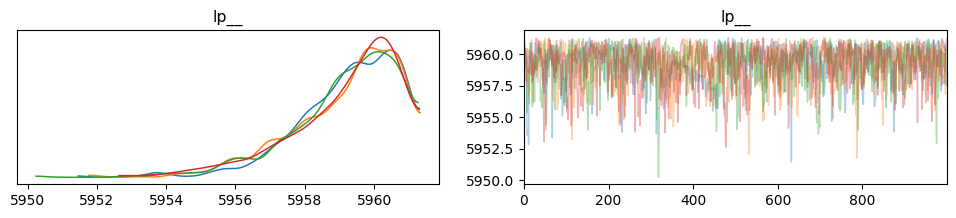

In [19]:
# 結果が収束しているかどうかの確認をしている。
cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    # posterior_predictive="y_pred",
    log_likelihood="lp__",
    # observed_data = {"y":data["y"]}
)

ll_data = cmdstanpy_data.log_likelihood
az.plot_trace(ll_data, compact=False)


array([[<Axes: title={'center': 'beta'}>,
        <Axes: title={'center': 'beta'}>],
       [<Axes: title={'center': 'alpha'}>,
        <Axes: title={'center': 'alpha'}>]], dtype=object)

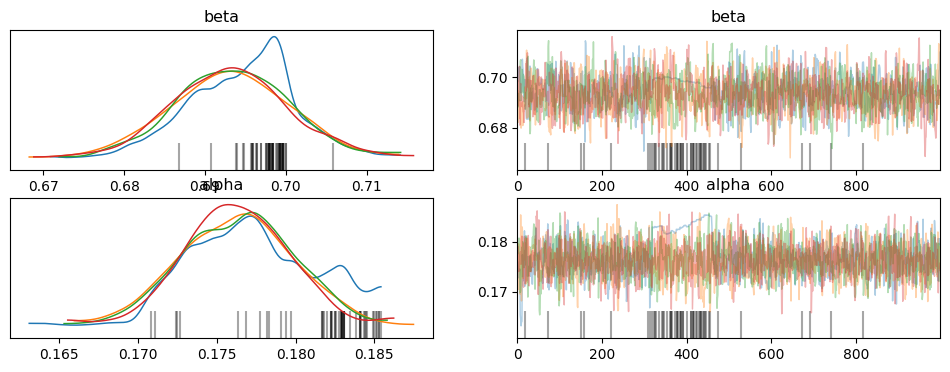

In [20]:
# 各係数の収束を確認
az.plot_trace(cmdstanpy_data, compact=False, var_names=["beta","alpha"])

## Multi regression test

In [16]:
stan_data = {
    "N": len(pickdata),  # サンプル数
    "Q_fin1": pickdata["Q3S1.1"].values,
    "Q_fin2": pickdata["Q3S2.1"].values,
    "Q_fin3": pickdata["Q3S3.1"].values,
    "Q_health1": pickdata["Q3S4.1"].values,
    "Q_health2": pickdata["Q3S5.1"].values,
    "Q1": pickdata["Q1"].values,
}


In [23]:
stan_data

{'N': 10619,
 'Q_fin1': array([ 0. ,  0. , -0.4, ...,  0. , -0.4,  0.4]),
 'Q_fin2': array([ 0. ,  0.4, -0.4, ...,  0. , -1. , -0.2]),
 'Q_fin3': array([ 0. ,  0.2, -0.4, ...,  0. ,  0. , -0.6]),
 'Q_health1': array([ 0. ,  0.2,  0. , ...,  0. , -1. ,  0. ]),
 'Q_health2': array([ 0. ,  0. , -0.2, ...,  0. , -0.8,  0.4]),
 'Q1': array([ 0. ,  0.2, -0.2, ...,  0.6, -0.6, -0.8])}

In [22]:
# モデルのコンパイル
stan_model = CmdStanModel(stan_file=stan_model_path)

num_cpu = multiprocessing.cpu_count()

# サンプリング
fit = stan_model.sample(
    data=stan_data,
    chains=4,
    iter_sampling=2000,
    iter_warmup=500,
    parallel_chains=num_cpu, # 並列数,
    seed=42,
    output_dir="./output/",
    show_console=True  # エラー確認のため
)

# 結果の表示
print(fit.summary())


14:33:32 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
14:33:32 - cmdstanpy - INFO - Chain [1] start processing
14:33:32 - cmdstanpy - INFO - Chain [2] start processing
14:33:32 - cmdstanpy - INFO - Chain [3] start processing
14:33:32 - cmdstanpy - INFO - Chain [4] start processing


Chain [1] method = sample (Default)
Chain [1] sample
Chain [1] num_samples = 2000
Chain [1] num_warmup = 500
Chain [1] save_warmup = false (Default)
Chain [1] thin = 1 (Default)
Chain [1] adapt
Chain [1] engaged = true (Default)
Chain [1] gamma = 0.05 (Default)
Chain [1] delta = 0.8 (Default)
Chain [1] kappa = 0.75 (Default)
Chain [1] t0 = 10 (Default)
Chain [1] init_buffer = 75 (Default)
Chain [1] term_buffer = 50 (Default)
Chain [1] window = 25 (Default)
Chain [1] save_metric = false (Default)
Chain [1] algorithm = hmc (Default)
Chain [1] hmc
Chain [1] engine = nuts (Default)
Chain [1] nuts
Chain [1] max_depth = 10 (Default)
Chain [1] metric = diag_e (Default)
Chain [1] metric_file =  (Default)
Chain [1] stepsize = 1 (Default)
Chain [1] stepsize_jitter = 0 (Default)
Chain [1] num_chains = 1 (Default)
Chain [1] id = 1 (Default)
Chain [1] data
Chain [1] file = /var/folders/l3/m4gqq46s65j7ryscv8skvykw0000gn/T/tmpt0e9lc1q/tmbbe9kc.json
Chain [1] init = 2 (Default)
Chain [1] random
Chain 

KeyboardInterrupt: 

## モデル実行部

In [277]:
# Stanモデルのコンパイル
stan_model = stan.CmdStanModel(stan_file=stan_model_path)

14:00:34 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem
14:00:53 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/bayesian_sem


In [281]:
pickdata = pickdata.iloc[:2000,:]

In [282]:
# Stanに渡す形式に変換
stan_data = {
    "N": len(pickdata),  # サンプル数
    "K_env": 2,  # fEnvironmentの観測変数数
    "K_fin": 3,  # fFinanceの観測変数数
    "K_soc": 3,  # fSocialの観測変数数
    "K_com": 2,  # fCommunityの観測変数数
    "K_health": 2,  # fHealthの観測変数数
    "Q_env": pickdata[["Q3S9.1", "Q3S10.1"]].values,
    "Q_fin": pickdata[["Q3S1.1", "Q3S2.1", "Q3S3.1"]].values,
    "Q_soc": pickdata[["Q3S11.1", "Q3S12.1", "Q3S8.1"]].values,
    "Q_com": pickdata[["Q3S6.1", "Q3S7.1"]].values,
    "Q_health": pickdata[["Q3S4.1", "Q3S5.1"]].values,
    "Q1": pickdata["Q1"].values,
}

In [ ]:
num_cpu = multiprocessing.cpu_count()

# モデルのフィッティング
fit = stan_model.sample(
    data=stan_data,
    chains=4,
    seed=1,
    iter_warmup=100,
    iter_sampling=500,
    parallel_chains=num_cpu, # 並列数,
    save_warmup=False,
    thin=1,
    output_dir="./output/",
    show_progress=True
    # show_console=True  # コンソール出力を表示
)

14:02:12 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
14:02:12 - cmdstanpy - INFO - CmdStan start processing





























































# 変分ベイズの導入検証

In [83]:
# Stan モデリング部 (既存コードを使用)
stan_code = """
data {
    int<lower=0> N;              // サンプル数
    vector[N] x1;                // 観測変数
    vector[N] x2;
    vector[N] x3;
    vector[N] x4;
    vector[N] x5;
    vector[N] x6;
    vector[N] x7;
    vector[N] x8;
    vector[N] x9;
    vector[N] y;                 // 目的変数
}

parameters {
    // 潜在因子
    vector[N] f1;                // 潜在変数 f1
    vector[N] f2;                // 潜在変数 f2
    vector[N] f3;                // 潜在変数 f3

    // 回帰係数
    real beta_f1_x1;             // f1 ~ x1
    real beta_f1_x2;             // f1 ~ x2
    real beta_f1_x3;             // f1 ~ x3
    real beta_f2_x4;             // f2 ~ x4
    real beta_f2_x5;             // f2 ~ x5
    real beta_f2_x6;             // f2 ~ x6
    real beta_f3_x7;             // f3 ~ x7
    real beta_f3_x8;             // f3 ~ x8
    real beta_f3_x9;             // f3 ~ x9

    // 潜在因子と目的変数の回帰係数
    real gamma_y_f1;             // y ~ f1
    real gamma_y_f2;             // y ~ f2
    real gamma_y_f3;             // y ~ f3

    // 誤差項
    real<lower=0> sigma_f1;      // f1の誤差
    real<lower=0> sigma_f2;
    real<lower=0> sigma_f3;
    real<lower=0> sigma_y;       // yの誤差
}

model {
    // 潜在因子モデル
    f1 ~ normal(beta_f1_x1 * x1 + beta_f1_x2 * x2 + beta_f1_x3 * x3, sigma_f1);
    f2 ~ normal(beta_f2_x4 * x4 + beta_f2_x5 * x5 + beta_f2_x6 * x6, sigma_f2);
    f3 ~ normal(beta_f3_x7 * x7 + beta_f3_x8 * x8 + beta_f3_x9 * x9, sigma_f3);

    // 目的変数のモデル
    y ~ normal(gamma_y_f1 * f1 + gamma_y_f2 * f2 + gamma_y_f3 * f3, sigma_y);

    // 弱い事前分布
    beta_f1_x1 ~ normal(0, 1);
    beta_f1_x2 ~ normal(0, 1);
    beta_f1_x3 ~ normal(0, 1);
    beta_f2_x4 ~ normal(0, 1);
    beta_f2_x5 ~ normal(0, 1);
    beta_f2_x6 ~ normal(0, 1);
    beta_f3_x7 ~ normal(0, 1);
    beta_f3_x8 ~ normal(0, 1);
    beta_f3_x9 ~ normal(0, 1);
    gamma_y_f1 ~ normal(0, 1);
    gamma_y_f2 ~ normal(0, 1);
    gamma_y_f3 ~ normal(0, 1);
    sigma_f1 ~ exponential(1);
    sigma_f2 ~ exponential(1);
    sigma_f3 ~ exponential(1);
    sigma_y ~ exponential(1);
}

generated quantities {
    vector[N] log_lik;
    vector[N] y_pred;
    vector[N] mu;

    for (n in 1:N) {
        mu[n] = gamma_y_f1 * f1[n] + gamma_y_f2 * f2[n] + gamma_y_f3 * f3[n];
        log_lik[n] = normal_lpdf(y[n] | mu[n], sigma_y);
        y_pred[n] = normal_rng(mu[n], sigma_y);
    }
}
"""

# Stanコードの保存
stan_model_path = "./model/multi_factor_analysis_vi.stan"
with open(stan_model_path, "w") as f:
    f.write(stan_code)

# Stanモデルのコンパイル
stan_model = stan.CmdStanModel(stan_file=stan_model_path)

# サンプルデータの準備
stan_data = {
    'N': len(data),
    'x1': data['x1'].values,
    'x2': data['x2'].values,
    'x3': data['x3'].values,
    'x4': data['x4'].values,
    'x5': data['x5'].values,
    'x6': data['x6'].values,
    'x7': data['x7'].values,
    'x8': data['x8'].values,
    'x9': data['x9'].values,
    'y': data['y'].values
}

15:45:09 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/multi_factor_analysis_vi.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/multi_factor_analysis_vi
15:45:22 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/multi_factor_analysis_vi


In [87]:
# 変分ベイズの実行
fit_vi = stan_model.variational(
    data=stan_data,
    algorithm="meanfield",
    iter=10000,
    seed=1,
    output_dir="./output_vi/",
    grad_samples=1, 
    elbo_samples=100, 
    output_samples=1000
)

15:54:41 - cmdstanpy - WARNING - Argument name `output_samples` is deprecated, please rename to `draws`.
15:54:41 - cmdstanpy - INFO - Chain [1] start processing
15:54:42 - cmdstanpy - INFO - Chain [1] done processing


In [92]:
print(fit_vi.column_names)

('lp__', 'log_p__', 'log_g__', 'f1[1]', 'f1[2]', 'f1[3]', 'f1[4]', 'f1[5]', 'f1[6]', 'f1[7]', 'f1[8]', 'f1[9]', 'f1[10]', 'f1[11]', 'f1[12]', 'f1[13]', 'f1[14]', 'f1[15]', 'f1[16]', 'f1[17]', 'f1[18]', 'f1[19]', 'f1[20]', 'f1[21]', 'f1[22]', 'f1[23]', 'f1[24]', 'f1[25]', 'f1[26]', 'f1[27]', 'f1[28]', 'f1[29]', 'f1[30]', 'f1[31]', 'f1[32]', 'f1[33]', 'f1[34]', 'f1[35]', 'f1[36]', 'f1[37]', 'f1[38]', 'f1[39]', 'f1[40]', 'f1[41]', 'f1[42]', 'f1[43]', 'f1[44]', 'f1[45]', 'f1[46]', 'f1[47]', 'f1[48]', 'f1[49]', 'f1[50]', 'f1[51]', 'f1[52]', 'f1[53]', 'f1[54]', 'f1[55]', 'f1[56]', 'f1[57]', 'f1[58]', 'f1[59]', 'f1[60]', 'f1[61]', 'f1[62]', 'f1[63]', 'f1[64]', 'f1[65]', 'f1[66]', 'f1[67]', 'f1[68]', 'f1[69]', 'f1[70]', 'f1[71]', 'f1[72]', 'f1[73]', 'f1[74]', 'f1[75]', 'f1[76]', 'f1[77]', 'f1[78]', 'f1[79]', 'f1[80]', 'f1[81]', 'f1[82]', 'f1[83]', 'f1[84]', 'f1[85]', 'f1[86]', 'f1[87]', 'f1[88]', 'f1[89]', 'f1[90]', 'f1[91]', 'f1[92]', 'f1[93]', 'f1[94]', 'f1[95]', 'f1[96]', 'f1[97]', 'f1[98]'

In [97]:
print(fit_vi.variational_sample.shape)

(1000, 3019)


In [89]:
# 近似事後分布の平均を取得
params = fit_vi.variational_params_dict
alpha_mean = params['alpha']
beta_mean = params['beta']
sigma_mean = params['sigma']

print(f"alpha: {alpha_mean}, beta: {beta_mean}, sigma: {sigma_mean}")

KeyError: 'alpha'

In [85]:
# 結果を確認
fit_vi_summary = fit_vi.variational_params_dict
print("### 変分ベイズの結果 ###")
print(fit_vi_summary)

# ArviZで解析可能にする（必要に応じて）
az_data = az.from_cmdstanpy(posterior=fit_vi)
az.plot_posterior(az_data)


15:45:31 - cmdstanpy - WARNING - The default behavior of CmdStanVB.stan_variable() will change in a future release to return the variational sample, rather than the mean.
To maintain the current behavior, pass the argument mean=True
15:45:31 - cmdstanpy - WARNING - The default behavior of CmdStanVB.stan_variable() will change in a future release to return the variational sample, rather than the mean.
To maintain the current behavior, pass the argument mean=True
15:45:31 - cmdstanpy - WARNING - The default behavior of CmdStanVB.stan_variable() will change in a future release to return the variational sample, rather than the mean.
To maintain the current behavior, pass the argument mean=True


### 変分ベイズの結果 ###
OrderedDict([('lp__', np.float64(0.0)), ('log_p__', np.float64(0.0)), ('log_g__', np.float64(0.0)), ('f1[1]', np.float64(0.017612)), ('f1[2]', np.float64(0.0100855)), ('f1[3]', np.float64(-0.725754)), ('f1[4]', np.float64(1.29906)), ('f1[5]', np.float64(-0.822374)), ('f1[6]', np.float64(-0.319253)), ('f1[7]', np.float64(1.12537)), ('f1[8]', np.float64(-0.530141)), ('f1[9]', np.float64(-0.0752555)), ('f1[10]', np.float64(0.272461)), ('f1[11]', np.float64(-0.658237)), ('f1[12]', np.float64(-0.0963461)), ('f1[13]', np.float64(-0.620645)), ('f1[14]', np.float64(-1.43714)), ('f1[15]', np.float64(-1.61438)), ('f1[16]', np.float64(-0.0902668)), ('f1[17]', np.float64(0.290737)), ('f1[18]', np.float64(-0.106507)), ('f1[19]', np.float64(-0.604733)), ('f1[20]', np.float64(-0.665474)), ('f1[21]', np.float64(0.49282)), ('f1[22]', np.float64(0.419039)), ('f1[23]', np.float64(0.434828)), ('f1[24]', np.float64(-1.47764)), ('f1[25]', np.float64(-1.43308)), ('f1[26]', np.float64(-0.6767

AttributeError: Unknown variable name: chains
Available variables are f1, f2, f3, beta_f1_x1, beta_f1_x2, beta_f1_x3, beta_f2_x4, beta_f2_x5, beta_f2_x6, beta_f3_x7, beta_f3_x8, beta_f3_x9, gamma_y_f1, gamma_y_f2, gamma_y_f3, sigma_f1, sigma_f2, sigma_f3, sigma_y, log_lik, y_pred, mu

In [86]:
import arviz as az
import numpy as np
import xarray as xr

# CmdStanVBオブジェクトの結果を取得
vi_params = fit_vi.variational_params_dict

# 必要なパラメータを抽出して辞書に格納
posterior_dict = {
    param: np.array(value).reshape(-1, 1) for param, value in vi_params.items()
}

# パラメータの次元情報を作成
dims = {
    var: [] for var in posterior_dict.keys()  # 1次元の場合
}

# ArviZ用のInferenceDataを作成
az_data = az.from_dict(posterior=posterior_dict, dims=dims)

# 事後分布の可視化
az.plot_posterior(az_data)


/opt/miniconda3/envs/cmdstanpy_env/lib/python3.10/site-packages/arviz/plots/plot_utils.py:270: UserWarning: rcParams['plot.max_subplots'] (40) is smaller than the number of variables to plot (3019) in plot_posterior, generating only 40 plots
  warnings.warn(
/opt/miniconda3/envs/cmdstanpy_env/lib/python3.10/site-packages/arviz/stats/density_utils.py:488: UserWarning: Your data appears to have a single value or no finite values
  warnings.warn("Your data appears to have a single value or no finite values")


array([[<Axes: title={'center': 'lp__'}>,
        <Axes: title={'center': 'log_p__'}>,
        <Axes: title={'center': 'log_g__'}>,
        <Axes: title={'center': 'f1[1]'}>],
       [<Axes: title={'center': 'f1[2]'}>,
        <Axes: title={'center': 'f1[3]'}>,
        <Axes: title={'center': 'f1[4]'}>,
        <Axes: title={'center': 'f1[5]'}>],
       [<Axes: title={'center': 'f1[6]'}>,
        <Axes: title={'center': 'f1[7]'}>,
        <Axes: title={'center': 'f1[8]'}>,
        <Axes: title={'center': 'f1[9]'}>],
       [<Axes: title={'center': 'f1[10]'}>,
        <Axes: title={'center': 'f1[11]'}>,
        <Axes: title={'center': 'f1[12]'}>,
        <Axes: title={'center': 'f1[13]'}>],
       [<Axes: title={'center': 'f1[14]'}>,
        <Axes: title={'center': 'f1[15]'}>,
        <Axes: title={'center': 'f1[16]'}>,
        <Axes: title={'center': 'f1[17]'}>],
       [<Axes: title={'center': 'f1[18]'}>,
        <Axes: title={'center': 'f1[19]'}>,
        <Axes: title={'center': 'f1[

ValueError: Image size of 2346x131842 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 2944x5520 with 40 Axes>

# pystanが使えないけど、hello world

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import cmdstanpy as stan
%matplotlib inline

In [ ]:
plt.style.use("ggplot")

In [ ]:
df=pd.read_excel("./data/data.xlsx")

(array([ 1.,  1.,  5., 12., 10., 18., 16.,  8.,  5.,  4.]),
 array([2.29193477, 2.77510498, 3.25827519, 3.74144541, 4.22461562,
        4.70778584, 5.19095605, 5.67412627, 6.15729648, 6.64046669,
        7.12363691]),
 <BarContainer object of 10 artists>)

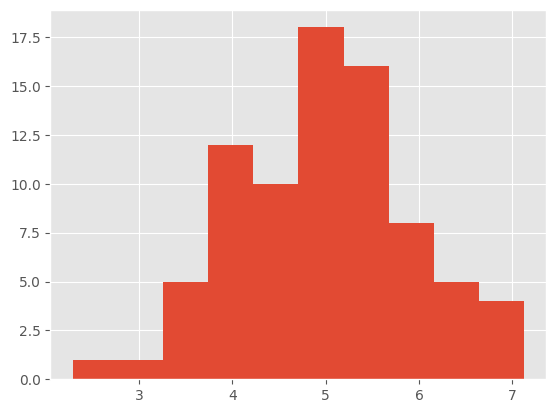

In [ ]:
plt.hist(df[0])

In [ ]:
stan_model = """
data {
    int<lower=0> N;       // サンプルサイズ
    vector[N] Y;            // 観測値
}

parameters {
    real mu;              // 平均
    real<lower=0> sigma;  // 標準偏差
}

model {
    for (i in 1:N) {
        Y[i] ~ normal(mu, sigma);  // 正規分布に従う
    }
}
"""

# Stanモデルの保存
with open("./model/linear_regression.stan", "w") as f:
    f.write(stan_model)

In [ ]:
# Stanモデルのコンパイル
stan_model = stan.CmdStanModel(stan_file="./model/linear_regression.stan")

15:34:10 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/linear_regression.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/linear_regression
15:34:19 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/linear_regression


In [ ]:
stan_data = {"N":df.shape[0],"Y":df[0]}

In [ ]:
num_cpu = multiprocessing.cpu_count()

# モデルのフィッティング
fit = stan_model.sample(
    data=stan_data,
    chains=4,
    seed=1,
    iter_warmup=500,
    iter_sampling=2000,
    parallel_chains=num_cpu, # 並列数,
    save_warmup=False,
    thin=1,
    output_dir="./output/",
    show_progress=True
    # show_console=True  # コンソール出力を表示
)

15:35:25 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
15:35:26 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status


chain 1 |██████████| 00:00 Sampling completed
chain 2 |██████████| 00:00 Sampling completed
chain 3 |██████████| 00:00 Sampling completed
chain 4 |██████████| 00:00 Sampling completed


15:35:26 - cmdstanpy - INFO - CmdStan done processing.
15:35:26 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: normal_lpdf: Scale parameter is 0, but must be positive! (in 'linear_regression.stan', line 14, column 8 to column 33)
Consider re-running with show_console=True if the above output is unclear!


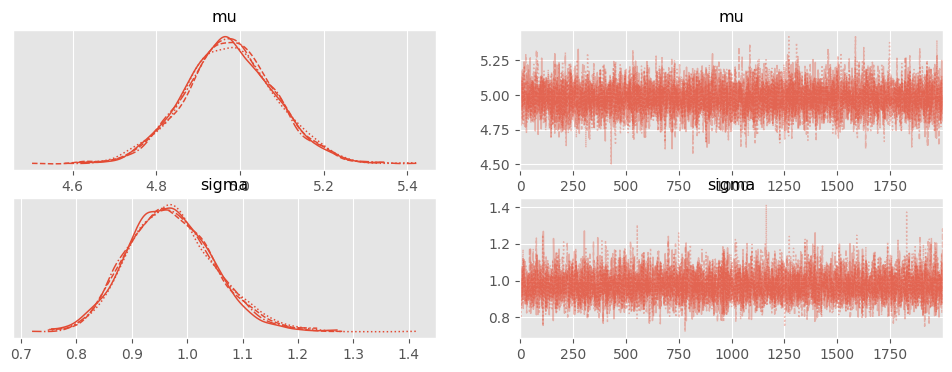

In [ ]:
cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    log_likelihood="lp__",
)

# トレースプロットの作成
az.plot_trace(cmdstanpy_data)
plt.show()

## 単回帰分析

In [ ]:
data = pd.read_excel("./data/real_estate1.xlsx")

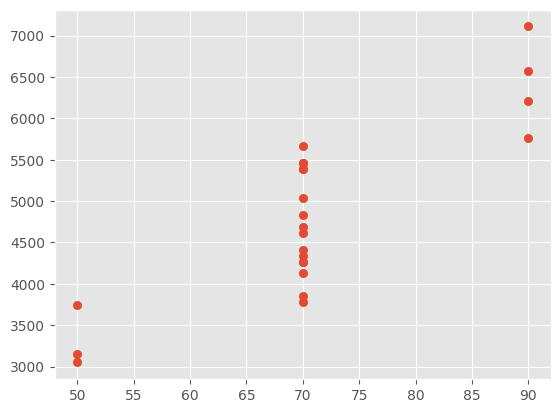

In [ ]:
plt.scatter(data["space"],data["value"])

In [ ]:
stan_model = """
data {
    int<lower=0> N;       // サンプルサイズ
    vector[N] y;            // 目的変数
    vector[N] x;            // 説明変数
}

parameters {
    real a;              // 傾き
    real b;              // 切片
    real<lower=0> sigma;  // 標準偏差
}

model {
    for (n in 1:N) {
        y[n] ~ normal(a * x[n] + b, sigma);  // 正規分布に従う
    }
}
"""

# Stanモデルの保存
with open("./model/single_linear_regression.stan", "w") as f:
    f.write(stan_model)

In [ ]:
stan_model = stan.CmdStanModel(stan_file="./model/single_linear_regression.stan")

15:44:34 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/single_linear_regression.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/single_linear_regression
15:44:42 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/single_linear_regression


In [ ]:
stan_data = {"N":data.shape[0],"y":data["value"],"x":data["space"]}

In [ ]:
num_cpu = multiprocessing.cpu_count()

# モデルのフィッティング
fit = stan_model.sample(
    data=stan_data,
    chains=4,
    seed=1,
    iter_warmup=500,
    iter_sampling=2000,
    parallel_chains=num_cpu, # 並列数,
    save_warmup=False,
    thin=1,
    output_dir="./output/",
    show_progress=True
    # show_console=True  # コンソール出力を表示
)

15:45:23 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
15:45:23 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status


chain 1 |████▍     | 00:00 Iteration:  900 / 2500 [ 36%]  (Sampling)


chain 1 |██████████| 00:00 Sampling completed                       
chain 2 |██████████| 00:00 Sampling completed                       
chain 3 |██████████| 00:00 Sampling completed                       
chain 4 |██████████| 00:00 Sampling completed                     


15:45:23 - cmdstanpy - INFO - CmdStan done processing.


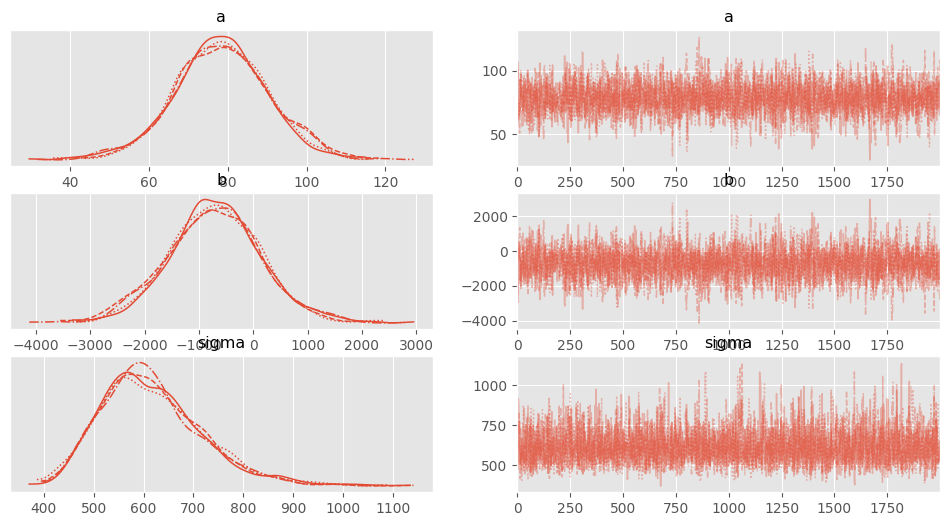

In [ ]:
cmdstanpy_data = az.from_cmdstanpy(
    posterior=fit,
    log_likelihood="lp__",
)

# トレースプロットの作成
az.plot_trace(cmdstanpy_data)
plt.show()

In [ ]:
### r_hat>1.1の確認
# 設定
idata_in = fit      # idata名
threshold = 1.1          # しきい値

# しきい値を超えるR_hatの個数を表示
print((az.rhat(idata_in) > threshold).sum().data_vars)

fit.summary()

Data variables:
    a        int64 8B 0
    b        int64 8B 0


,Mean,MCSE,StdDev,5%,50%,95%,N_Eff,N_Eff/s,R_hat
lp__,-14.9212,0.026363,1.02500,-17.0083,-14.6097,-13.9195,1511.65,1190.280,1.00102
a,13.6639,0.104731,3.44516,8.6844,13.3271,19.9154,1082.10,852.050,1.00110
b,-20.4089,0.158977,5.23412,-29.9080,-19.9131,-12.7957,1083.98,853.524,1.00110


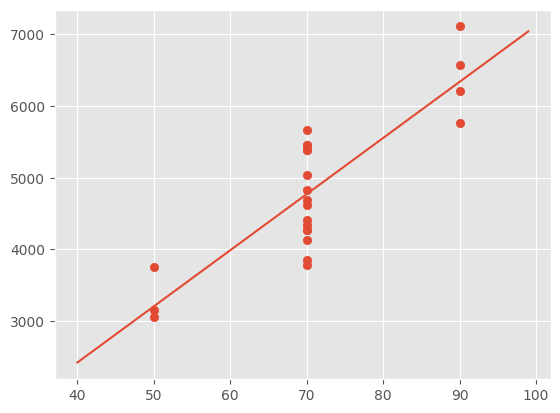

In [ ]:
a = 78.3
b = -710.3140
x = np.arange(40,100,1)
y = a*x + b
plt.plot(x,y)
plt.scatter(data["space"],data["value"])

In [ ]:
fit

CmdStanMCMC: model=logit chains=4['method=sample', 'num_samples=2000', 'num_warmup=500', 'thin=1', 'algorithm=hmc', 'adapt', 'engaged=1']
 csv_files:
	/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/output/logit-20241129173917_1.csv
	/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/output/logit-20241129173917_2.csv
	/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/output/logit-20241129173917_3.csv
	/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/output/logit-20241129173917_4.csv
 output_files:
	/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/output/logit-20241129173917_0-stdout.txt
	/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/output/logit-20241129173917_1-stdout.txt
	/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/output/logit-20241129173917_2-stdout.txt
	/Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/output/logit-20241129173917_3-stdout.txt

In [ ]:
az.waic(fit)

TypeError: log likelihood not found in inference data object

In [ ]:
### WAICの算出
# log-score

# WAICとLOOの計算
print("WAIC:", az.waic(cmdstanpy_data))
print("LOO:", az.loo(cmdstanpy_data))

waic_rw_log = az.waic(fit, scale='log')
# -2*log-score
waic_rw_dev = az.waic(fit, scale='deviance')
# データフレーム化
waic_df = pd.DataFrame({'Estimate': [waic_rw_log.elpd_waic, 
                                     waic_rw_dev.elpd_waic, waic_rw_log.p_waic],
                        'SE': [waic_rw_log.se, waic_rw_dev.se, np.nan]},
                       index=['elpd_waic', 'deviance_waic', 'p_waic'])
display(waic_df.round(2))

TypeError: log likelihood not found in inference data object

# ベイズ信頼区間・予測区間

In [ ]:
data = pd.read_excel("./data/real_estate1.xlsx")

In [ ]:
stan_model = """
data {
    int<lower=0> N;       // サンプルサイズ
    vector[N] y;            // 目的変数
    vector[N] x;            // 説明変数
    int n_s;
    vector[n_s] x_s;
}

parameters {
    real a;              // 傾き
    real b;              // 切片
    real<lower=0> sigma;  // 標準偏差
}

model {
    for (n in 1:N) {
        y[n] ~ normal(a * x[n] + b, sigma);  // 正規分布に従う
    }
}

generated quantities{
    vector[n_s] y_s;
    for(n in 1:n_s){
        y_s[n]=normal_rng(a*x_s[n] + b,sigma);
    }
}
"""

# Stanモデルの保存
with open("./model/single_linear_regression2.stan", "w") as f:
    f.write(stan_model)

In [ ]:
stan_model = stan.CmdStanModel(stan_file="./model/single_linear_regression2.stan")

15:53:35 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/single_linear_regression2.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/single_linear_regression2
15:53:43 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/single_linear_regression2


In [ ]:
x_s = np.arange(40,90,1)
n_s = x_s.shape[0]
stan_Data = {
    "N":data.shape[0],
    "x":data["space"],
    "y":data["value"],
    "n_s":n_s,
    "x_s":x_s
}

In [ ]:
num_cpu = multiprocessing.cpu_count()

# モデルのフィッティング
fit = stan_model.sample(
    data=stan_Data,
    chains=4,
    seed=1,
    iter_warmup=500,
    iter_sampling=2000,
    parallel_chains=num_cpu, # 並列数,
    save_warmup=False,
    thin=1,
    output_dir="./output/",
    show_progress=True
    # show_console=True  # コンソール出力を表示
)

15:55:53 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
15:55:54 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status


chain 1 |████      | 00:00 Iteration:  800 / 2500 [ 32%]  (Sampling)


chain 1 |██████████| 00:00 Sampling completed                       
chain 2 |██████████| 00:00 Sampling completed

chain 3 |██████████| 00:00 Sampling completed


chain 4 |██████████| 00:00 Sampling completed


15:55:54 - cmdstanpy - INFO - CmdStan done processing.


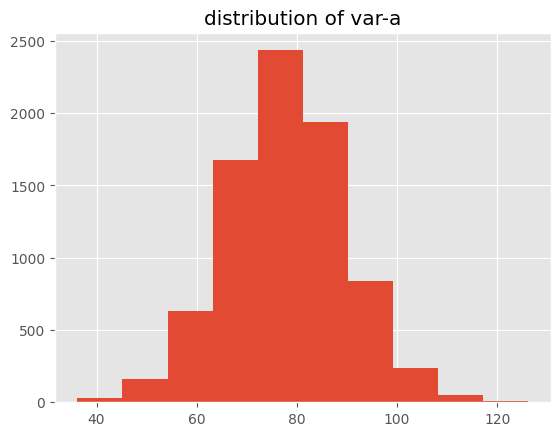

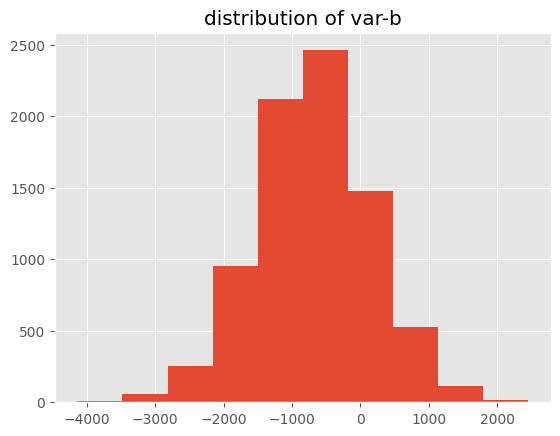

In [ ]:
ms_a = fit.a
plt.hist(ms_a)
plt.title("distribution of var-a")
plt.show()

ms_b = fit.b
plt.hist(ms_b)
plt.title("distribution of var-b")
plt.show()

In [ ]:
df_b = pd.DataFrame([])

In [ ]:
for i in range(40,90,1):
    df_b[i] = ms_a * i + ms_b

In [ ]:
low_y50, high_y50 = mstats.mquantiles(df_b,[0.25,0.75],axis=0)
low_y95, high_y95 = mstats.mquantiles(df_b,[0.025,0.975],axis=0)

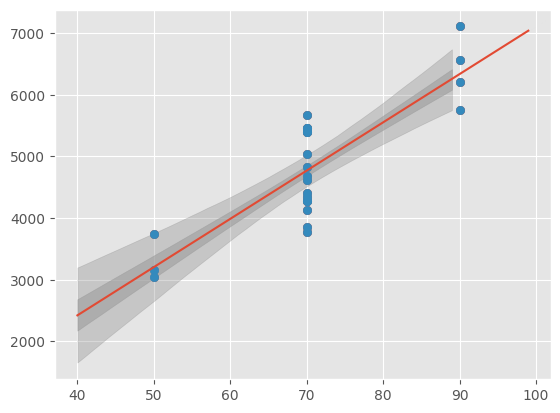

In [ ]:
plt.scatter(data["space"],data["value"])
plt.fill_between(x_s,low_y50,high_y50,alpha = 0.6,color = "darkgray")
plt.fill_between(x_s,low_y95,high_y95,alpha = 0.3,color = "gray")
a = 78.3
b = -710.3140
y = a*x + b

plt.plot(x,y)
plt.scatter(data["space"],data["value"])

In [ ]:
y_p = fit.y_s

In [ ]:
low_y, high_y = mstats.mquantiles(y_p,[0.025,0.975],axis=0)

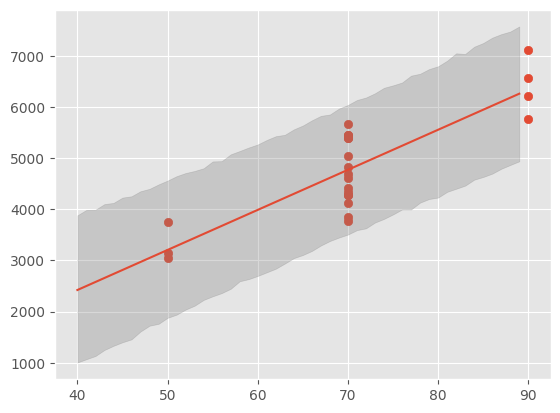

In [ ]:
plt.scatter(data["space"],data["value"])
plt.fill_between(x_s,low_y,high_y,alpha = 0.3,color = "gray")

a = 78.3
b = -710.3140
y = a*x_s + b

plt.plot(x_s,y)

# ロジスティック回帰

In [ ]:
df = pd.read_excel("./data/dose_response.xlsx")

In [ ]:
model = """
data {
    int N;              // サンプルサイズ
    array[N] real X;             // 説明変数
    array[N] int<lower=0, upper=1> Y;  // 目的変数（二値データ）
}

parameters {
    real a;                      // 回帰係数
    real b;                      // 切片
}

model {
    for(n in 1:N){
        Y[n] ~ bernoulli_logit(a * X[n] + b); // ベクトル化されたロジスティック回帰モデル
    }
}

"""

# Stanモデルの保存
with open("./model/logit.stan", "w") as f:
    f.write(model)

In [ ]:
stan_model = stan.CmdStanModel(stan_file="./model/logit.stan")

17:38:59 - cmdstanpy - INFO - compiling stan file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/logit.stan to exe file /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/logit
17:39:07 - cmdstanpy - INFO - compiled model executable: /Users/imaedakoju/Documents/研究開発/幸福度調査/bayesian_stan_practice/model/logit


In [ ]:
stan_data = {"N":df.shape[0],"X":df["log10 C"], "Y":df["death"]}

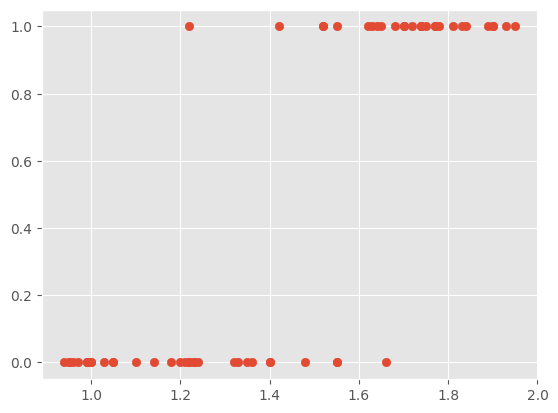

In [ ]:
plt.scatter(df["log10 C"],df["death"])

In [ ]:
num_cpu = multiprocessing.cpu_count()

# モデルのフィッティング
fit = stan_model.sample(
    data=stan_data,
    chains=4,
    seed=1,
    iter_warmup=500,
    iter_sampling=2000,
    parallel_chains=num_cpu, # 並列数,
    save_warmup=False,
    thin=1,
    output_dir="./output/",
    show_progress=True
    # show_console=True  # コンソール出力を表示
)

17:39:17 - cmdstanpy - INFO - Requested 10 parallel_chains but only 4 required, will run all chains in parallel.
17:39:17 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status



chain 1 |██▉       | 00:00 Iteration:  501 / 2500 [ 20%]  (Sampling)


chain 1 |█████▉    | 00:00 Iteration: 1300 / 2500 [ 52%]  (Sampling)




chain 1 |██████████| 00:00 Sampling completed                       
chain 2 |██████████| 00:00 Sampling completed                       
chain 3 |██████████| 00:00 Sampling completed                       
chain 4 |██████████| 00:00 Sampling completed                       


17:39:17 - cmdstanpy - INFO - CmdStan done processing.
